In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import datetime
sns.set()
from fbprophet import Prophet

## Comenzamos cargando el archivo csv de la actividad específica, y armamos los distintos data frames

In [3]:
data = pd.read_csv('Base-Imponible-12meses.txt')

In [4]:
data24 = pd.read_csv('Base-Imponible471120-24meses.txt')

In [5]:
data=data.assign(BIinteranual=0,Estrato=0)
data24=data24.assign(BIinteranual=0,Estrato=0)

In [6]:
data.drop_duplicates().head(30)

,CUIT_CG,M_BASE_IMPONIBLE,FEC_PERIODO_CUOTA,BIinteranual,Estrato
0,30-71615980-5,0,2022-09-01,0,0
1,30-71615980-5,0,2022-11-01,0,0
2,30-71615980-5,0,2022-08-01,0,0
3,30-71615980-5,0,2022-03-01,0,0
4,30-71615980-5,0,2022-05-01,0,0
5,30-71615980-5,0,2022-04-01,0,0
6,30-71615980-5,0,2022-06-01,0,0
7,30-71615980-5,0,2022-10-01,0,0
8,30-71536711-0,1952806,2022-03-01,0,0
9,30-71536711-0,0,2022-03-01,0,0


In [7]:
data24.drop_duplicates().head(30)

,CUIT_CG,M_BASE_IMPONIBLE,FEC_PERIODO_CUOTA,BIinteranual,Estrato
0,24-18864834-3,2982693,2021-03-01,0,0
1,27-95558081-3,1706040,2021-05-01,0,0
2,27-95242727-5,2361013,2021-05-01,0,0
3,20-95716699-8,2214922,2021-04-01,0,0
4,30-71630470-8,6242209,2021-05-01,0,0
5,27-95065108-9,3555193,2021-03-01,0,0
6,20-21419161-0,7767270,2021-11-01,0,0
7,27-95065108-9,3804749,2021-04-01,0,0
8,20-94033684-9,0,2021-11-01,0,0
9,30-54295740-5,0,2021-04-01,0,0


In [8]:
dataxcuit = pd.DataFrame()

In [9]:
cuitsBI= data24[['CUIT_CG','BIinteranual','Estrato']].drop_duplicates().reset_index()  ## Aqui almacenamos en un dataframe los distintos cuits, sin repetir, que declaran la actividad especificada
print(cuitsBI)
type(cuitsBI)

     index        CUIT_CG  BIinteranual  Estrato
0        0  24-18864834-3             0        0
1        1  27-95558081-3             0        0
2        2  27-95242727-5             0        0
3        3  20-95716699-8             0        0
4        4  30-71630470-8             0        0
..     ...            ...           ...      ...
526  10573  30-71693852-9             0        0
527  10577  30-71783299-6             0        0
528  11160  20-11813829-6             0        0
529  11161  27-30480186-2             0        0
530  11162  23-39694225-9             0        0

[531 rows x 4 columns]


pandas.core.frame.DataFrame

In [10]:
cuits = data24['CUIT_CG'].drop_duplicates() ## Almacenamos los distintos cuits en forma de serie, para poder luego convertirlos en lista, y poder iterar sobre la misma de manera mas simple

In [11]:
print(cuits)
type(cuits)

0        24-18864834-3
1        27-95558081-3
2        27-95242727-5
3        20-95716699-8
4        30-71630470-8
             ...      
10573    30-71693852-9
10577    30-71783299-6
11160    20-11813829-6
11161    27-30480186-2
11162    23-39694225-9
Name: CUIT_CG, Length: 531, dtype: object


pandas.core.series.Series

## A continuacion le asignamos un Estrato a cada cuit, en funcion a su declaración interanual que tambien se calcula dentro del ciclo, realizando una sumatoria de los periodos

In [12]:
x=0
for i in cuits.tolist(): 
    cuit =i
    filtro = data['CUIT_CG'] == cuit
    dataxcuit = data[filtro]
    BIinteranual=0
    j=0
    dataxcuit.set_index('FEC_PERIODO_CUOTA',inplace=True) 
    for k in dataxcuit['M_BASE_IMPONIBLE'].tolist():
       ##print(dataxcuit['M_BASE_IMPONIBLE'][j])
        BIinteranual=BIinteranual+dataxcuit['M_BASE_IMPONIBLE'][j]
        j=j+1
    cuitsBI['BIinteranual'][x]=BIinteranual
    if (BIinteranual> 0 and BIinteranual < 1000000):
        cuitsBI['Estrato'][x]=1
    elif (BIinteranual>=1000000 and BIinteranual < 5000000):
        cuitsBI['Estrato'][x]=2
    elif (BIinteranual>=5000000 and BIinteranual < 15000000):
        cuitsBI['Estrato'][x]=3
    elif (BIinteranual>=15000000 and BIinteranual < 80000000):
        cuitsBI['Estrato'][x]=4
    elif (BIinteranual>=80000000 and BIinteranual < 160000000):
        cuitsBI['Estrato'][x]=5
    elif (BIinteranual > 160000000):
        cuitsBI['Estrato'][x]=6
    else:
        cuitsBI['Estrato'][x]=0
    x=x+1
    

<ipython-input-12-c29044be5449>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cuitsBI['BIinteranual'][x]=BIinteranual
<ipython-input-12-c29044be5449>:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cuitsBI['Estrato'][x]=4
<ipython-input-12-c29044be5449>:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cuitsBI['Estrato'][x]=0
<ipython-input-12-c29044be5449>:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a s

In [13]:
indices = data24['CUIT_CG']

In [14]:
x=0
for i in indices.tolist():
    y=0
    for j in cuits.tolist():
        if (data24['CUIT_CG'][x]==cuitsBI['CUIT_CG'][y]):
            data24['Estrato'][x]=cuitsBI['Estrato'][y]
            data24['BIinteranual'][x]=cuitsBI['BIinteranual'][y]
        y=y+1
    x=x+1
    

<ipython-input-14-aaaa2e29bcb5>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data24['Estrato'][x]=cuitsBI['Estrato'][y]
<ipython-input-14-aaaa2e29bcb5>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data24['BIinteranual'][x]=cuitsBI['BIinteranual'][y]


In [15]:
Estratos = data24['Estrato'].drop_duplicates()

## A continuación generamos las señales para los distintos estratos (del 1 al 6), con el fín de conocer la tendencia de cada uno de los mismos, y poder armar una regresión lineal, para luego poder estimar los valores futuros

In [16]:
señal = data24['Estrato'] == 1
señal1 = data24[señal]

In [17]:
cuits1 = señal1['CUIT_CG'].drop_duplicates()
print (cuits1)

26      20-34372947-3
61      23-23243539-9
65      20-14301905-6
315     27-05787712-5
4243    30-59304955-4
Name: CUIT_CG, dtype: object


In [18]:
señal1 = señal1.groupby('FEC_PERIODO_CUOTA')['M_BASE_IMPONIBLE'].sum().to_frame()
print (señal1)

                   M_BASE_IMPONIBLE
FEC_PERIODO_CUOTA                  
2021-03-01                  3186255
2021-04-01                  2998184
2021-05-01                  3548616
2021-06-01                 58988726
2021-07-01                  2939550
2021-08-01                  3110478
2021-09-01                  3002555
2021-10-01                  2939931
2021-11-01                  3229253
2021-12-01                   806425
2022-01-01                   318545
2022-02-01                   437266
2022-03-01                   538141
2022-04-01                   401266
2022-05-01                    99838
2022-06-01                        0
2022-07-01                   193804
2022-08-01                        0
2022-09-01                   200000
2022-10-01                   216846
2022-11-01                        0
2022-12-01                        0
2023-01-01                        0
2023-02-01                        0


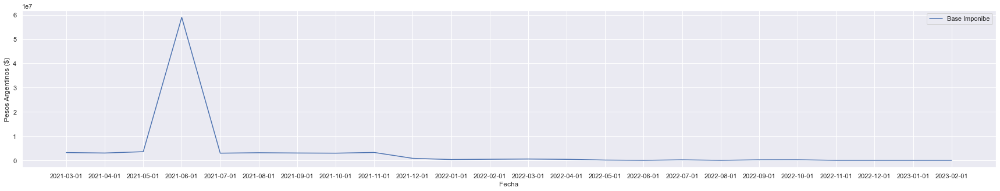

In [19]:
plt.figure(figsize = (30,5))
plt.plot(señal1.index, señal1.M_BASE_IMPONIBLE, label = 'Base Imponibe')
plt.xlabel('Fecha')
plt.ylabel('Pesos Argentinos ($)')
# plt.xlim(datetime.date(1990,1,1), datetime.date(2018,1,1))
# plt.ylim(-10,40)
plt.legend()
plt.show()

In [20]:
#primero pasamos nuestra fecha a numeros.
señal1['fecha_numeros']=señal1.index
señal1['fecha_numeros']=pd.to_datetime(señal1.fecha_numeros)
señal1['fecha_numeros']=señal1.fecha_numeros.map(datetime.datetime.toordinal)
señal1.head(15)

,M_BASE_IMPONIBLE,fecha_numeros
FEC_PERIODO_CUOTA,,
2021-03-01,3186255,737850
2021-04-01,2998184,737881
2021-05-01,3548616,737911
2021-06-01,58988726,737942
2021-07-01,2939550,737972
2021-08-01,3110478,738003
2021-09-01,3002555,738034
2021-10-01,2939931,738064
2021-11-01,3229253,738095


In [21]:
from sklearn.linear_model import LinearRegression
lr = LinearRegression()
lr.fit(señal1.fecha_numeros.values.reshape(-1, 1), señal1.M_BASE_IMPONIBLE)

LinearRegression()

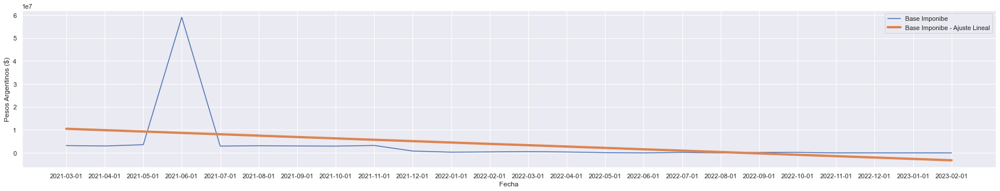

In [22]:
plt.figure(figsize = (30,5))
plt.plot(señal1.index, señal1.M_BASE_IMPONIBLE, label = 'Base Imponibe')
plt.plot(señal1.index, lr.predict(señal1.fecha_numeros.values.reshape(-1, 1)), lw = 4, label = 'Base Imponibe - Ajuste Lineal')
plt.xlabel('Fecha')
plt.ylabel('Pesos Argentinos ($)')
# plt.xlim(datetime.date(1990,1,1), datetime.date(2018,1,1))
# plt.ylim(-10,40)
plt.legend()
plt.show()

INFO:fbprophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:n_changepoints greater than number of observations. Using 18.


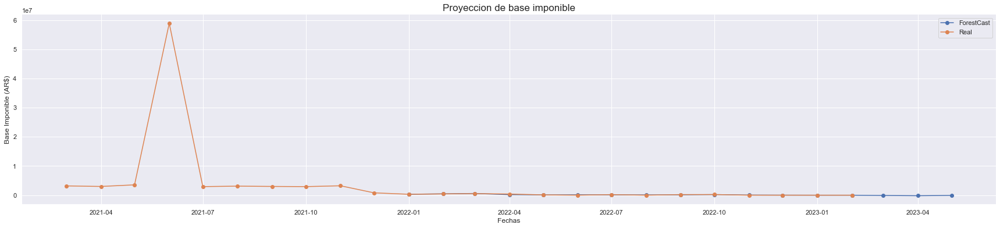

In [23]:
señal1['fecha']=señal1.index
señal1['fecha']=pd.to_datetime(señal1.fecha)
df_prophet = señal1.loc[(señal1.index >='2021-03-01') & (señal1.index <= '2023-02-01')]
df_prophet = df_prophet.rename(columns= {'fecha': 'ds' , 'M_BASE_IMPONIBLE': 'y' } )
modelo = Prophet(seasonality_mode='multiplicative')
modelo.add_seasonality('yearly',period=12, fourier_order=8)
modelo.fit(df_prophet)
future = modelo.make_future_dataframe(periods=12, freq='MS')
forecast = modelo.predict(future)
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']]
forescast_comparacion = forecast[['ds','yhat', 'yhat_lower', 'yhat_upper']]
forescast_comparacion = forescast_comparacion.loc[(forescast_comparacion['ds'] >= '2022-01-01') & (forescast_comparacion['ds'] <= '2023-05-01')]
plt.figure(figsize=(30,6))
plt.plot(forescast_comparacion['ds'], forescast_comparacion['yhat'], '-o', label ='ForestCast')
plt.plot(señal1.loc[(señal1['fecha'] >= '2021-01-01') & (señal1['fecha'] <= '2023-05-01')]['fecha'], señal1.loc[(señal1['fecha'] >= '2021-01-01') & (señal1['fecha'] <= '2023-05-01')]['M_BASE_IMPONIBLE'], '-o', label ='Real')
plt.title('Proyeccion de base imponible',fontsize = 17)
plt.xlabel('Fechas')
plt.ylabel('Base Imponible (AR$)')
plt.legend()
sns.despine(left=True, bottom=True) 

In [24]:
señal = data24['Estrato'] == 2
señal2 = data24[señal]

In [25]:
cuits2 = señal2['CUIT_CG'].drop_duplicates()
print (cuits2)

18       23-95293184-9
80       27-94014411-1
105      27-12308931-1
109      27-95780125-6
133      20-13532211-4
184      20-34010298-4
193      23-36747641-9
195      23-38885290-9
314      20-38338549-1
534      20-94031046-7
579      23-41639937-9
587      23-60426886-9
599      20-17371111-6
855      20-22865576-8
866      20-06430824-7
1151     30-71404116-5
1183     30-71633520-4
1204     20-21778856-1
1622     20-95407522-3
1637     27-94741187-5
1691     20-94011946-5
1697     20-21402455-2
1710     20-23293519-8
1981     20-95324892-2
2245     30-71715563-3
2259     27-96075330-0
2404     27-95771960-6
3984     30-71049251-0
5342     27-21898252-8
6085     27-96145744-6
11162    23-39694225-9
Name: CUIT_CG, dtype: object


In [26]:
señal2 = señal2.groupby('FEC_PERIODO_CUOTA')['M_BASE_IMPONIBLE'].sum().to_frame()
print (señal2)

                   M_BASE_IMPONIBLE
FEC_PERIODO_CUOTA                  
2021-03-01                 19050419
2021-04-01                 16761866
2021-05-01                 18288381
2021-06-01                 19201477
2021-07-01                 20560652
2021-08-01                 18267986
2021-09-01                 17465164
2021-10-01                 18624320
2021-11-01                 17250077
2021-12-01                 20979268
2022-01-01                 22376619
2022-02-01                 18317356
2022-03-01                 20785374
2022-04-01                 11250849
2022-05-01                  7710265
2022-06-01                  3781980
2022-07-01                  4098044
2022-08-01                  3192228
2022-09-01                  2429659
2022-10-01                  2931422
2022-11-01                  2690916
2022-12-01                  4625206
2023-01-01                  1732533
2023-02-01                  2100446


INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


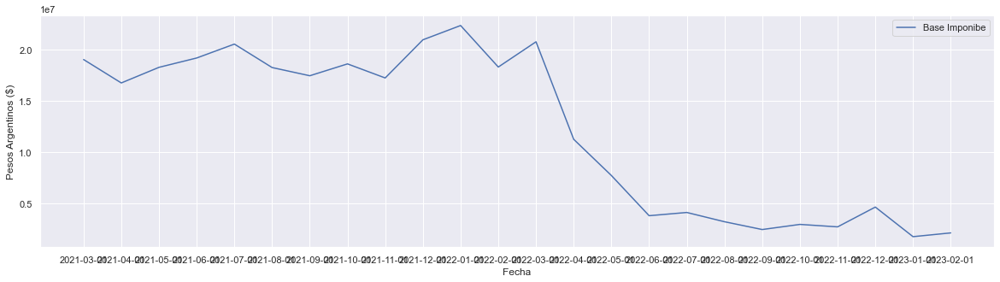

In [27]:
plt.figure(figsize = (20,5))
plt.plot(señal2.index, señal2.M_BASE_IMPONIBLE, label = 'Base Imponibe')
plt.xlabel('Fecha')
plt.ylabel('Pesos Argentinos ($)')
# plt.xlim(datetime.date(1990,1,1), datetime.date(2018,1,1))
# plt.ylim(-10,40)
plt.legend()
plt.show()

In [28]:
#primero pasamos nuestra fecha a numeros.
señal2['fecha_numeros']=señal2.index
señal2['fecha_numeros']=pd.to_datetime(señal2.fecha_numeros)
señal2['fecha_numeros']=señal2.fecha_numeros.map(datetime.datetime.toordinal)
señal2.head(15)

,M_BASE_IMPONIBLE,fecha_numeros
FEC_PERIODO_CUOTA,,
2021-03-01,19050419,737850
2021-04-01,16761866,737881
2021-05-01,18288381,737911
2021-06-01,19201477,737942
2021-07-01,20560652,737972
2021-08-01,18267986,738003
2021-09-01,17465164,738034
2021-10-01,18624320,738064
2021-11-01,17250077,738095


In [29]:
from sklearn.linear_model import LinearRegression
lr = LinearRegression()
lr.fit(señal2.fecha_numeros.values.reshape(-1, 1), señal2.M_BASE_IMPONIBLE)

LinearRegression()

INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


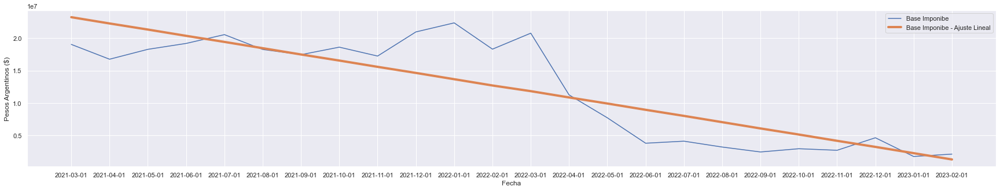

In [30]:
plt.figure(figsize = (30,5))
plt.plot(señal2.index, señal2.M_BASE_IMPONIBLE, label = 'Base Imponibe')
plt.plot(señal2.index, lr.predict(señal2.fecha_numeros.values.reshape(-1, 1)), lw = 4, label = 'Base Imponibe - Ajuste Lineal')
plt.xlabel('Fecha')
plt.ylabel('Pesos Argentinos ($)')
# plt.xlim(datetime.date(1990,1,1), datetime.date(2018,1,1))
# plt.ylim(-10,40)
plt.legend()
plt.show()

INFO:fbprophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:n_changepoints greater than number of observations. Using 18.


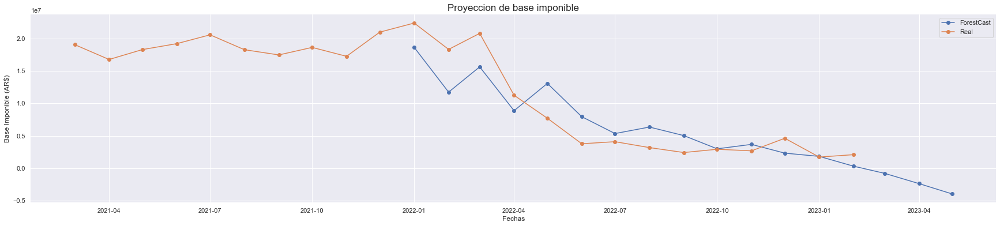

In [31]:
señal2['fecha']=señal2.index
señal2['fecha']=pd.to_datetime(señal2.fecha)
df_prophet = señal2.loc[(señal2.index >='2021-03-01') & (señal2.index <= '2023-02-01')]
df_prophet = df_prophet.rename(columns= {'fecha': 'ds' , 'M_BASE_IMPONIBLE': 'y' } )
modelo = Prophet(seasonality_mode='multiplicative')
modelo.add_seasonality('yearly',period=12, fourier_order=8)
modelo.fit(df_prophet)
future = modelo.make_future_dataframe(periods=12, freq='MS')
forecast = modelo.predict(future)
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']]
forescast_comparacion = forecast[['ds','yhat', 'yhat_lower', 'yhat_upper']]
forescast_comparacion = forescast_comparacion.loc[(forescast_comparacion['ds'] >= '2022-01-01') & (forescast_comparacion['ds'] <= '2023-05-01')]
plt.figure(figsize=(30,6))
plt.plot(forescast_comparacion['ds'], forescast_comparacion['yhat'], '-o', label ='ForestCast')
plt.plot(señal2.loc[(señal2['fecha'] >= '2021-01-01') & (señal2['fecha'] <= '2023-05-01')]['fecha'], señal2.loc[(señal2['fecha'] >= '2021-01-01') & (señal2['fecha'] <= '2023-05-01')]['M_BASE_IMPONIBLE'], '-o', label ='Real')
plt.title('Proyeccion de base imponible',fontsize = 17)
plt.xlabel('Fechas')
plt.ylabel('Base Imponible (AR$)')
plt.legend()
sns.despine(left=True, bottom=True) 

In [32]:
señal = data24['Estrato'] == 3
señal3 = data24[señal]

In [33]:
cuits3 = señal3['CUIT_CG'].drop_duplicates()
print (cuits3)

10      30-71701891-1
15      27-12807217-4
35      27-95647803-6
48      27-23462837-8
49      20-30831812-6
            ...      
4247    20-96077659-4
4257    20-96124340-9
5117    20-30315701-9
6079    23-96104113-9
6762    20-40505123-1
Name: CUIT_CG, Length: 82, dtype: object


In [34]:
señal3 = señal3.groupby('FEC_PERIODO_CUOTA')['M_BASE_IMPONIBLE'].sum().to_frame()
print (señal3['M_BASE_IMPONIBLE'])

FEC_PERIODO_CUOTA
2021-03-01    41446117
2021-04-01    42609096
2021-05-01    49752478
2021-06-01    41081789
2021-07-01    42449665
2021-08-01    44578048
2021-09-01    43781805
2021-10-01    48034666
2021-11-01    47834523
2021-12-01    63520706
2022-01-01    56530926
2022-02-01    49381755
2022-03-01    53131867
2022-04-01    56312337
2022-05-01    53415756
2022-06-01    55069392
2022-07-01    57499788
2022-08-01    49539468
2022-09-01    48842620
2022-10-01    55281923
2022-11-01    57497574
2022-12-01    74478939
2023-01-01    60839213
2023-02-01    58393822
Name: M_BASE_IMPONIBLE, dtype: int64


INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


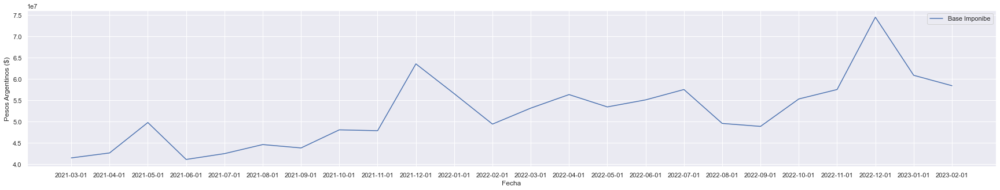

In [35]:
plt.figure(figsize = (30,5))
plt.plot(señal3.index, señal3.M_BASE_IMPONIBLE, label = 'Base Imponibe')
plt.xlabel('Fecha')
plt.ylabel('Pesos Argentinos ($)')
# plt.xlim(datetime.date(1990,1,1), datetime.date(2018,1,1))
# plt.ylim(-10,40)
plt.legend()
plt.show()

In [36]:
#primero pasamos nuestra fecha a numeros.
señal3['fecha_numeros']=señal3.index
señal3['fecha_numeros']=pd.to_datetime(señal3.fecha_numeros)
señal3['fecha_numeros']=señal3.fecha_numeros.map(datetime.datetime.toordinal)
señal3.head(30)

,M_BASE_IMPONIBLE,fecha_numeros
FEC_PERIODO_CUOTA,,
2021-03-01,41446117,737850
2021-04-01,42609096,737881
2021-05-01,49752478,737911
2021-06-01,41081789,737942
2021-07-01,42449665,737972
2021-08-01,44578048,738003
2021-09-01,43781805,738034
2021-10-01,48034666,738064
2021-11-01,47834523,738095


In [37]:
from sklearn.linear_model import LinearRegression
lr = LinearRegression()
lr.fit(señal3.fecha_numeros.values.reshape(-1, 1), señal3.M_BASE_IMPONIBLE)

LinearRegression()

INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


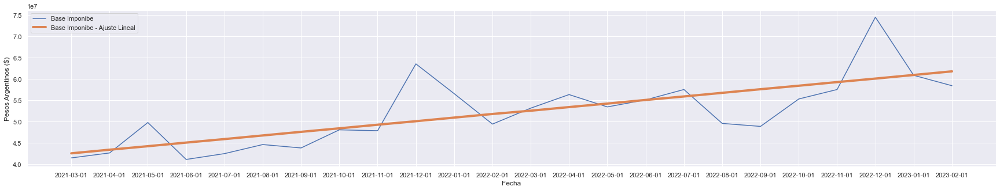

In [38]:
plt.figure(figsize = (30,5))
plt.plot(señal3.index, señal3.M_BASE_IMPONIBLE, label = 'Base Imponibe')
plt.plot(señal3.index, lr.predict(señal3.fecha_numeros.values.reshape(-1, 1)), lw = 4, label = 'Base Imponibe - Ajuste Lineal')
plt.xlabel('Fecha')
plt.ylabel('Pesos Argentinos ($)')
# plt.xlim(datetime.date(1990,1,1), datetime.date(2018,1,1))
# plt.ylim(-10,40)
plt.legend()
plt.show()

INFO:fbprophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:n_changepoints greater than number of observations. Using 18.


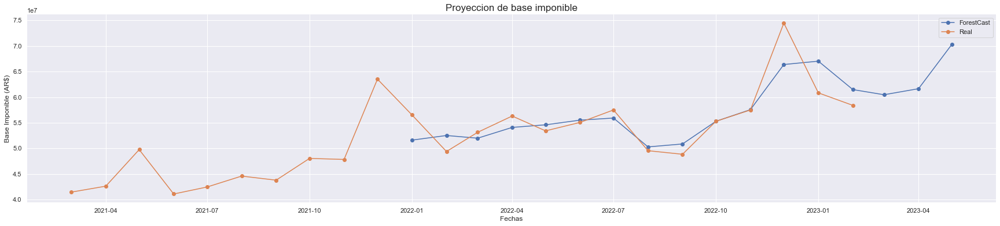

In [39]:
señal3['fecha']=señal3.index
señal3['fecha']=pd.to_datetime(señal3.fecha)
df_prophet = señal3.loc[(señal3.index >='2021-03-01') & (señal3.index <= '2023-02-01')]
df_prophet = df_prophet.rename(columns= {'fecha': 'ds' , 'M_BASE_IMPONIBLE': 'y' } )
modelo = Prophet(seasonality_mode='multiplicative')
modelo.add_seasonality('yearly',period=12, fourier_order=8)
modelo.fit(df_prophet)
future = modelo.make_future_dataframe(periods=12, freq='MS')
forecast = modelo.predict(future)
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']]
forescast_comparacion = forecast[['ds','yhat', 'yhat_lower', 'yhat_upper']]
forescast_comparacion = forescast_comparacion.loc[(forescast_comparacion['ds'] >= '2022-01-01') & (forescast_comparacion['ds'] <= '2023-05-01')]
plt.figure(figsize=(30,6))
plt.plot(forescast_comparacion['ds'], forescast_comparacion['yhat'], '-o', label ='ForestCast')
plt.plot(señal3.loc[(señal3['fecha'] >= '2021-01-01') & (señal3['fecha'] <= '2023-05-01')]['fecha'], señal3.loc[(señal3['fecha'] >= '2021-01-01') & (señal3['fecha'] <= '2023-05-01')]['M_BASE_IMPONIBLE'], '-o', label ='Real')
plt.title('Proyeccion de base imponible',fontsize = 17)
plt.xlabel('Fechas')
plt.ylabel('Base Imponible (AR$)')
plt.legend()
sns.despine(left=True, bottom=True) 

In [40]:
forescast_comparacion = forecast[['ds','yhat', 'yhat_lower', 'yhat_upper']]
forescast_comparacion = forescast_comparacion.loc[(forescast_comparacion['ds'] >= '2023-01-01') & (forescast_comparacion['ds'] <= '2023-05-01')]
forescast_comparacion.head()

,ds,yhat,yhat_lower,yhat_upper
22,2023-01-01,6.703197e+07,6.216051e+07,7.193698e+07
23,2023-02-01,6.147951e+07,5.634539e+07,6.639306e+07
24,2023-03-01,6.047258e+07,5.576373e+07,6.527393e+07
25,2023-04-01,6.165309e+07,5.672934e+07,6.623012e+07
26,2023-05-01,7.033606e+07,6.541711e+07,7.537182e+07


In [41]:
señal = data24['Estrato'] == 4
señal4 = data24[señal]

In [42]:
cuits4 = señal4['CUIT_CG'].drop_duplicates()
print (cuits4)

0        24-18864834-3
2        27-95242727-5
3        20-95716699-8
8        20-94033684-9
11       27-95748008-5
             ...      
4239     20-22507811-5
5347     20-26654193-8
6087     27-12382036-9
10569    30-71212278-8
10577    30-71783299-6
Name: CUIT_CG, Length: 216, dtype: object


In [43]:
print (señal4)

             CUIT_CG  M_BASE_IMPONIBLE FEC_PERIODO_CUOTA  BIinteranual  \
0      24-18864834-3           2982693        2021-03-01      42423758   
2      27-95242727-5           2361013        2021-05-01      41373039   
3      20-95716699-8           2214922        2021-04-01      56645599   
8      20-94033684-9                 0        2021-11-01      29448838   
11     27-95748008-5           1535725        2021-03-01      30206198   
...              ...               ...               ...           ...   
11144  30-71505263-2           1292992        2022-06-01      18679327   
11147  27-95245820-0           1892321        2022-06-01      37032543   
11148  30-56871982-0           3020680        2022-06-01      46178839   
11154  20-95964423-4           1698118        2022-11-01      22523811   
11158  27-94596607-1           4111215        2022-06-01      68337991   

       Estrato  
0            4  
2            4  
3            4  
8            4  
11           4  
...      

In [44]:
señal4 = señal4.groupby('FEC_PERIODO_CUOTA')['M_BASE_IMPONIBLE'].sum().to_frame()
print (señal4)

                   M_BASE_IMPONIBLE
FEC_PERIODO_CUOTA                  
2021-03-01                316513943
2021-04-01                294273234
2021-05-01                313815350
2021-06-01                339664103
2021-07-01                326652061
2021-08-01                314915758
2021-09-01                314095417
2021-10-01                333037906
2021-11-01                346929023
2021-12-01                450990292
2022-01-01                427092435
2022-02-01                409701066
2022-03-01                419923578
2022-04-01                421546126
2022-05-01                449367164
2022-06-01                458615767
2022-07-01                493637944
2022-08-01                489291313
2022-09-01                516843892
2022-10-01                553731840
2022-11-01                553281746
2022-12-01                758239627
2023-01-01                650575566
2023-02-01                573969312


INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


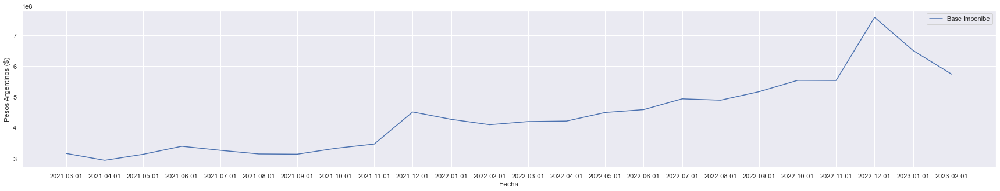

In [45]:
plt.figure(figsize = (30,5))
plt.plot(señal4.index, señal4.M_BASE_IMPONIBLE, label = 'Base Imponibe')
plt.xlabel('Fecha')
plt.ylabel('Pesos Argentinos ($)')
# plt.xlim(datetime.date(1990,1,1), datetime.date(2018,1,1))
# plt.ylim(-10,40)
plt.legend()
plt.show()

In [46]:
#primero pasamos nuestra fecha a numeros.
señal4['fecha_numeros']=señal4.index
señal4['fecha_numeros']=pd.to_datetime(señal4.fecha_numeros)
señal4['fecha_numeros']=señal4.fecha_numeros.map(datetime.datetime.toordinal)
señal4.head(30)

,M_BASE_IMPONIBLE,fecha_numeros
FEC_PERIODO_CUOTA,,
2021-03-01,316513943,737850
2021-04-01,294273234,737881
2021-05-01,313815350,737911
2021-06-01,339664103,737942
2021-07-01,326652061,737972
2021-08-01,314915758,738003
2021-09-01,314095417,738034
2021-10-01,333037906,738064
2021-11-01,346929023,738095


In [47]:
from sklearn.linear_model import LinearRegression
lr = LinearRegression()
lr.fit(señal4.fecha_numeros.values.reshape(-1, 1), señal4.M_BASE_IMPONIBLE)

LinearRegression()

INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


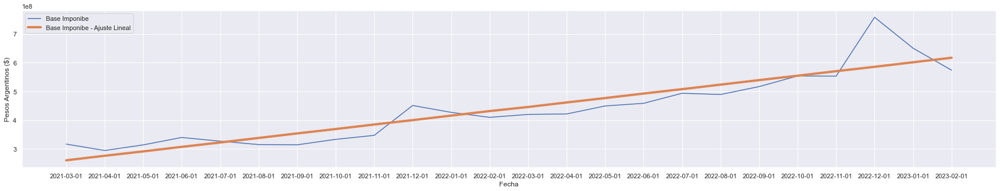

In [48]:
plt.figure(figsize = (30,5))
plt.plot(señal4.index, señal4.M_BASE_IMPONIBLE, label = 'Base Imponibe')
plt.plot(señal4.index, lr.predict(señal4.fecha_numeros.values.reshape(-1, 1)), lw = 4, label = 'Base Imponibe - Ajuste Lineal')
plt.xlabel('Fecha')
plt.ylabel('Pesos Argentinos ($)')
# plt.xlim(datetime.date(1990,1,1), datetime.date(2018,1,1))
# plt.ylim(-10,40)
plt.legend()
plt.show()

In [49]:
señal4['fecha']=señal4.index
señal4['fecha']=pd.to_datetime(señal4.fecha)

In [50]:
df_prophet = señal4.loc[(señal4.index >='2021-03-01') & (señal4.index <= '2023-02-01')]

INFO:fbprophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:n_changepoints greater than number of observations. Using 18.


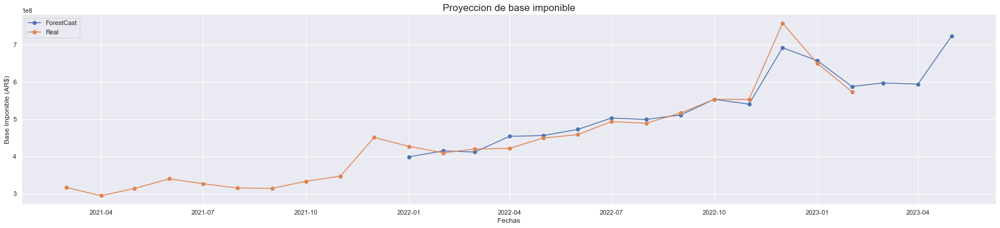

In [51]:
df_prophet = df_prophet.rename(columns= {'fecha': 'ds' , 'M_BASE_IMPONIBLE': 'y' } )
modelo = Prophet(seasonality_mode='multiplicative', interval_width = 0.95)
modelo.add_seasonality('yearly',period=12, fourier_order=8)
modelo.fit(df_prophet)
future = modelo.make_future_dataframe(periods=12, freq='MS')
forecast = modelo.predict(future)
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']]
forescast_comparacion = forecast[['ds','yhat', 'yhat_lower', 'yhat_upper']]
forescast_comparacion = forescast_comparacion.loc[(forescast_comparacion['ds'] >= '2022-01-01') & (forescast_comparacion['ds'] <= '2023-05-01')]
plt.figure(figsize=(30,6))
plt.plot(forescast_comparacion['ds'], forescast_comparacion['yhat'], '-o', label ='ForestCast')
plt.plot(señal4.loc[(señal4['fecha'] >= '2021-01-01') & (señal4['fecha'] <= '2023-05-01')]['fecha'], señal4.loc[(señal4['fecha'] >= '2021-01-01') & (señal4['fecha'] <= '2023-05-01')]['M_BASE_IMPONIBLE'], '-o', label ='Real')
plt.title('Proyeccion de base imponible',fontsize = 17)
plt.xlabel('Fechas')
plt.ylabel('Base Imponible (AR$)')
plt.legend()
sns.despine(left=True, bottom=True) 

In [52]:
future = modelo.make_future_dataframe(periods=12, freq='MS')
forecast = modelo.predict(future)
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']]
forecast.tail(12)

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yearly,yearly_lower,yearly_upper,additive_terms,additive_terms_lower,additive_terms_upper,yhat
24,2023-03-01,6.315115e+08,5.361842e+08,6.575229e+08,6.315089e+08,6.315140e+08,-0.053546,-0.053546,-0.053546,-0.053546,-0.053546,-0.053546,0.0,0.0,0.0,5.976964e+08
25,2023-04-01,6.470857e+08,5.353605e+08,6.630286e+08,6.470775e+08,6.470935e+08,-0.081224,-0.081224,-0.081224,-0.081224,-0.081224,-0.081224,0.0,0.0,0.0,5.945271e+08
26,2023-05-01,6.621575e+08,6.617650e+08,7.806304e+08,6.621429e+08,6.621728e+08,0.092722,0.092722,0.092722,0.092722,0.092722,0.092722,0.0,0.0,0.0,7.235539e+08
27,2023-06-01,6.777317e+08,5.847330e+08,7.079275e+08,6.777092e+08,6.777546e+08,-0.047549,-0.047549,-0.047549,-0.047549,-0.047549,-0.047549,0.0,0.0,0.0,6.455063e+08
28,2023-07-01,6.928035e+08,6.126270e+08,7.380198e+08,6.927712e+08,6.928378e+08,-0.020747,-0.020747,-0.020747,-0.020747,-0.020747,-0.020747,0.0,0.0,0.0,6.784303e+08
29,2023-08-01,7.083777e+08,6.358796e+08,7.557574e+08,7.083352e+08,7.084221e+08,-0.012462,-0.012462,-0.012462,-0.012462,-0.012462,-0.012462,0.0,0.0,0.0,6.995500e+08
30,2023-09-01,7.239519e+08,6.241070e+08,7.540527e+08,7.238981e+08,7.240064e+08,-0.048715,-0.048715,-0.048715,-0.048715,-0.048715,-0.048715,0.0,0.0,0.0,6.886846e+08
31,2023-10-01,7.390237e+08,7.484700e+08,8.676194e+08,7.389602e+08,7.390889e+08,0.091755,0.091755,0.091755,0.091755,0.091755,0.091755,0.0,0.0,0.0,8.068326e+08
32,2023-11-01,7.545979e+08,6.922032e+08,8.118594e+08,7.545255e+08,7.546756e+08,-0.003534,-0.003534,-0.003534,-0.003534,-0.003534,-0.003534,0.0,0.0,0.0,7.519312e+08
33,2023-12-01,7.696697e+08,6.649054e+08,7.837408e+08,7.695839e+08,7.697598e+08,-0.053792,-0.053792,-0.053792,-0.053792,-0.053792,-0.053792,0.0,0.0,0.0,7.282677e+08


In [53]:
forescast_comparacion = forecast[['ds','yhat', 'yhat_lower', 'yhat_upper']]
forescast_comparacion = forescast_comparacion.loc[(forescast_comparacion['ds'] >= '2023-01-01') & (forescast_comparacion['ds'] <= '2023-05-01')]
forescast_comparacion.head()

,ds,yhat,yhat_lower,yhat_upper
22,2023-01-01,6.576768e+08,5.920513e+08,7.196422e+08
23,2023-02-01,5.880857e+08,5.265567e+08,6.525061e+08
24,2023-03-01,5.976964e+08,5.361842e+08,6.575229e+08
25,2023-04-01,5.945271e+08,5.353605e+08,6.630286e+08
26,2023-05-01,7.235539e+08,6.617650e+08,7.806304e+08


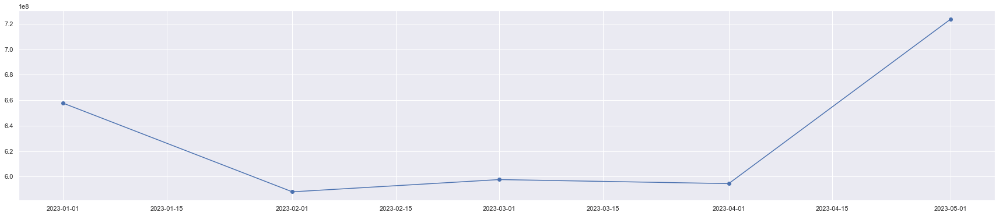

In [54]:
plt.figure(figsize=(30,6))
plt.plot(forescast_comparacion['ds'], forescast_comparacion['yhat'], '-o', label ='ForestCast')

In [55]:
señal = data24['Estrato'] == 5
señal5 = data24[señal]

In [56]:
cuits5 = señal5['CUIT_CG'].drop_duplicates()
print (cuits5)

4       30-71630470-8
6       20-21419161-0
24      20-06654923-3
37      27-95492715-1
50      30-71087790-0
82      30-60982296-8
83      30-71682061-7
85      20-05534649-7
93      27-17908479-7
98      33-71221173-9
111     27-95041929-1
112     20-17393217-1
132     20-12899407-7
173     23-94958621-9
174     20-28583601-9
182     27-04412501-9
192     30-71010220-8
199     20-21830302-2
242     20-94007399-6
243     30-71142736-4
255     30-71187322-4
261     27-29332962-7
272     30-71462353-9
282     30-71735211-0
283     27-20581105-8
316     20-18017761-3
543     30-71671165-6
548     20-23537338-7
558     27-06684136-2
568     30-71243932-3
590     30-71719649-6
626     27-26528978-4
631     27-94028888-1
837     20-95074537-2
846     27-28198141-8
893     33-71580183-9
1174    27-95485824-9
1187    30-71740638-5
1207    30-71756761-3
1237    30-70943338-1
1641    20-16432107-0
1680    27-94811261-8
1711    30-71761708-4
1712    20-95884585-6
2243    33-71633402-9
3991    27

In [57]:
señal5 = señal5.groupby('FEC_PERIODO_CUOTA')['M_BASE_IMPONIBLE'].sum().to_frame()
print (señal5)

                   M_BASE_IMPONIBLE
FEC_PERIODO_CUOTA                  
2021-03-01                133653428
2021-04-01                125903408
2021-05-01                126902115
2021-06-01                135156564
2021-07-01                144629752
2021-08-01                149671108
2021-09-01                164780101
2021-10-01                167715120
2021-11-01                169289268
2021-12-01                242322690
2022-01-01                237378429
2022-02-01                223010980
2022-03-01                208165799
2022-04-01                220529569
2022-05-01                222195117
2022-06-01                207077960
2022-07-01                270460762
2022-08-01                298760634
2022-09-01                330974209
2022-10-01                364231987
2022-11-01                342522626
2022-12-01                468006926
2023-01-01                509961374
2023-02-01                446393265


INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


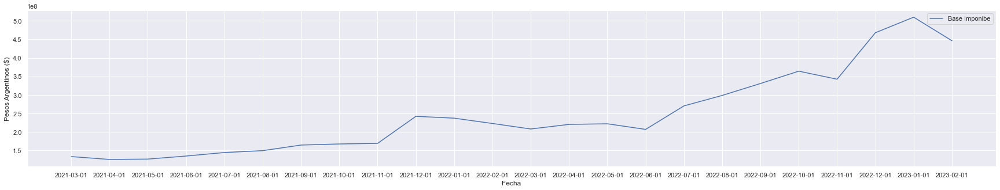

In [58]:
plt.figure(figsize = (30,5))
plt.plot(señal5.index, señal5.M_BASE_IMPONIBLE, label = 'Base Imponibe')
plt.xlabel('Fecha')
plt.ylabel('Pesos Argentinos ($)')
# plt.xlim(datetime.date(1990,1,1), datetime.date(2018,1,1))
# plt.ylim(-10,40)
plt.legend()
plt.show()

In [59]:
#primero pasamos nuestra fecha a numeros.
señal5['fecha_numeros']=señal5.index
señal5['fecha_numeros']=pd.to_datetime(señal5.fecha_numeros)
señal5['fecha_numeros']=señal5.fecha_numeros.map(datetime.datetime.toordinal)
señal5.head(15)

,M_BASE_IMPONIBLE,fecha_numeros
FEC_PERIODO_CUOTA,,
2021-03-01,133653428,737850
2021-04-01,125903408,737881
2021-05-01,126902115,737911
2021-06-01,135156564,737942
2021-07-01,144629752,737972
2021-08-01,149671108,738003
2021-09-01,164780101,738034
2021-10-01,167715120,738064
2021-11-01,169289268,738095


In [60]:
from sklearn.linear_model import LinearRegression
lr = LinearRegression()
lr.fit(señal5.fecha_numeros.values.reshape(-1, 1), señal5.M_BASE_IMPONIBLE)

LinearRegression()

INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


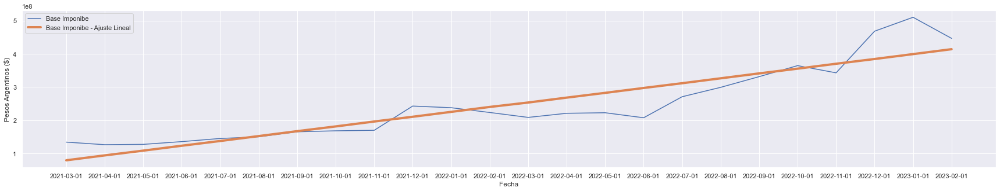

In [61]:
plt.figure(figsize = (30,5))
plt.plot(señal5.index, señal5.M_BASE_IMPONIBLE, label = 'Base Imponibe')
plt.plot(señal5.index, lr.predict(señal5.fecha_numeros.values.reshape(-1, 1)), lw = 4, label = 'Base Imponibe - Ajuste Lineal')
plt.xlabel('Fecha')
plt.ylabel('Pesos Argentinos ($)')
# plt.xlim(datetime.date(1990,1,1), datetime.date(2018,1,1))
# plt.ylim(-10,40)
plt.legend()
plt.show()

INFO:fbprophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:n_changepoints greater than number of observations. Using 18.


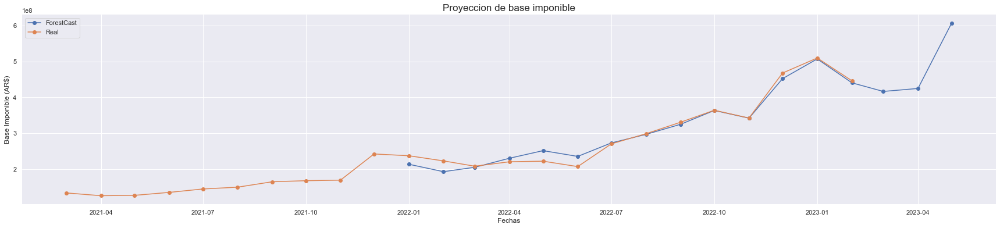

In [62]:
señal5['fecha']=señal5.index
señal5['fecha']=pd.to_datetime(señal5.fecha)
df_prophet = señal5.loc[(señal5.index >='2021-03-01') & (señal5.index <= '2023-02-01')]
df_prophet = df_prophet.rename(columns= {'fecha': 'ds' , 'M_BASE_IMPONIBLE': 'y' } )
modelo = Prophet(seasonality_mode='multiplicative')
modelo.add_seasonality('yearly',period=12, fourier_order=8)
modelo.fit(df_prophet)
future = modelo.make_future_dataframe(periods=12, freq='MS')
forecast = modelo.predict(future)
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']]
forescast_comparacion = forecast[['ds','yhat', 'yhat_lower', 'yhat_upper']]
forescast_comparacion = forescast_comparacion.loc[(forescast_comparacion['ds'] >= '2022-01-01') & (forescast_comparacion['ds'] <= '2023-05-01')]
plt.figure(figsize=(30,6))
plt.plot(forescast_comparacion['ds'], forescast_comparacion['yhat'], '-o', label ='ForestCast')
plt.plot(señal5.loc[(señal5['fecha'] >= '2021-01-01') & (señal5['fecha'] <= '2023-05-01')]['fecha'], señal5.loc[(señal5['fecha'] >= '2021-01-01') & (señal5['fecha'] <= '2023-05-01')]['M_BASE_IMPONIBLE'], '-o', label ='Real')
plt.title('Proyeccion de base imponible',fontsize = 17)
plt.xlabel('Fechas')
plt.ylabel('Base Imponible (AR$)')
plt.legend()
sns.despine(left=True, bottom=True) 

In [63]:
forescast_comparacion = forecast[['ds','yhat', 'yhat_lower', 'yhat_upper']]
forescast_comparacion = forescast_comparacion.loc[(forescast_comparacion['ds'] >= '2023-01-01') & (forescast_comparacion['ds'] <= '2023-05-01')]
forescast_comparacion.head()

,ds,yhat,yhat_lower,yhat_upper
22,2023-01-01,5.073680e+08,4.879957e+08,5.258446e+08
23,2023-02-01,4.406948e+08,4.221561e+08,4.604911e+08
24,2023-03-01,4.166911e+08,3.986160e+08,4.367099e+08
25,2023-04-01,4.249742e+08,4.056846e+08,4.459389e+08
26,2023-05-01,6.068603e+08,5.873456e+08,6.275966e+08


In [64]:
señal = data24['Estrato'] == 6
señal6 = data24[señal]

In [65]:
cuits6 = señal6['CUIT_CG'].drop_duplicates()
print (cuits6)

12      30-69850994-1
13      30-71446456-2
19      30-61649178-0
20      30-71001529-1
31      20-06554613-3
            ...      
1702    20-13963032-8
1715    30-71669105-1
1982    30-71243851-3
2004    33-71133398-9
3982    30-71463398-4
Name: CUIT_CG, Length: 74, dtype: object


In [66]:
señal6 = señal6.groupby('FEC_PERIODO_CUOTA')['M_BASE_IMPONIBLE'].sum().to_frame()
print (señal6)

                   M_BASE_IMPONIBLE
FEC_PERIODO_CUOTA                  
2021-03-01               2273970115
2021-04-01               2527365117
2021-05-01               2993086572
2021-06-01               2389329001
2021-07-01               2503441093
2021-08-01               2573902563
2021-09-01               3636523849
2021-10-01               3869593122
2021-11-01               2853313671
2021-12-01               3208239528
2022-01-01               2898441162
2022-02-01               4025373819
2022-03-01               3141465946
2022-04-01               3311892086
2022-05-01               4685415420
2022-06-01               3359012119
2022-07-01               3769063604
2022-08-01               5599836159
2022-09-01               5952230422
2022-10-01               6656282856
2022-11-01               4654812608
2022-12-01               5979662836
2023-01-01               5463557002
2023-02-01               5202553140


INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


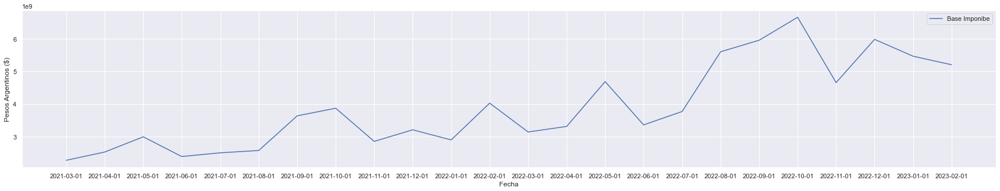

In [67]:
plt.figure(figsize = (30,5))
plt.plot(señal6.index, señal6.M_BASE_IMPONIBLE, label = 'Base Imponibe')
plt.xlabel('Fecha')
plt.ylabel('Pesos Argentinos ($)')
# plt.xlim(datetime.date(1990,1,1), datetime.date(2018,1,1))
# plt.ylim(-10,40)
plt.legend()
plt.show()

In [68]:
#primero pasamos nuestra fecha a numeros.
señal6['fecha_numeros']=señal6.index
señal6['fecha_numeros']=pd.to_datetime(señal6.fecha_numeros)
señal6['fecha_numeros']=señal6.fecha_numeros.map(datetime.datetime.toordinal)
señal6.head(30)

,M_BASE_IMPONIBLE,fecha_numeros
FEC_PERIODO_CUOTA,,
2021-03-01,2273970115,737850
2021-04-01,2527365117,737881
2021-05-01,2993086572,737911
2021-06-01,2389329001,737942
2021-07-01,2503441093,737972
2021-08-01,2573902563,738003
2021-09-01,3636523849,738034
2021-10-01,3869593122,738064
2021-11-01,2853313671,738095


In [69]:
from sklearn.linear_model import LinearRegression
lr = LinearRegression()
lr.fit(señal6.fecha_numeros.values.reshape(-1, 1), señal6.M_BASE_IMPONIBLE)

LinearRegression()

INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
INFO:matplotlib.category:Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


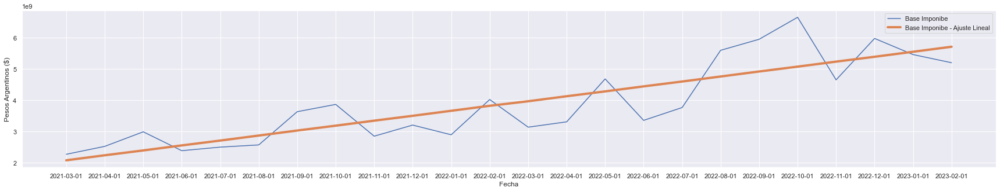

In [70]:
plt.figure(figsize = (30,5))
plt.plot(señal6.index, señal6.M_BASE_IMPONIBLE, label = 'Base Imponibe')
plt.plot(señal6.index, lr.predict(señal6.fecha_numeros.values.reshape(-1, 1)), lw = 4, label = 'Base Imponibe - Ajuste Lineal')
plt.xlabel('Fecha')
plt.ylabel('Pesos Argentinos ($)')
# plt.xlim(datetime.date(1990,1,1), datetime.date(2018,1,1))
# plt.ylim(-10,40)
plt.legend()
plt.show()

### Vamos a utilizar la Prophet para predecir el siguiente valor en la serie de tiempo mensual de base imponible.

INFO:fbprophet:Found custom seasonality named 'yearly', disabling built-in 'yearly' seasonality.
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:n_changepoints greater than number of observations. Using 18.


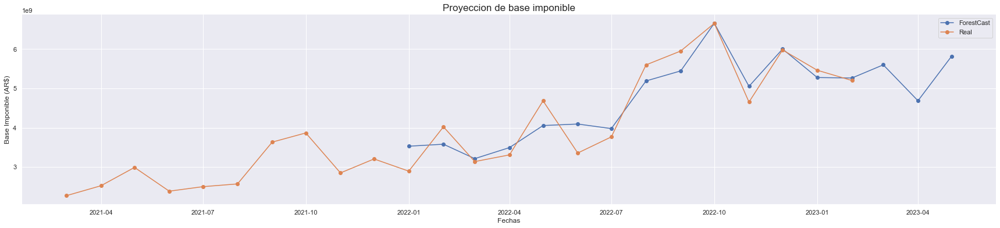

In [71]:
señal6['fecha']=señal6.index
señal6['fecha']=pd.to_datetime(señal6.fecha)
df_prophet = señal6.loc[(señal6.index >='2021-03-01') & (señal6.index <= '2023-02-01')]
df_prophet = df_prophet.rename(columns= {'fecha': 'ds' , 'M_BASE_IMPONIBLE': 'y' } )
modelo = Prophet(seasonality_mode='multiplicative')
modelo.add_seasonality('yearly',period=12, fourier_order=8)
modelo.fit(df_prophet)
future = modelo.make_future_dataframe(periods=12, freq='MS')
forecast = modelo.predict(future)
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']]
forescast_comparacion = forecast[['ds','yhat', 'yhat_lower', 'yhat_upper']]
forescast_comparacion = forescast_comparacion.loc[(forescast_comparacion['ds'] >= '2022-01-01') & (forescast_comparacion['ds'] <= '2023-05-01')]
plt.figure(figsize=(30,6))
plt.plot(forescast_comparacion['ds'], forescast_comparacion['yhat'], '-o', label ='ForestCast')
plt.plot(señal6.loc[(señal6['fecha'] >= '2021-01-01') & (señal6['fecha'] <= '2023-05-01')]['fecha'], señal6.loc[(señal6['fecha'] >= '2021-01-01') & (señal6['fecha'] <= '2023-05-01')]['M_BASE_IMPONIBLE'], '-o', label ='Real')
plt.title('Proyeccion de base imponible',fontsize = 17)
plt.xlabel('Fechas')
plt.ylabel('Base Imponible (AR$)')
plt.legend()
sns.despine(left=True, bottom=True) 

In [72]:
forescast_comparacion = forecast[['ds','yhat', 'yhat_lower', 'yhat_upper']]
forescast_comparacion = forescast_comparacion.loc[(forescast_comparacion['ds'] >= '2023-01-01') & (forescast_comparacion['ds'] <= '2023-05-01')]
forescast_comparacion.head()

,ds,yhat,yhat_lower,yhat_upper
22,2023-01-01,5.278355e+09,4.714072e+09,5.820541e+09
23,2023-02-01,5.266431e+09,4.677123e+09,5.798066e+09
24,2023-03-01,5.600913e+09,5.033014e+09,6.135393e+09
25,2023-04-01,4.688007e+09,4.127658e+09,5.221653e+09
26,2023-05-01,5.818955e+09,5.261576e+09,6.383154e+09


In [80]:
dataultimomes= pd.read_csv('Base-Imponible471120-Marzo.txt')
dataultimomes.head(30)

,CUIT_CG,M_BASE_IMPONIBLE,FEC_PERIODO_CUOTA
0,30-71404302-8,0,2023-03-01
1,27-94206786-6,3437715,2023-03-01
2,20-13963032-8,69909434,2023-03-01
3,20-08000621-8,760866850,2023-03-01
4,30-71643710-4,48397567,2023-03-01
5,30-71490214-4,0,2023-03-01
6,20-16498055-4,2571096,2023-03-01
7,27-95290387-5,1519406,2023-03-01
8,30-58633858-3,2103024,2023-03-01
9,20-35860968-7,1134557,2023-03-01


In [81]:
dataFebrero= data24['FEC_PERIODO_CUOTA']== '2023-02-01'

In [82]:
dataFebrero = data24[dataFebrero]

In [83]:
print(dataFebrero)

             CUIT_CG  M_BASE_IMPONIBLE FEC_PERIODO_CUOTA  BIinteranual  \
161    27-14475519-2           2335052        2023-02-01      40528057   
162    30-71077336-6          26758671        2023-02-01     259656955   
204    20-95451042-6           2617129        2023-02-01      28812848   
209    27-17908479-7          20049065        2023-02-01     135938828   
426    30-71407607-4           5552939        2023-02-01      56380797   
...              ...               ...               ...           ...   
10673  30-71573569-1           3728934        2023-02-01      22975268   
10838  20-95159402-5           2578499        2023-02-01      20925262   
10996  20-96117159-9           3105355        2023-02-01      31245455   
11047  20-95750667-5           4007696        2023-02-01      27471706   
11162  23-39694225-9           1007797        2023-02-01       1092367   

       Estrato  
161          4  
162          6  
204          4  
209          5  
426          4  
...      

In [84]:
df_inner = pd.merge(dataFebrero, dataultimomes, on=['CUIT_CG'], how='inner')

In [85]:
print(df_inner)

In [87]:
df_inner.to_csv('archivo.csv', index=False)

In [133]:
cuits = dataFebrero['CUIT_CG'].drop_duplicates() ## Almacenamos los distintos cuits en forma de serie, para poder luego convertirlos en lista, y poder iterar sobre la misma de manera mas simple

In [138]:
print(cuits)

161      27-14475519-2
162      30-71077336-6
204      20-95451042-6
209      27-17908479-7
426      30-71407607-4
             ...      
10673    30-71573569-1
10838    20-95159402-5
10996    20-96117159-9
11047    20-95750667-5
11162    23-39694225-9
Name: CUIT_CG, Length: 372, dtype: object


In [151]:
for i in cuits.tolist(): 
    cuit =i
    filtro = dataFebrero['CUIT_CG'] == cuit
    filtro2 = dataultimomes['CUIT_CG'] == cuit
    BI = int(dataultimomes[filtro2]['M_BASE_IMPONIBLE'])
    dataFebrero [filtro]['BIMarzo'] = BI
    print( dataFebrero [filtro]['BIMarzo'])

161    0
Name: BIMarzo, dtype: int64
162    0
Name: BIMarzo, dtype: int64
204    0
Name: BIMarzo, dtype: int64
209    0
Name: BIMarzo, dtype: int64
426    0
Name: BIMarzo, dtype: int64
427    0
Name: BIMarzo, dtype: int64
460    0
Name: BIMarzo, dtype: int64
547    0
Name: BIMarzo, dtype: int64
611    0
Name: BIMarzo, dtype: int64
618    0
Name: BIMarzo, dtype: int64
773    0
Name: BIMarzo, dtype: int64
818    0
Name: BIMarzo, dtype: int64
819    0
Name: BIMarzo, dtype: int64
820    0
Name: BIMarzo, dtype: int64
821    0
Name: BIMarzo, dtype: int64
874     0
1865    0
Name: BIMarzo, dtype: int64
1147    0
Name: BIMarzo, dtype: int64
1241    0
Name: BIMarzo, dtype: int64
1401    0
Name: BIMarzo, dtype: int64
1402    0
Name: BIMarzo, dtype: int64
1403    0
Name: BIMarzo, dtype: int64
1404    0
Name: BIMarzo, dtype: int64
1458    0
Name: BIMarzo, dtype: int64
1461    0
Name: BIMarzo, dtype: int64
1462    0
Name: BIMarzo, dtype: int64
1463    0
Name: BIMarzo, dtype: int64
1464    0
Name: B

<ipython-input-151-41b256353fca>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataFebrero [filtro]['BIMarzo'] = BI


TypeError: cannot convert the series to <class 'int'>

In [141]:
dataFebrero.head(30)

,CUIT_CG,M_BASE_IMPONIBLE,FEC_PERIODO_CUOTA,BIinteranual,Estrato,BIMarzo
161,27-14475519-2,2335052,2023-02-01,40528057,4,0
162,30-71077336-6,26758671,2023-02-01,259656955,6,0
204,20-95451042-6,2617129,2023-02-01,28812848,4,0
209,27-17908479-7,20049065,2023-02-01,135938828,5,0
426,30-71407607-4,5552939,2023-02-01,56380797,4,0
427,20-35860968-7,1008908,2023-02-01,9536013,3,0
460,30-71688308-2,2643607,2023-02-01,36525513,4,0
547,20-27572012-8,5874895,2023-02-01,78376358,4,0
611,27-94241283-0,1450558,2023-02-01,14162293,3,0
618,30-71657601-5,1692965,2023-02-01,22577902,4,0


# A continuacion graficos cada uno de los contribuyentes que declara la actividad especificada :

24-18864834-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


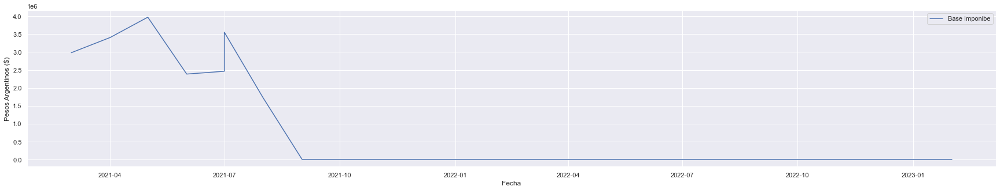

27-95558081-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


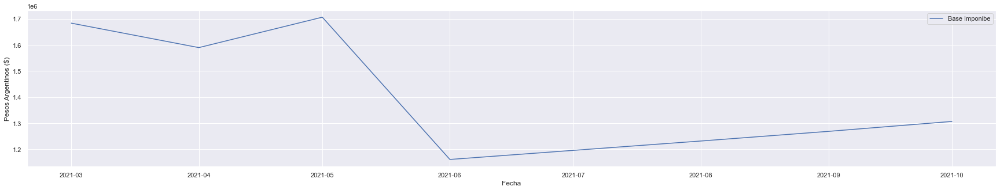

27-95242727-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


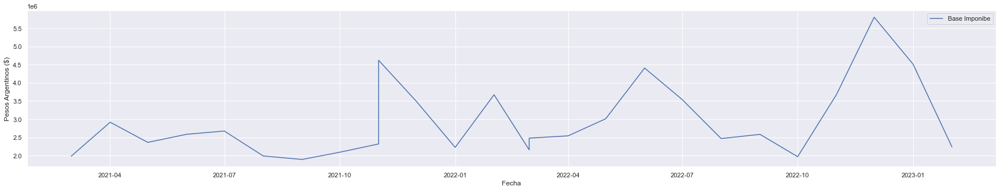

20-95716699-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


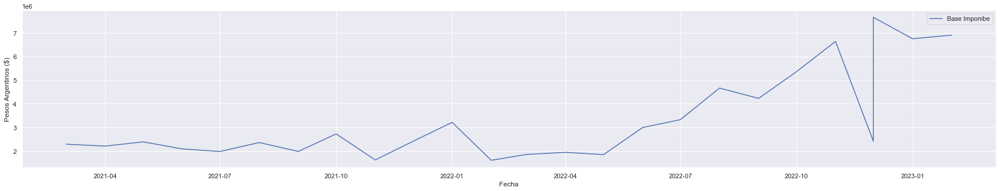

30-71630470-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


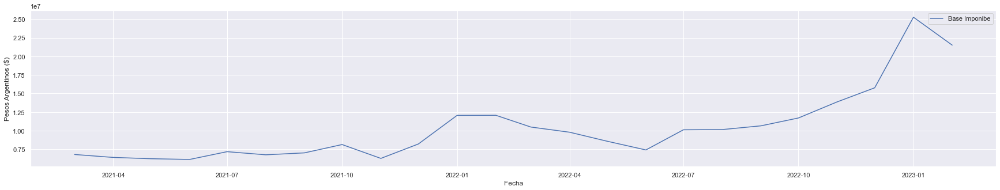

27-95065108-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


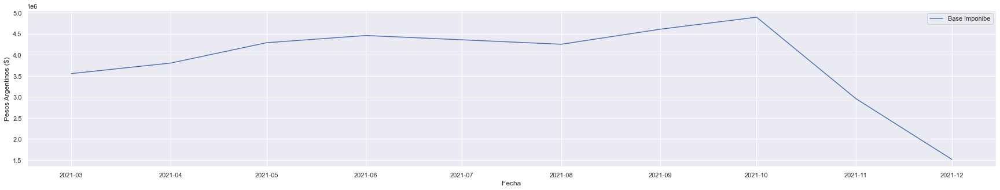

20-21419161-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


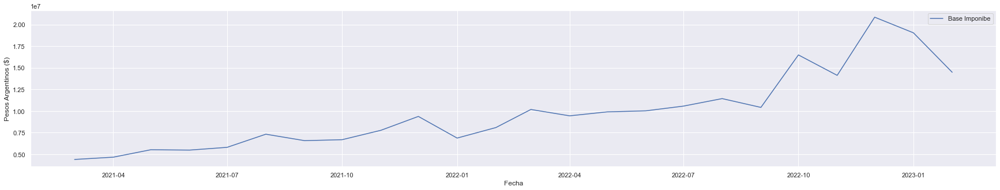

20-94033684-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


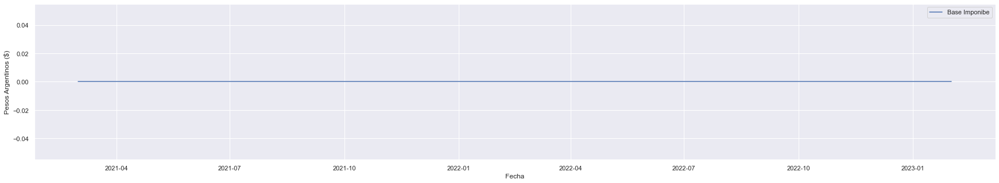

30-54295740-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


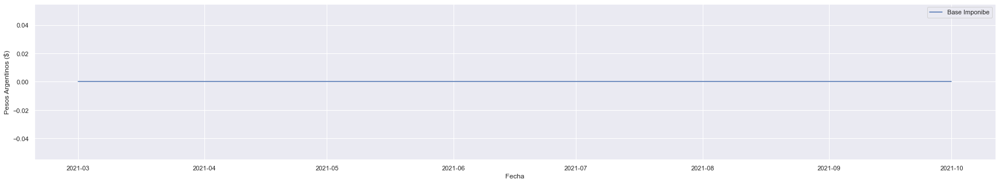

30-71701891-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


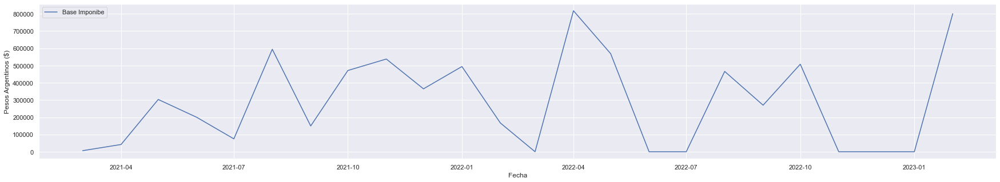

27-95748008-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


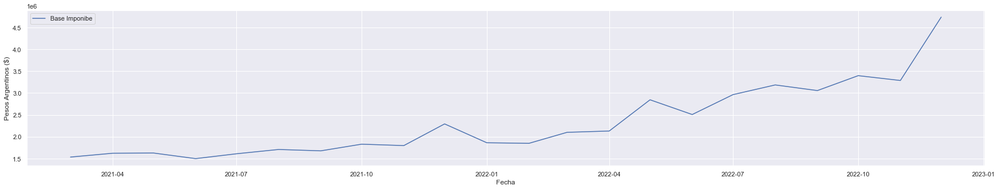

30-69850994-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


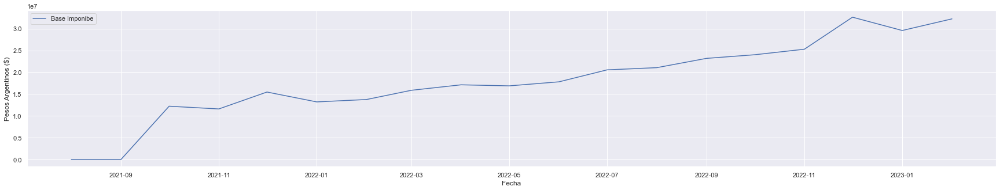

30-71446456-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


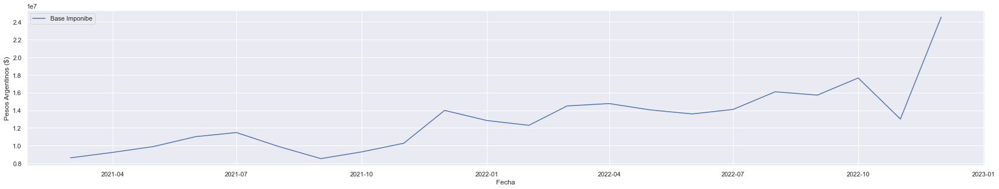

20-14220754-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


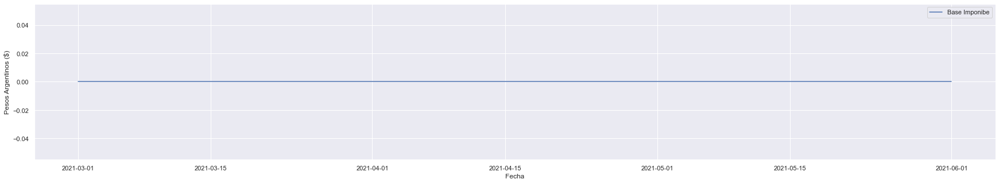

27-12807217-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


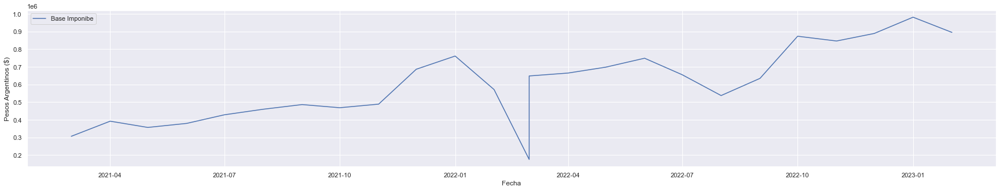

20-20077080-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


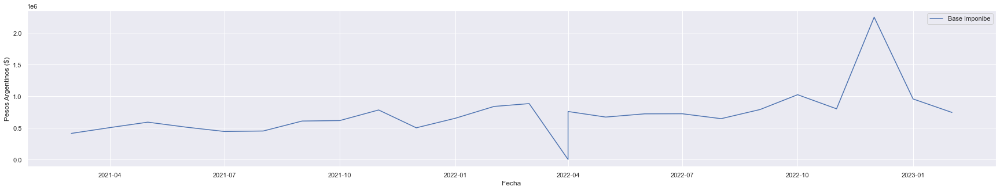

30-71681527-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


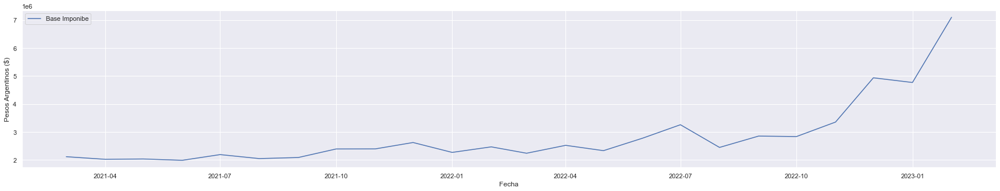

23-95293184-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


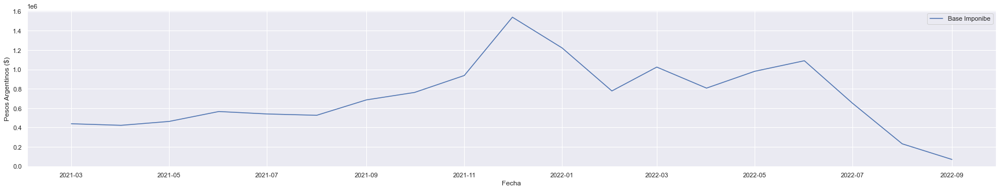

30-61649178-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


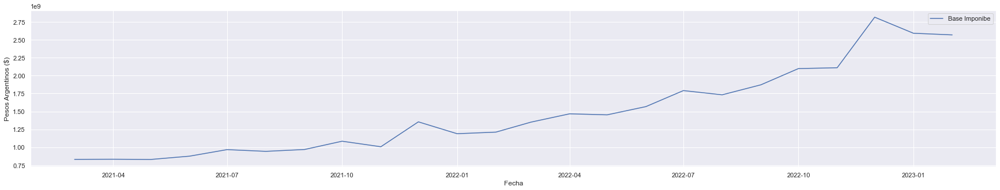

30-71001529-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


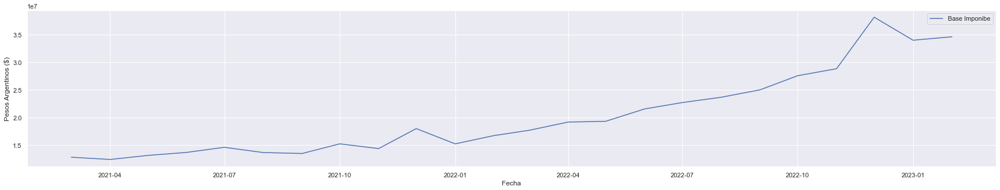

20-95692997-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


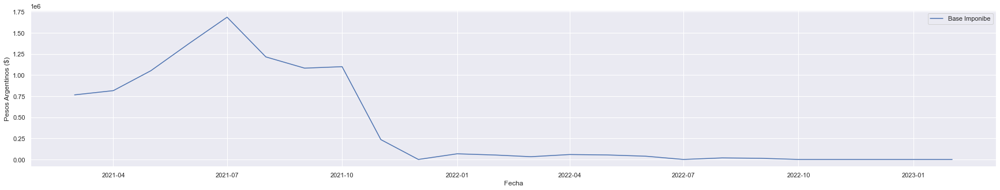

23-94025829-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


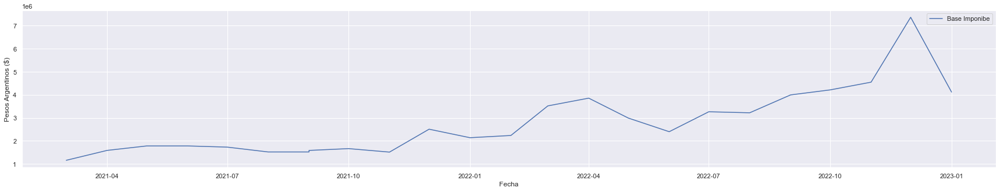

30-71112971-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


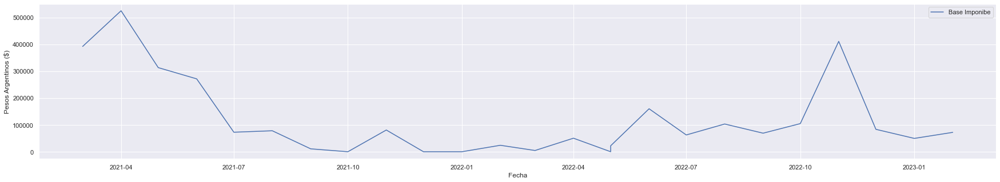

<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


20-06654923-3


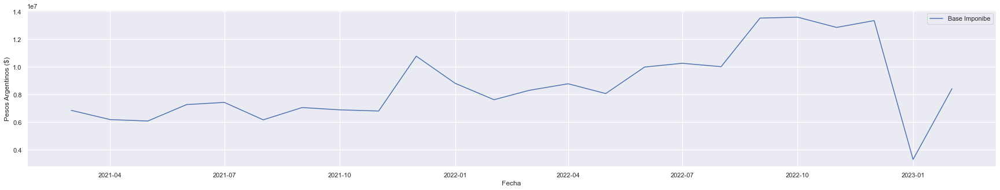

20-14257534-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


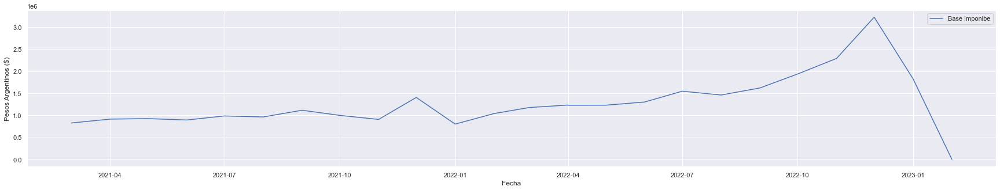

20-34372947-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


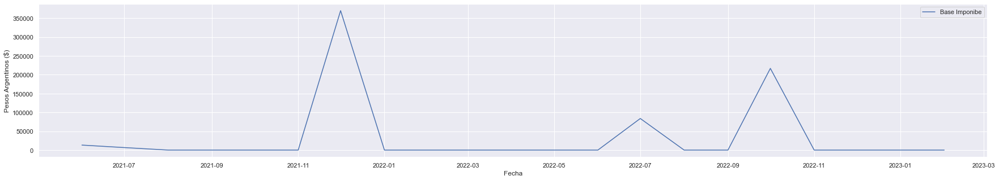

20-06554613-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


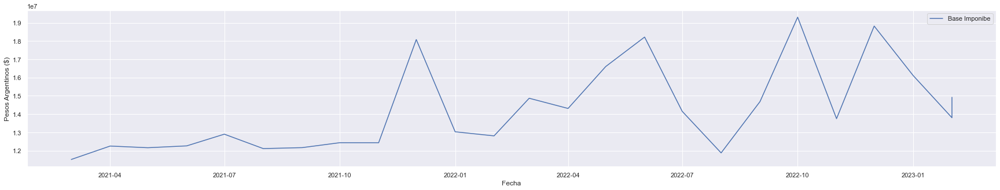

20-94011942-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


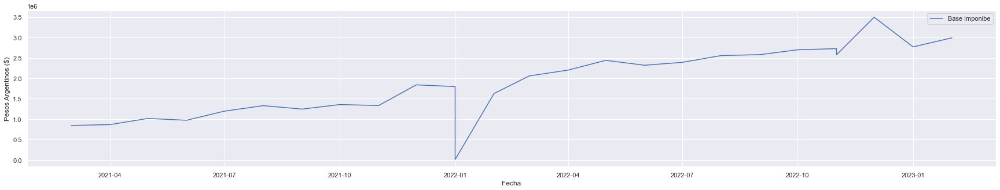

20-95627708-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


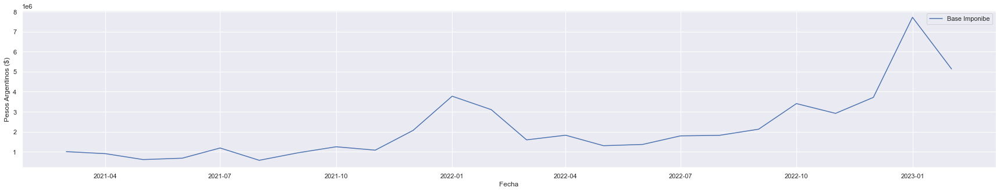

27-95647803-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


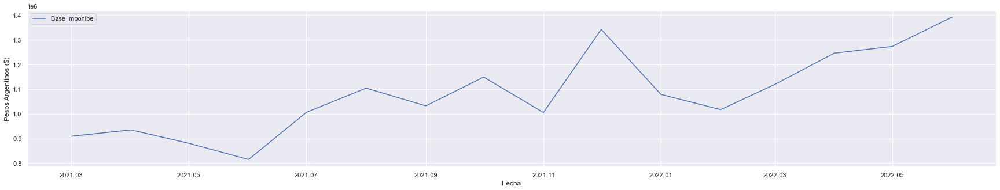

27-95492715-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


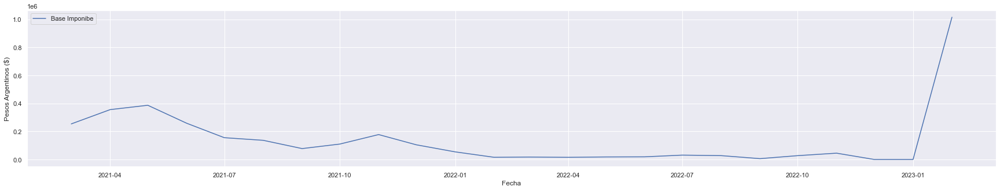

20-94026504-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


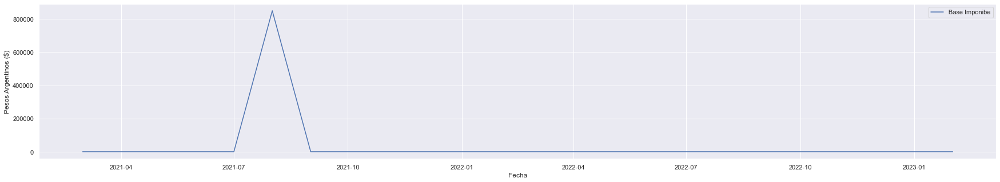

30-71407607-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


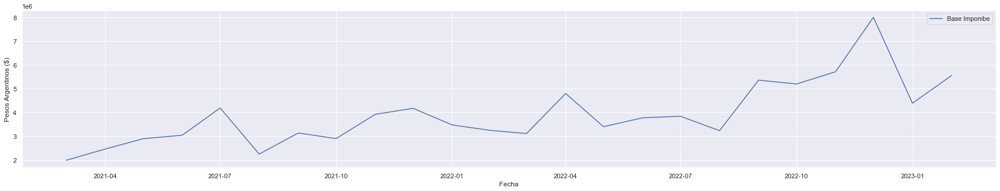

30-63661860-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


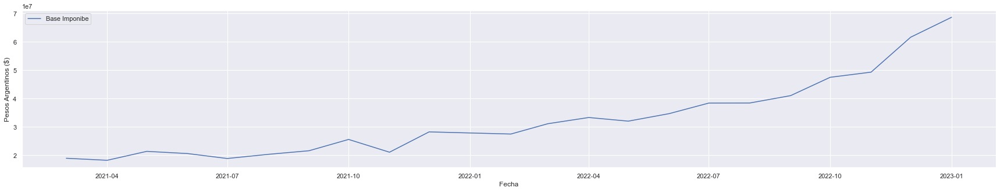

30-70969876-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


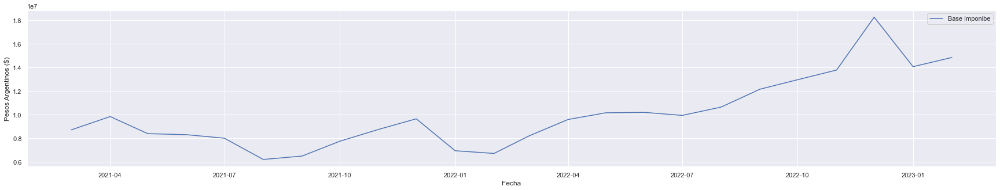

20-94011234-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


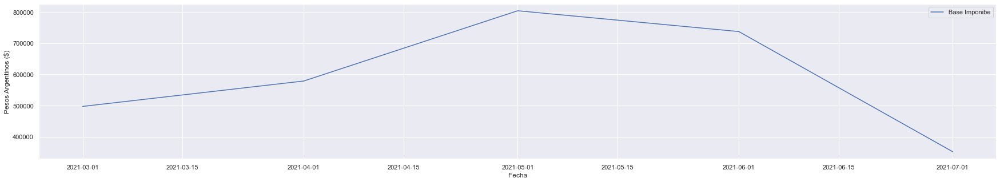

23-94914016-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


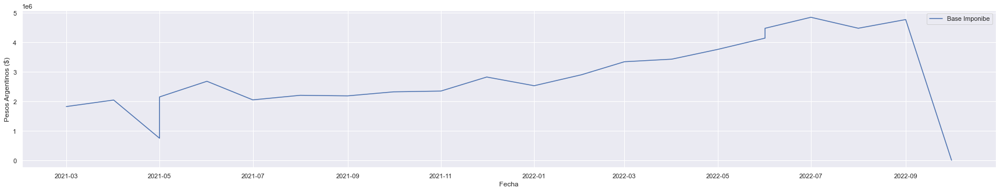

20-94013825-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


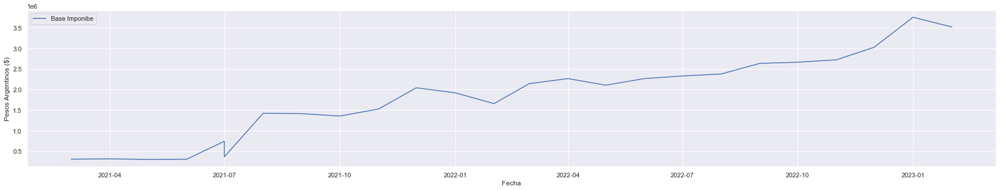

20-26994418-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


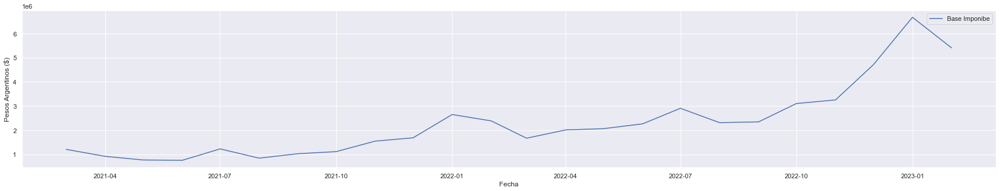

27-23462837-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


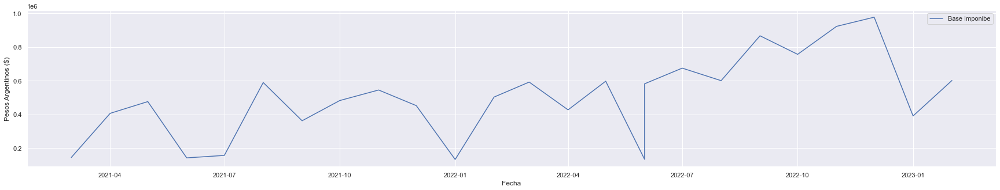

20-30831812-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


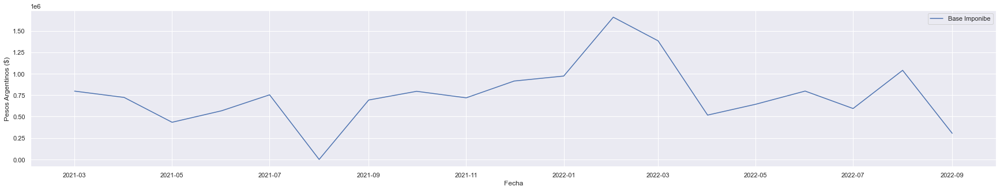

30-71087790-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


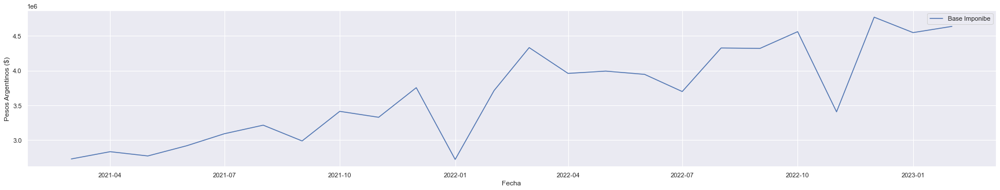

27-27065344-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


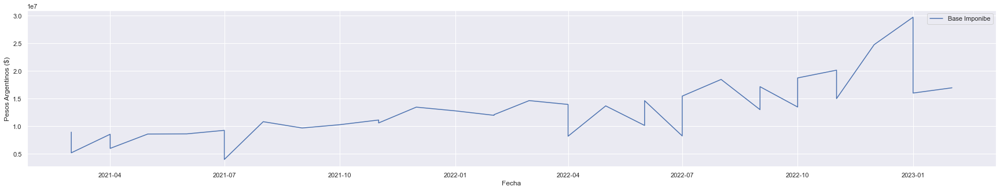

27-12388527-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


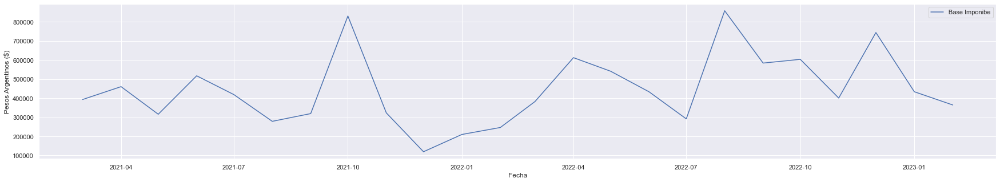

30-71077336-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


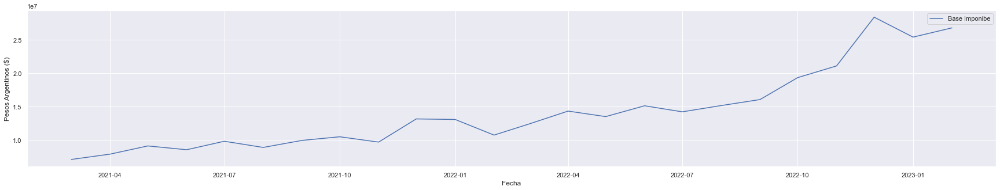

27-95610946-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


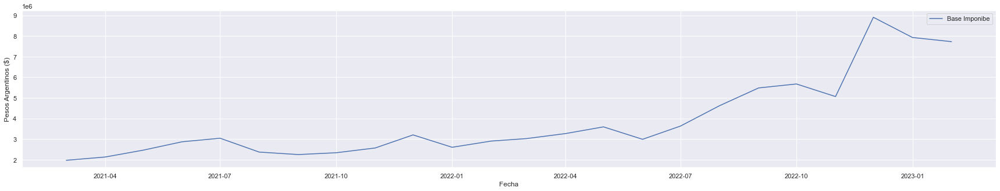

30-71292220-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


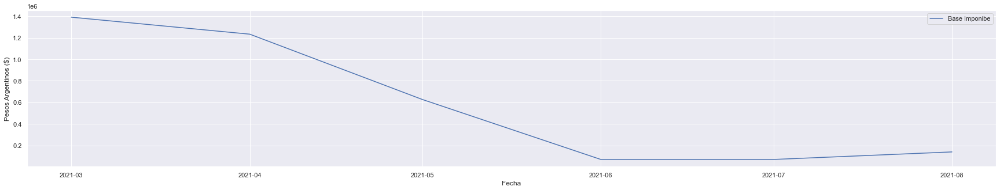

20-20846591-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


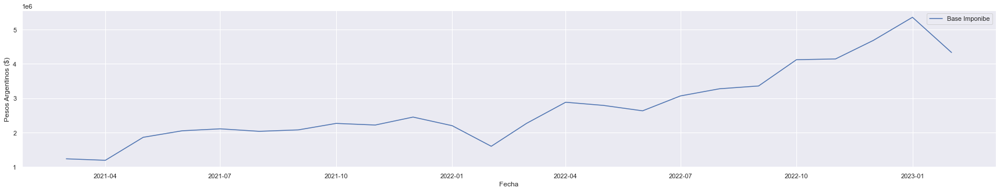

30-71594430-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


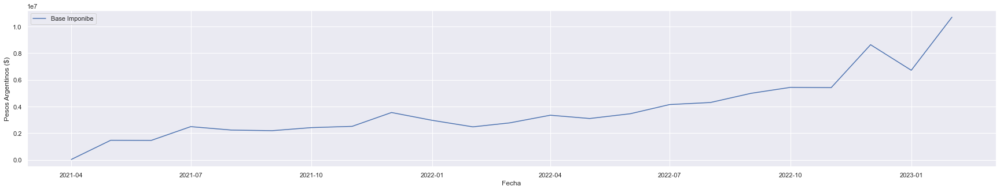

30-56871982-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


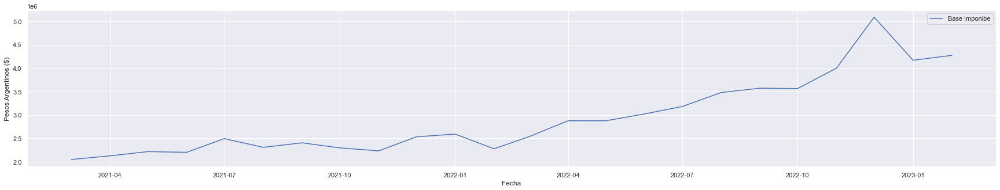

23-95560842-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


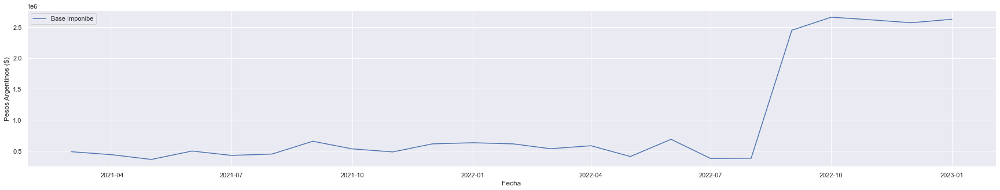

23-23243539-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


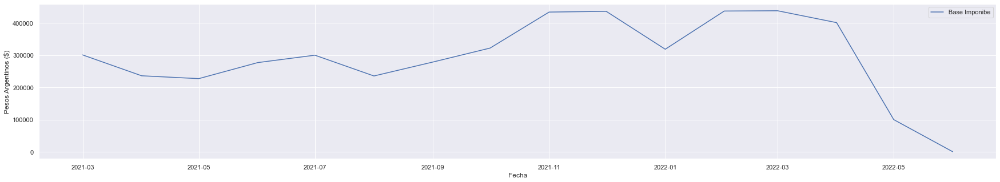

20-22183797-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


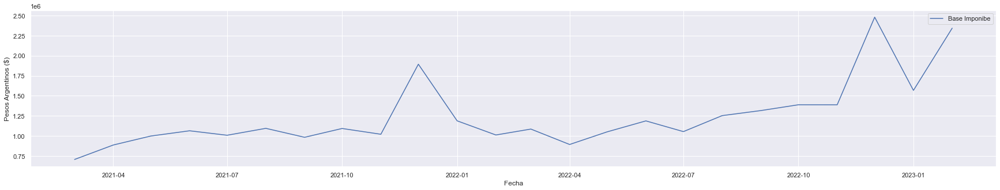

30-65512029-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


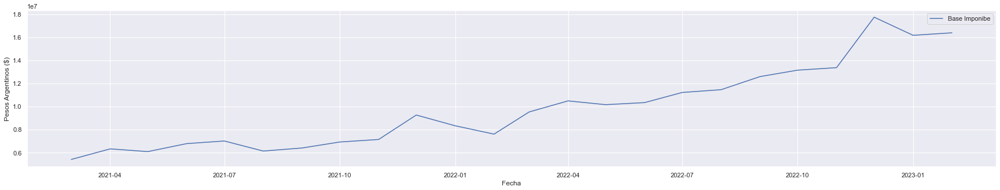

20-14301905-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


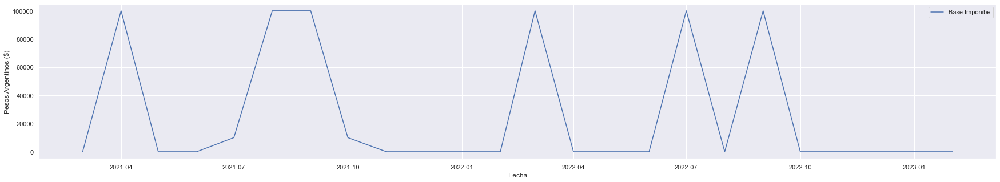

20-37525221-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


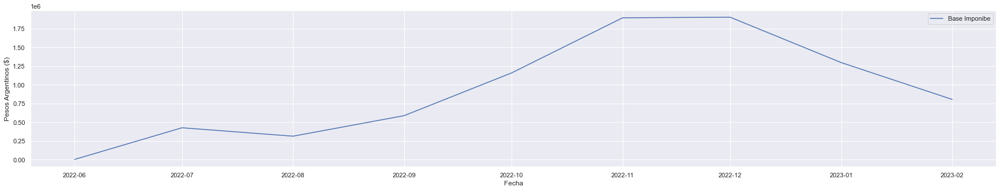

30-71762731-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


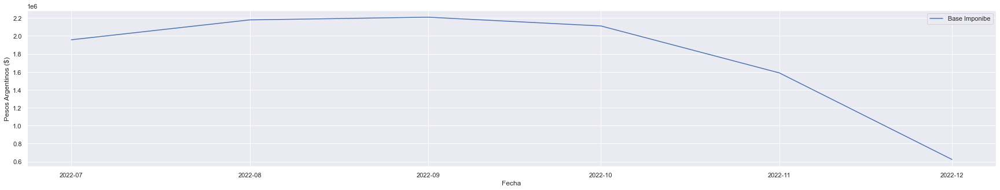

20-96021038-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


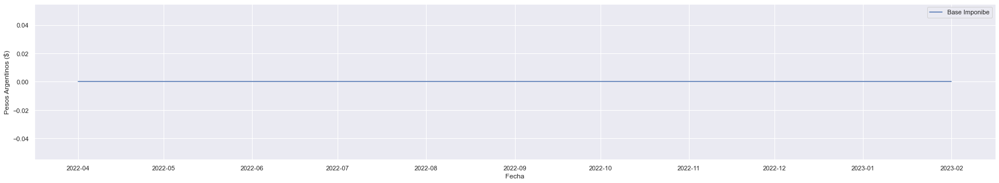

20-13413878-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


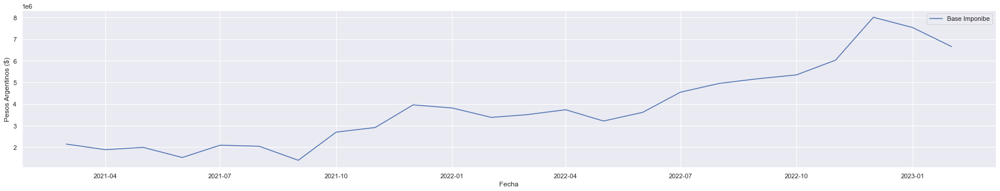

27-95878702-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


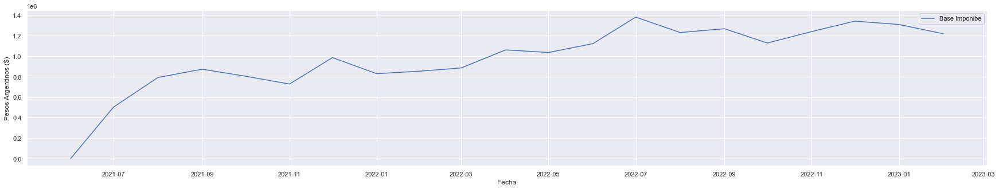

27-14475519-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


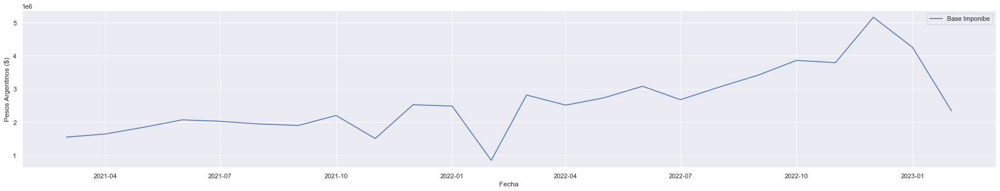

20-06597145-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


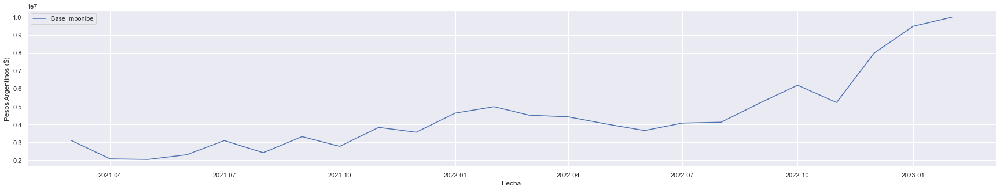

27-94014411-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


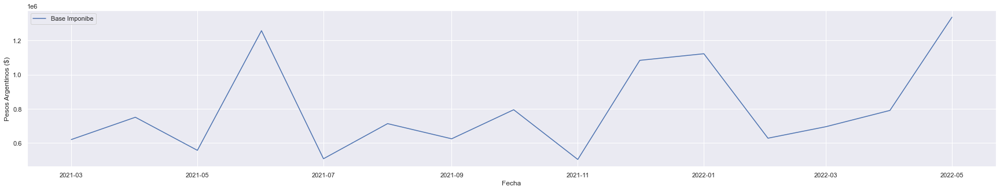

30-66874120-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


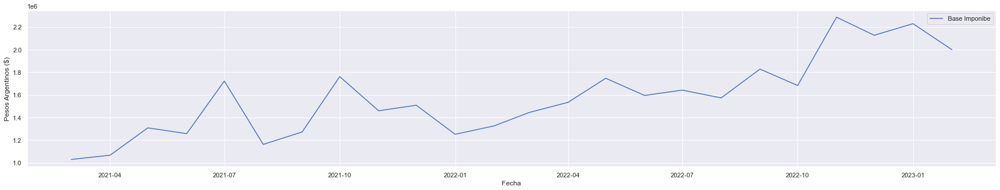

30-60982296-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


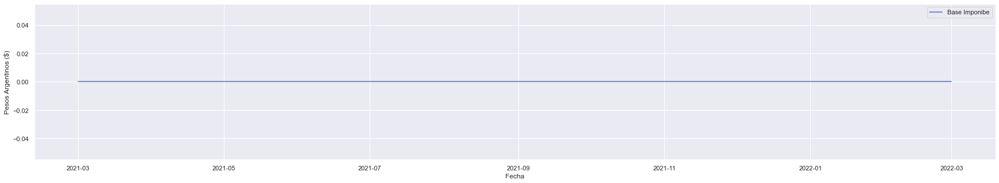

30-71682061-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


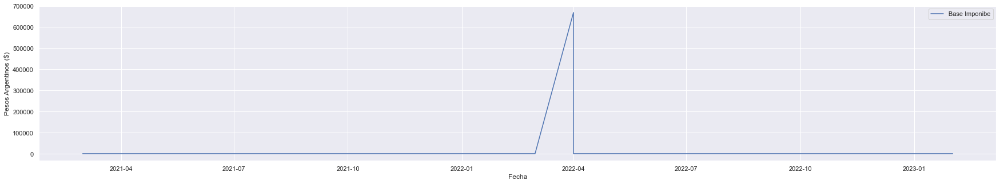

33-70806305-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


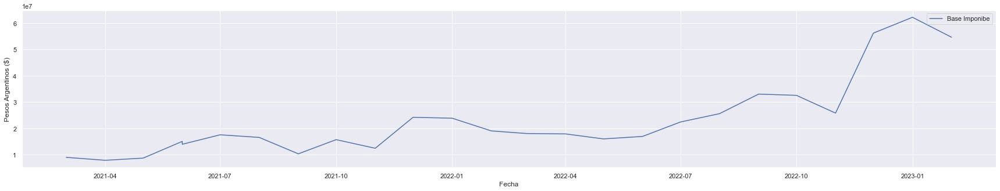

20-05534649-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


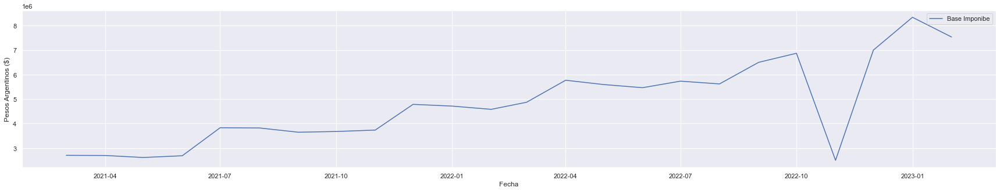

30-59423135-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


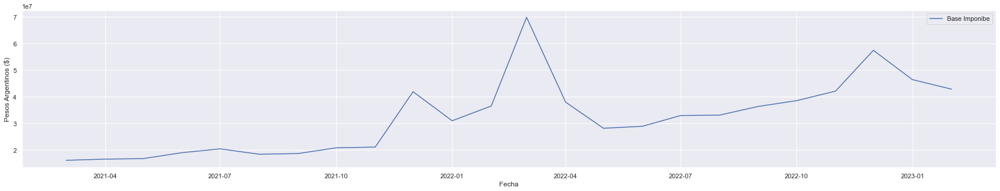

30-71643710-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


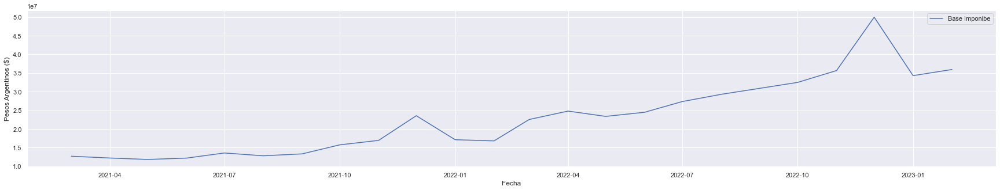

27-94596607-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


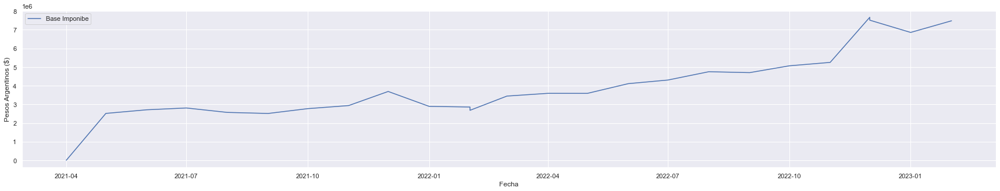

20-94787723-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


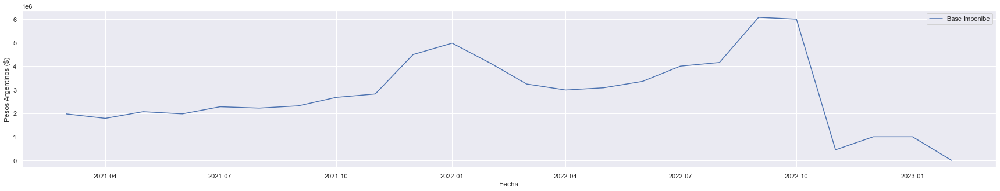

20-27337598-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


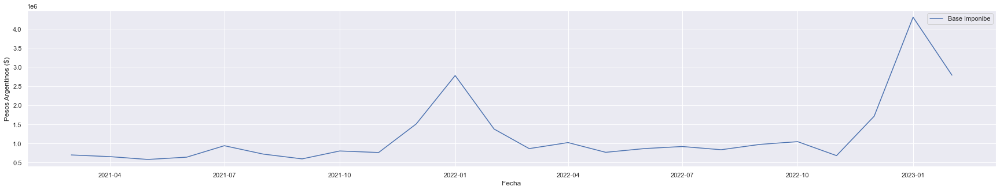

27-17908479-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


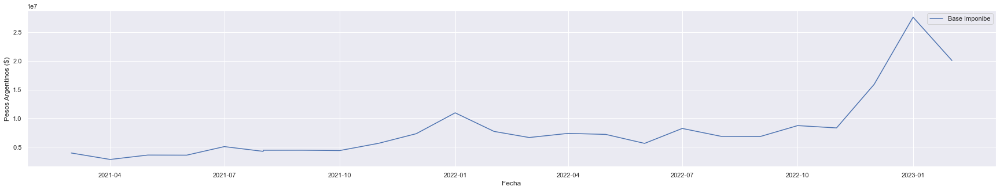

27-30126628-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


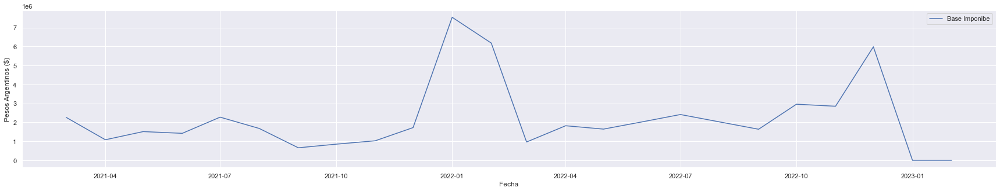

23-94854920-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


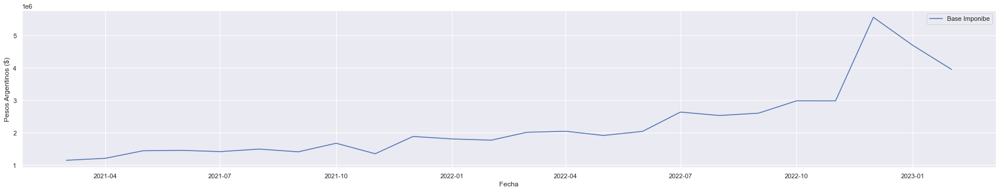

20-94029908-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


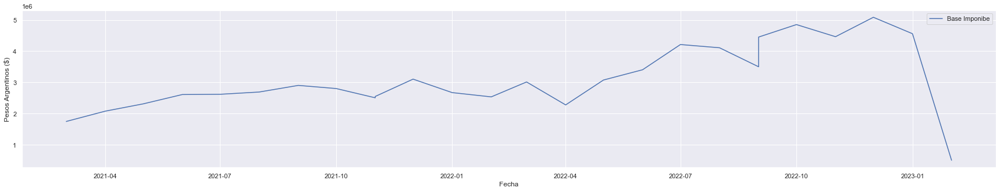

33-71221173-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


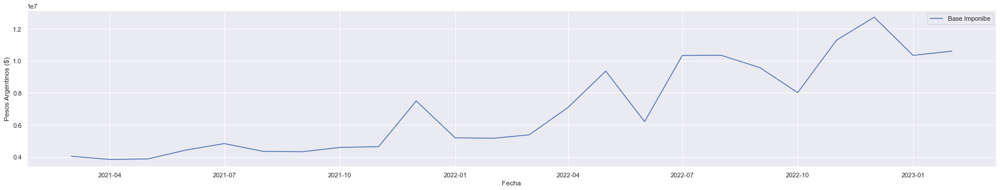

20-96138958-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


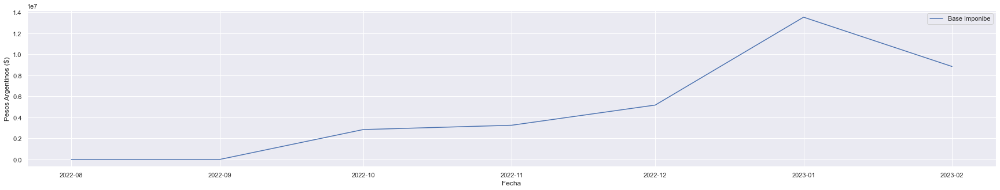

20-23823433-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


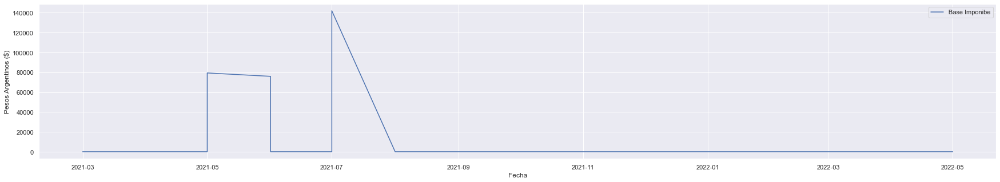

27-95488894-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


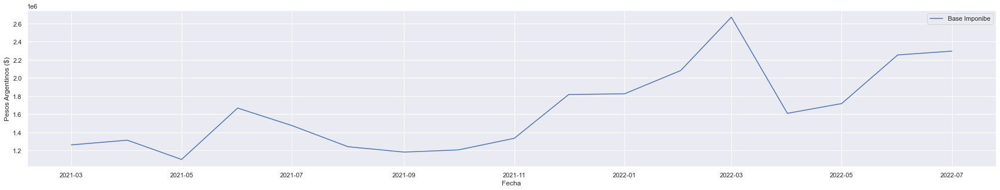

23-94053548-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


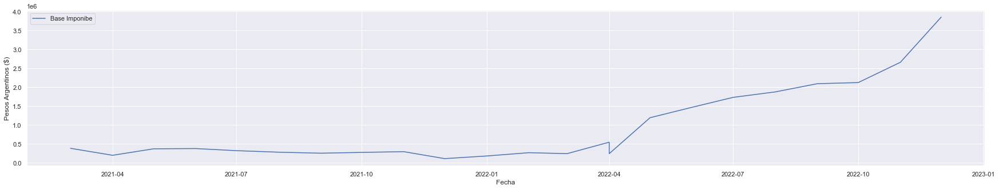

23-94089311-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


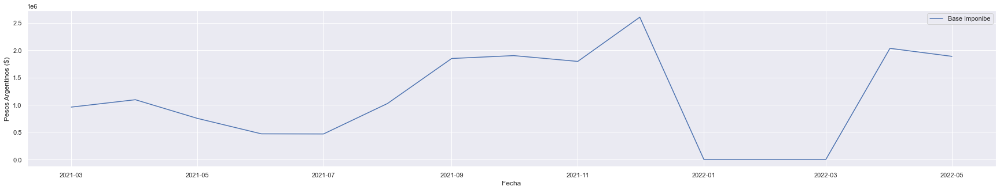

27-12308931-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


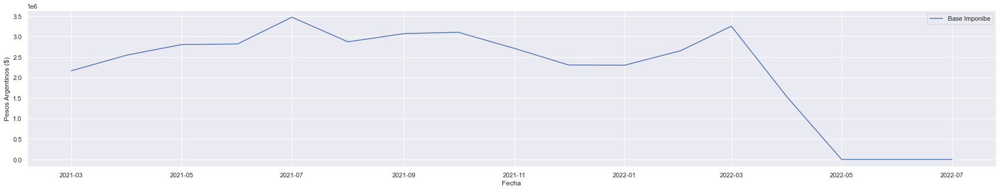

27-16946364-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


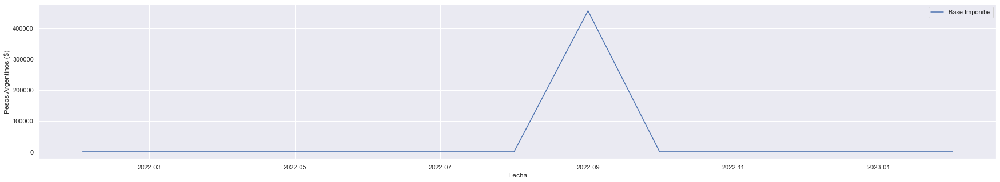

27-95205537-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


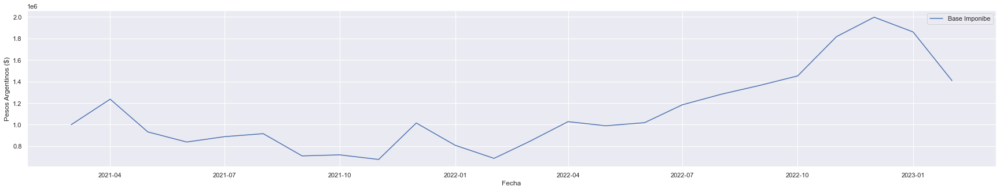

27-95185399-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


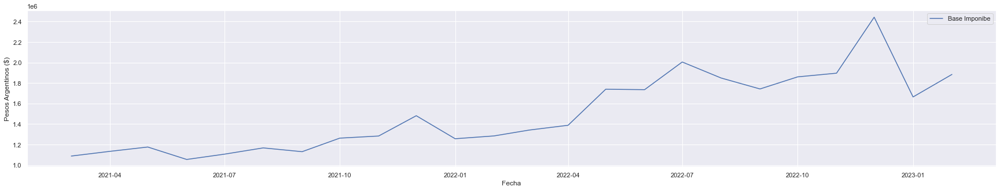

27-95780125-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


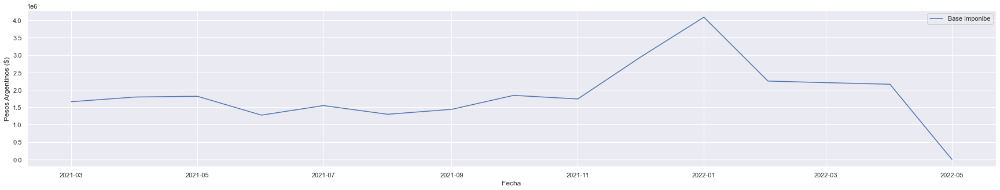

20-94027144-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


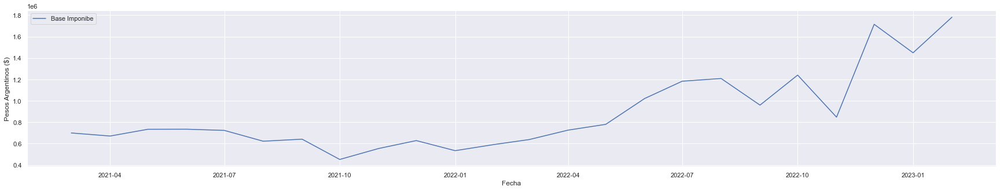

27-95041929-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


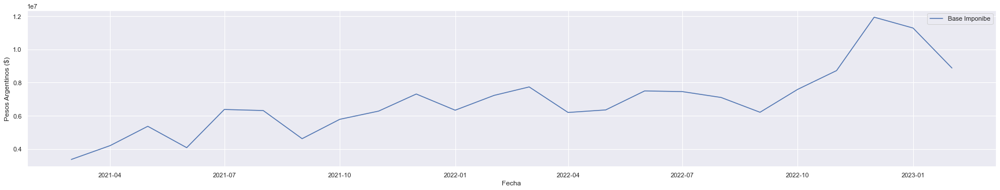

20-17393217-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


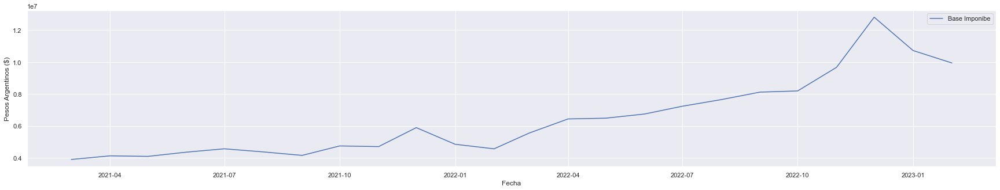

27-16447160-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


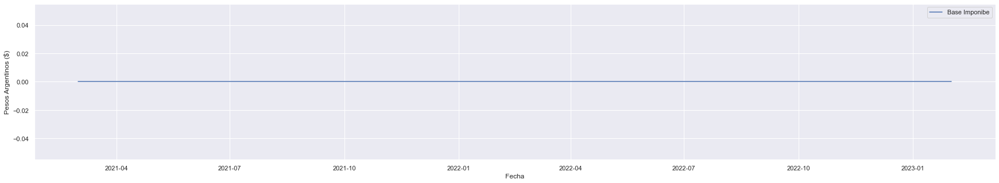

24-93729732-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


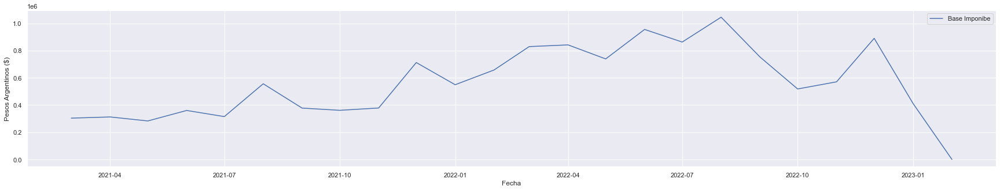

20-25813189-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


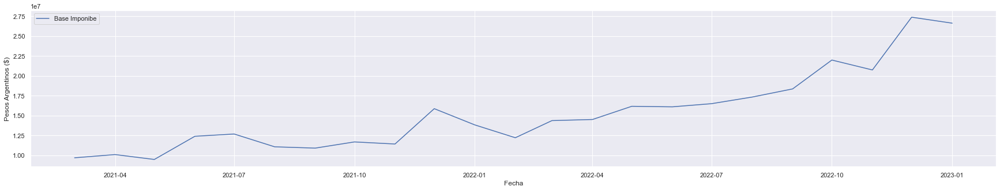

20-94189633-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


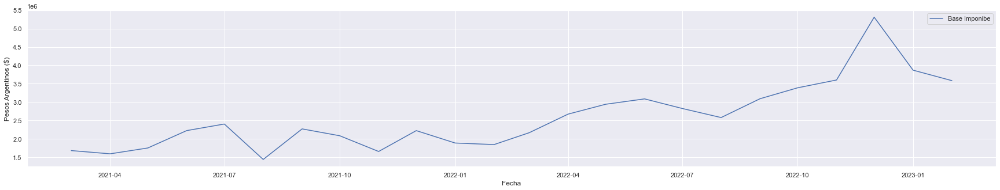

20-34550380-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


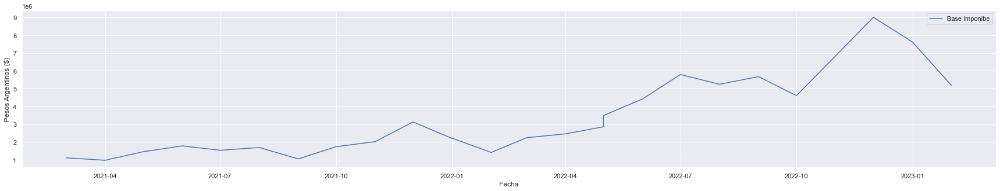

30-70894525-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


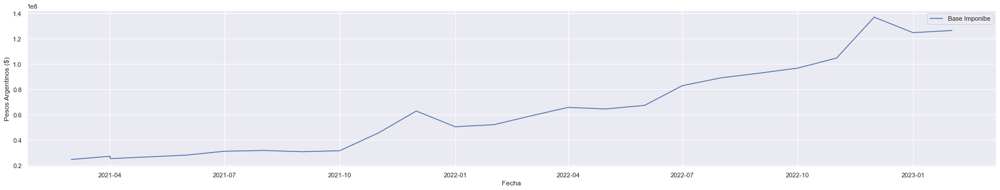

20-35860968-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


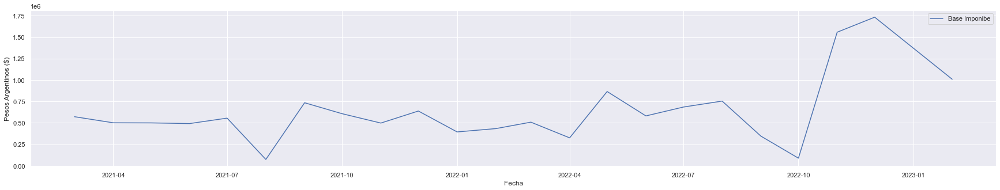

23-95710044-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


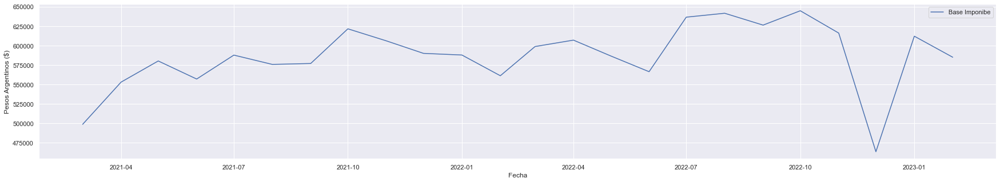

20-94026517-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


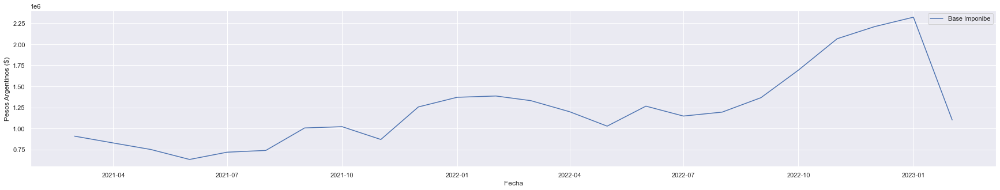

23-20268526-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


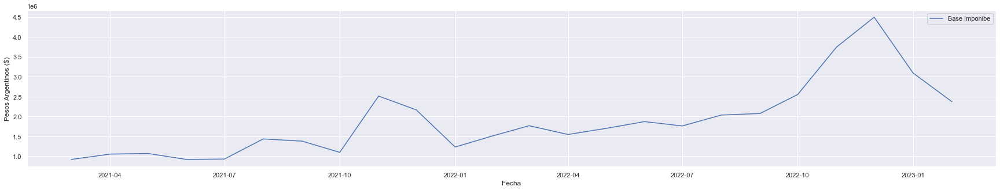

27-94037105-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


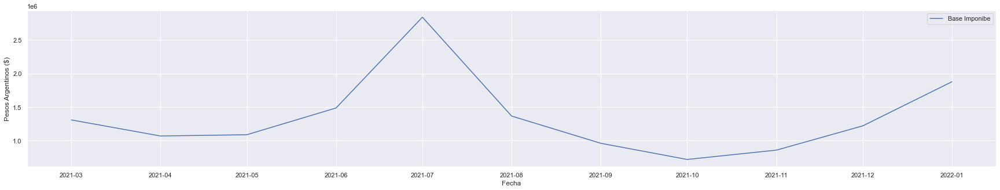

27-95123889-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


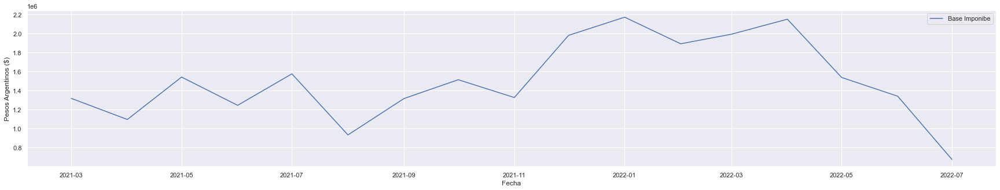

30-66913753-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


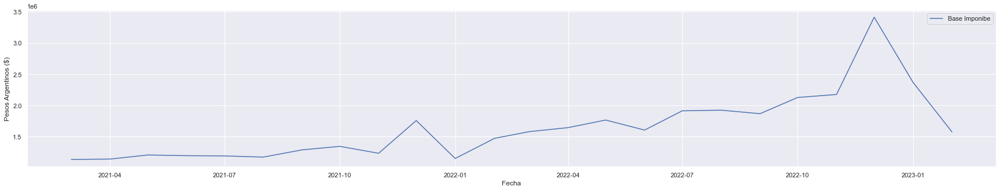

20-21061903-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


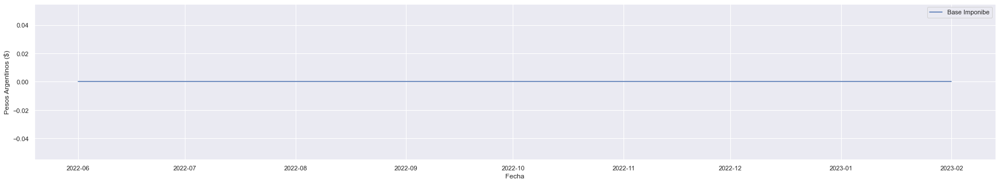

20-12899407-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


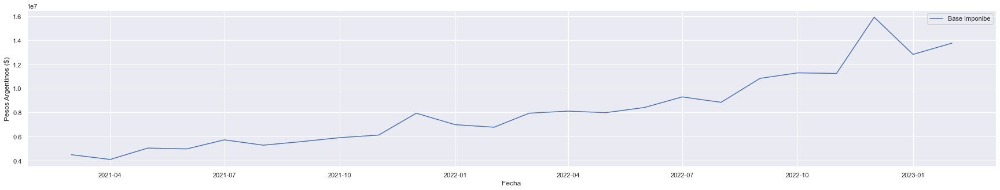

20-13532211-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


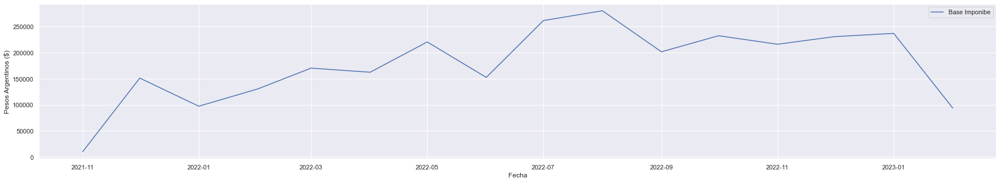

27-95936593-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


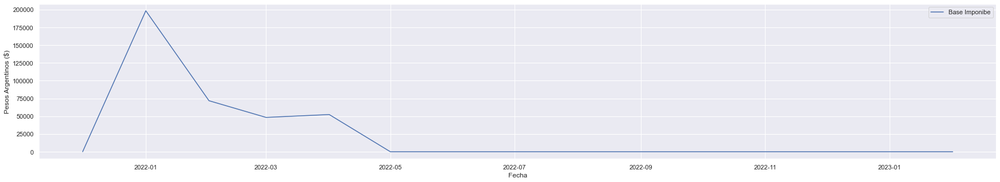

27-95693819-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


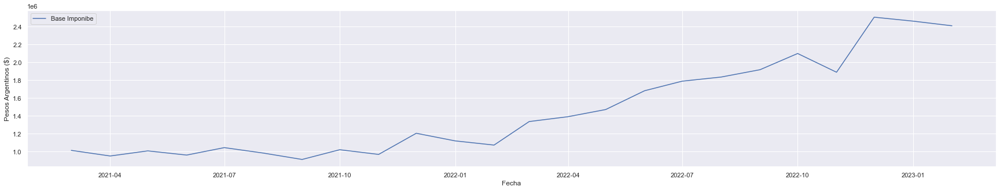

20-10367174-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


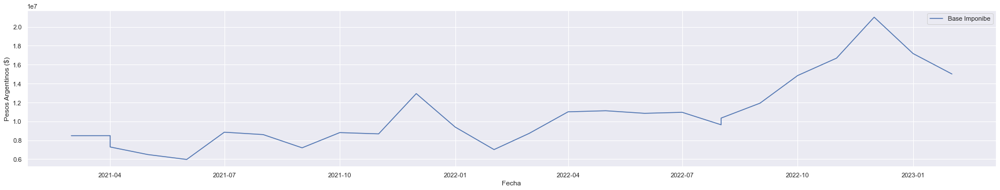

20-35258052-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


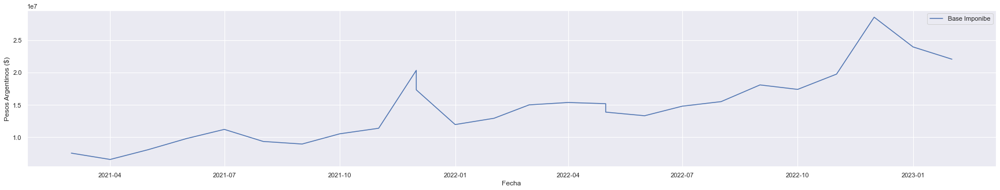

33-71472386-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


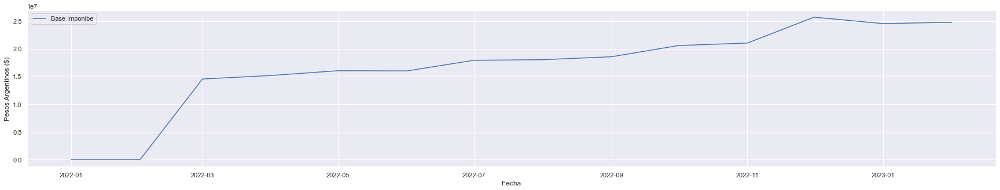

30-64707370-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


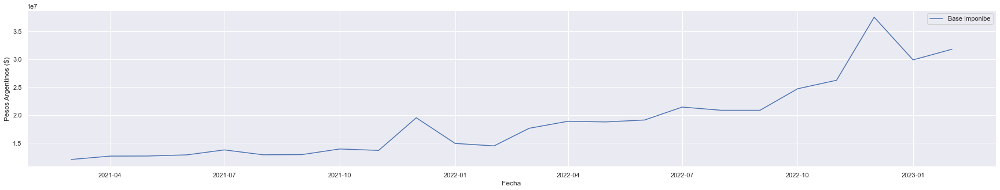

23-96060786-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


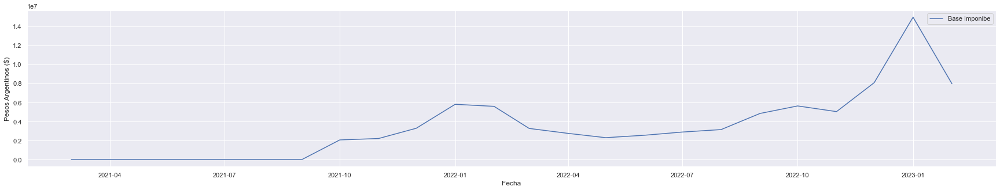

24-25951731-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


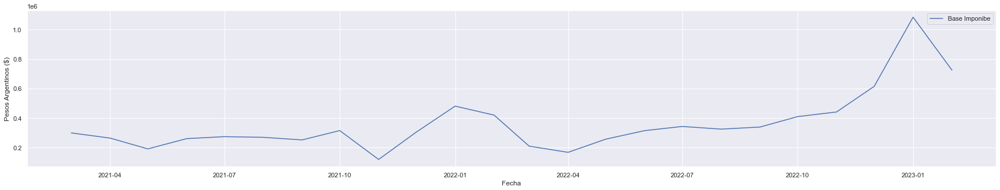

27-94115065-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


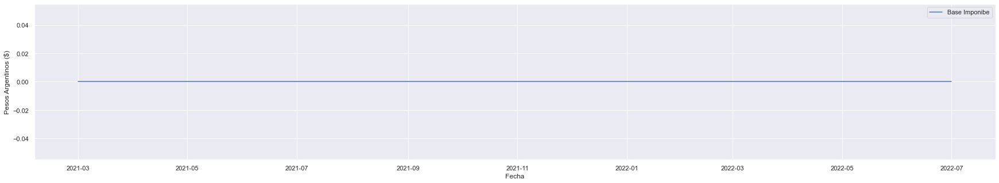

30-57427238-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


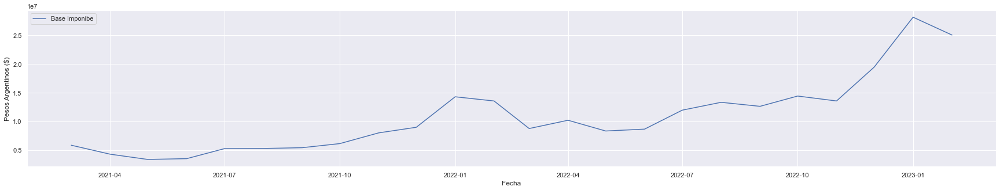

27-94729577-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


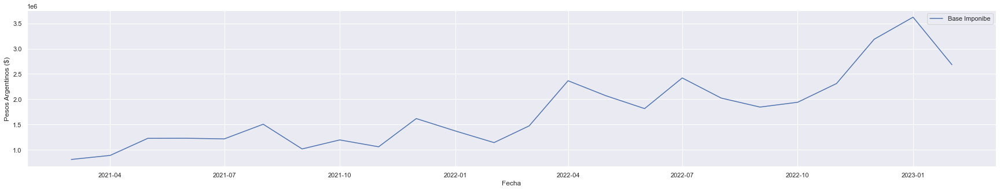

30-58633858-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


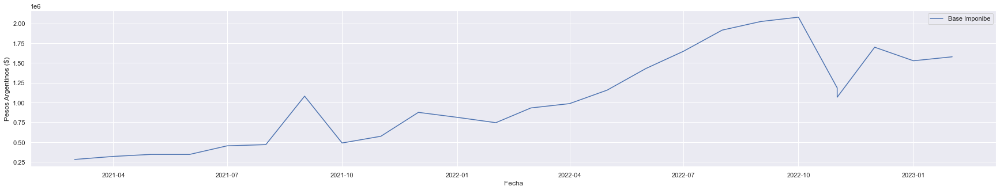

30-71585902-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


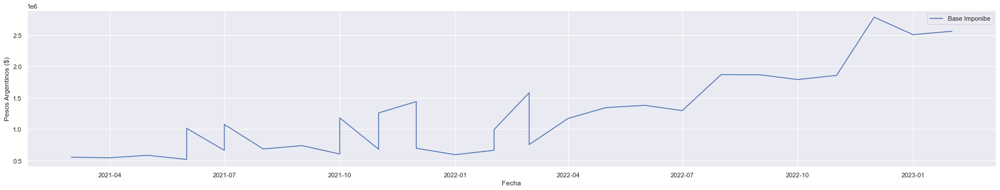

27-33349950-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


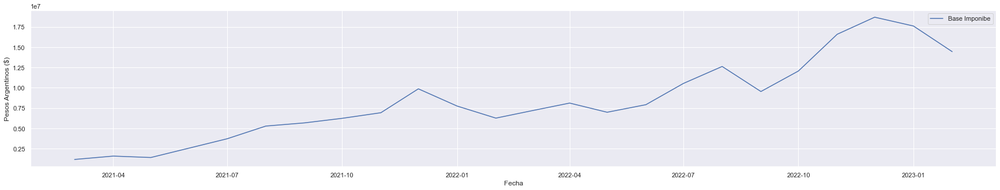

23-95309366-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


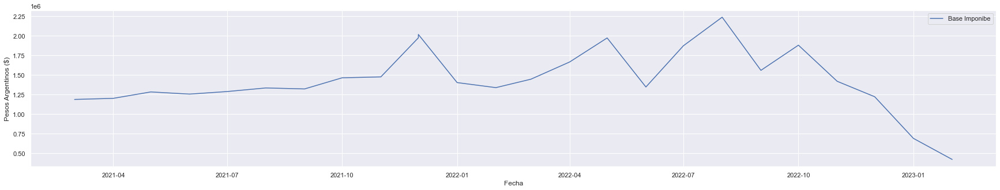

20-36490873-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


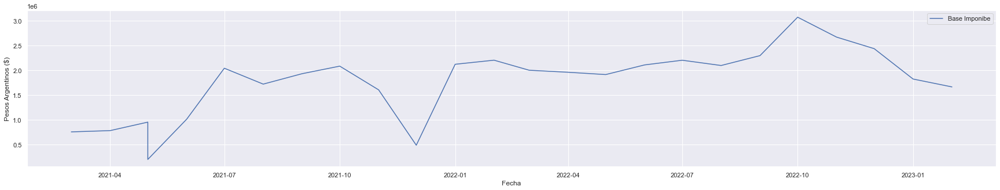

20-94062588-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


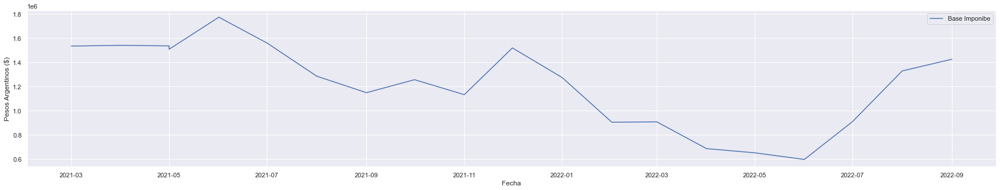

23-94958621-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


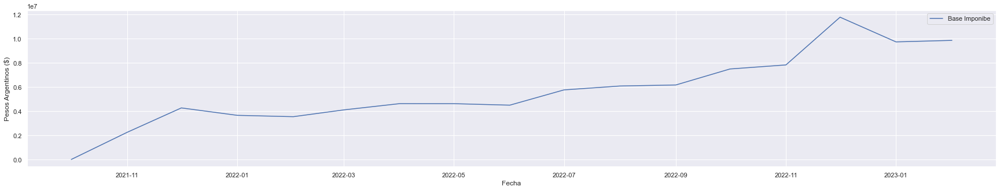

20-28583601-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


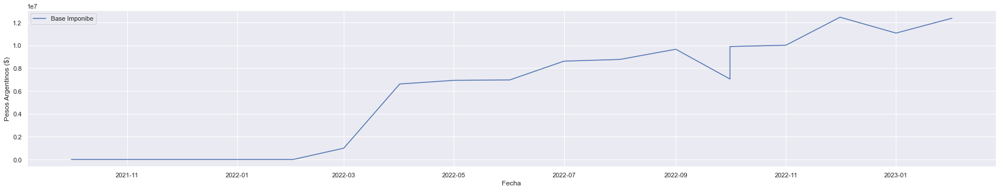

33-70849591-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


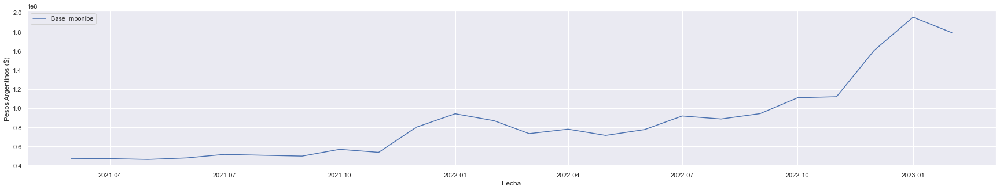

27-95694534-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


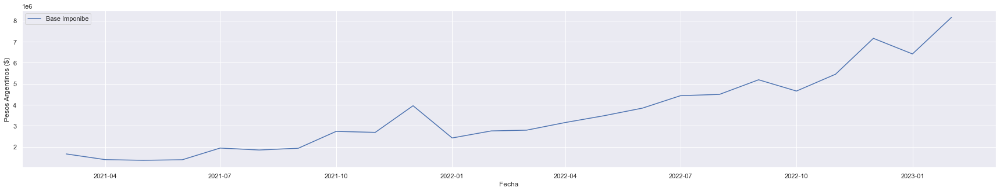

27-95883210-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


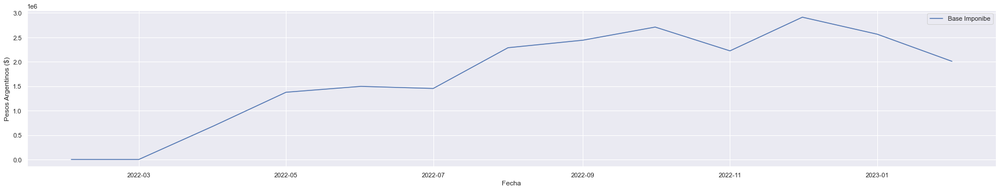

30-71602173-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


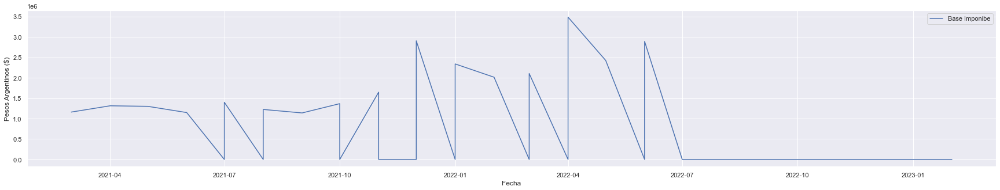

23-94777837-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


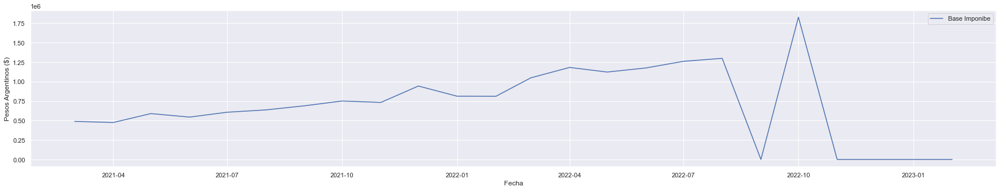

20-94157092-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


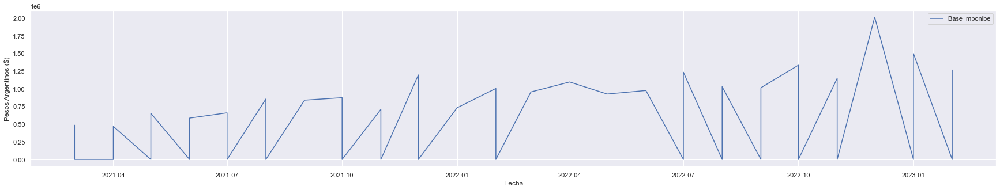

27-04412501-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


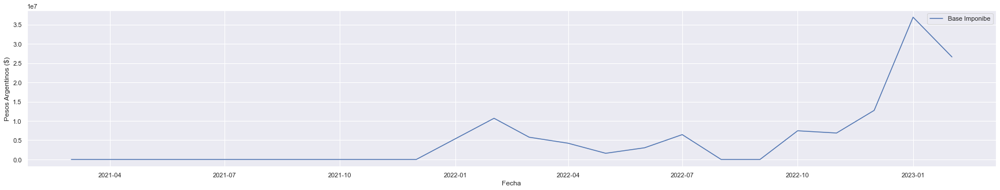

23-18371102-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


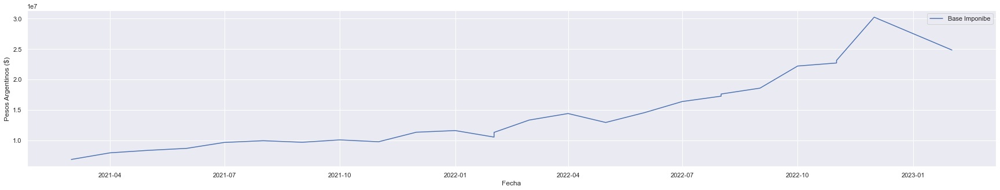

20-34010298-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


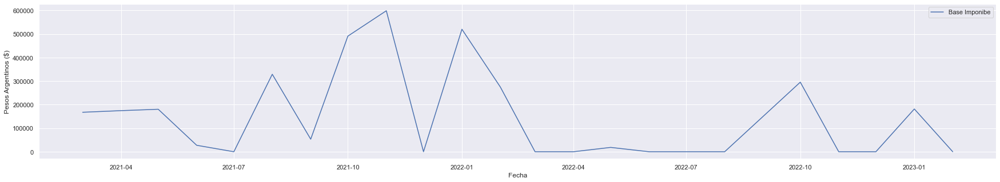

27-95695813-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


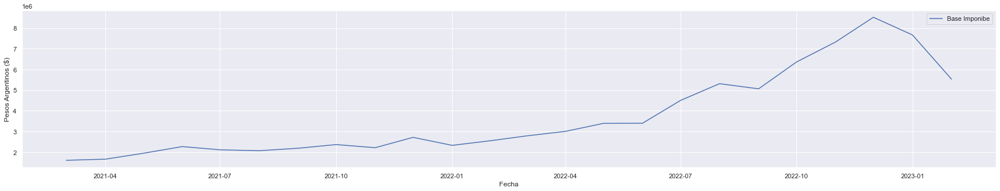

20-26257473-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


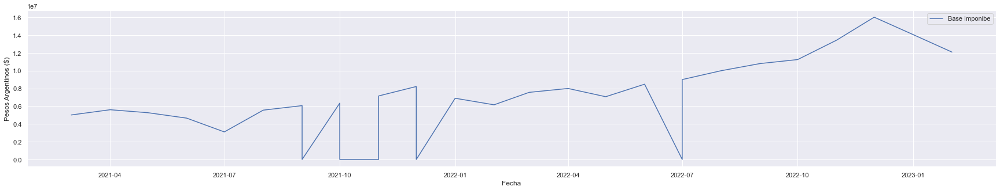

30-70800115-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


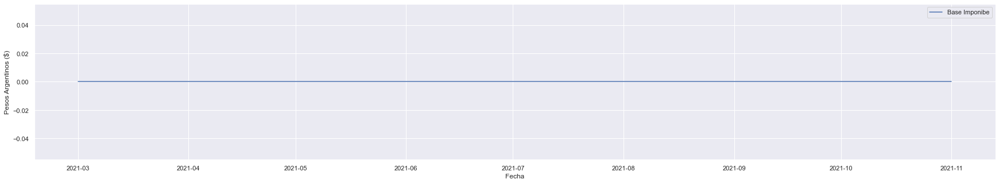

30-70800113-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


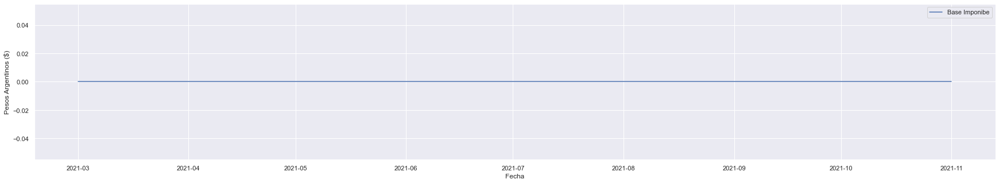

30-70800109-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


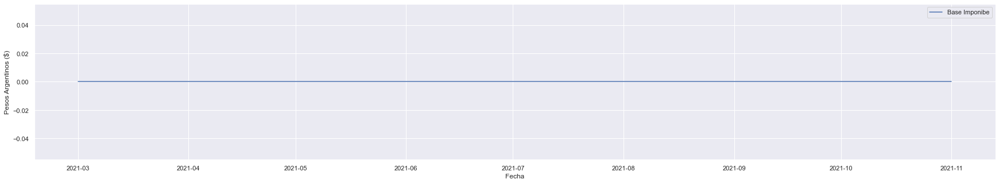

20-94084675-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


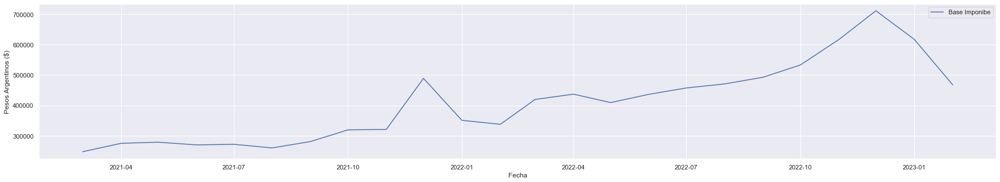

30-71010220-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


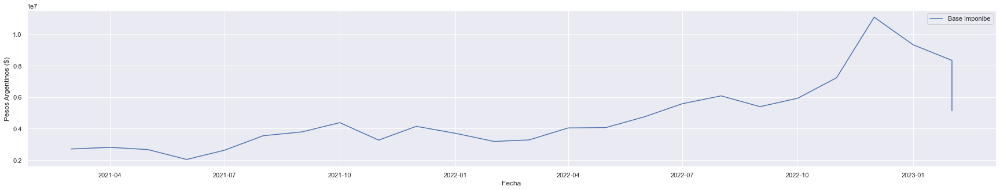

23-36747641-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


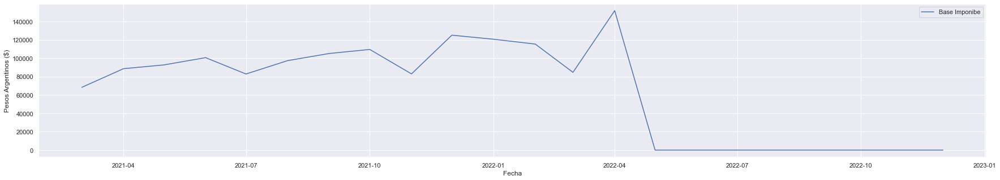

20-94020059-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


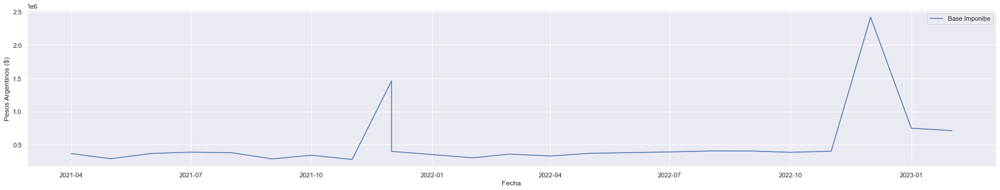

23-38885290-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


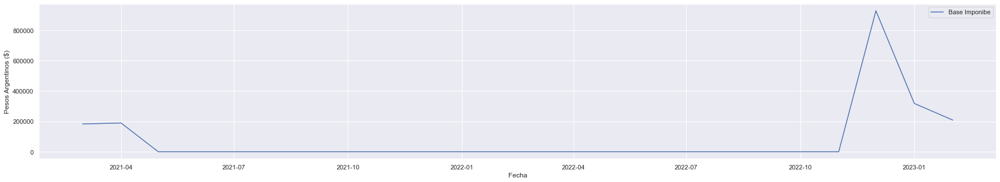

20-34354795-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


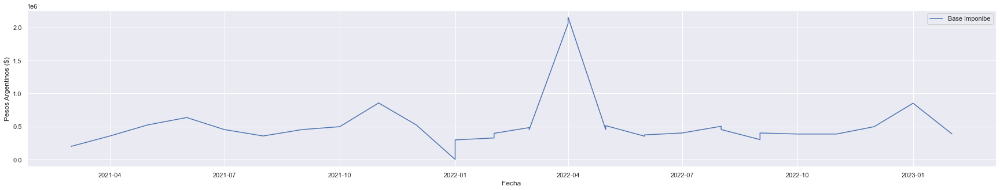

20-06375282-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


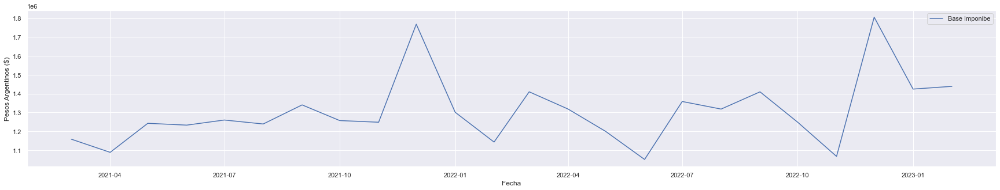

20-95245876-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


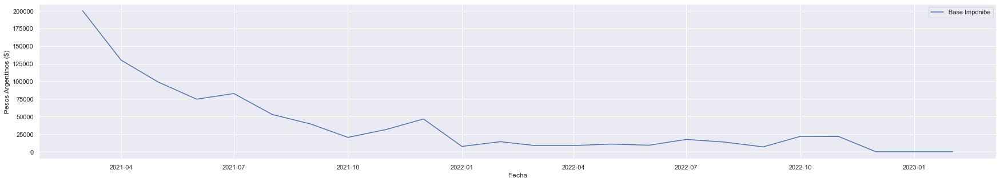

20-21830302-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


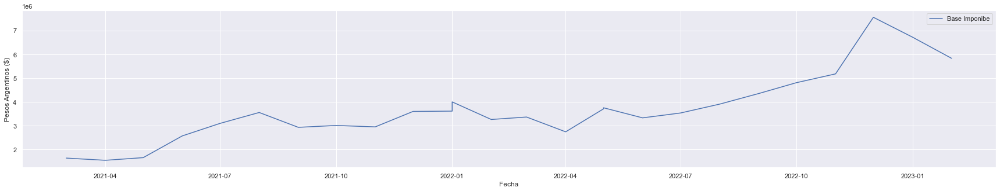

20-16498055-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


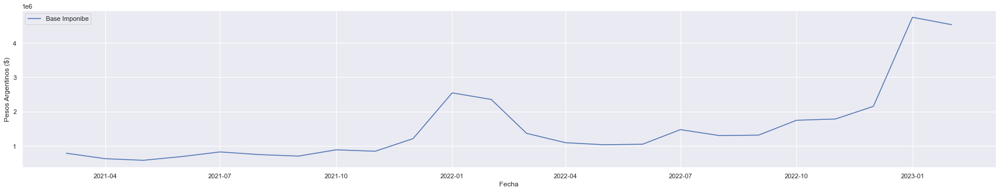

20-94742911-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


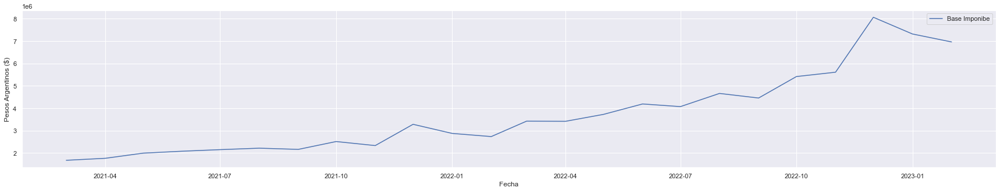

20-95451042-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


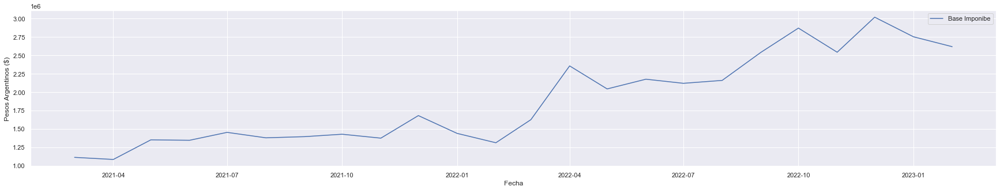

30-71721001-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


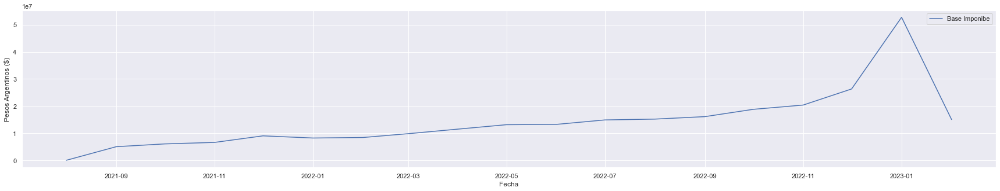

20-95877915-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


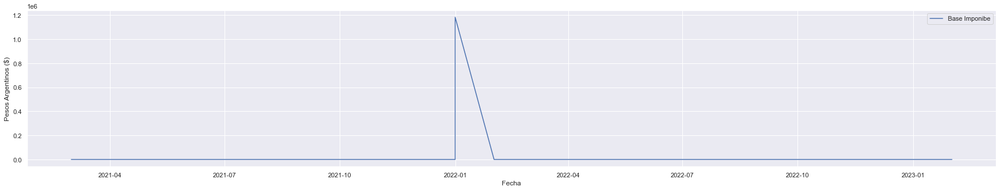

20-10426555-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


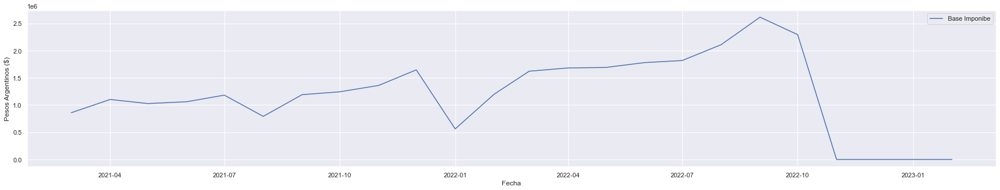

20-95302235-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


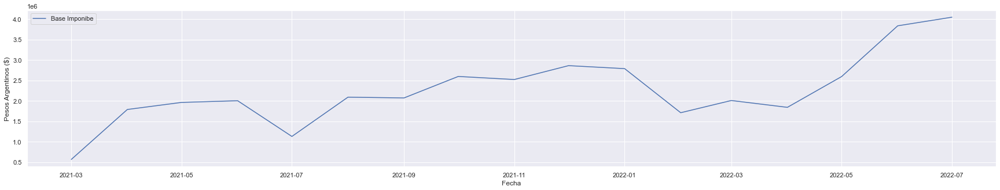

20-07870992-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


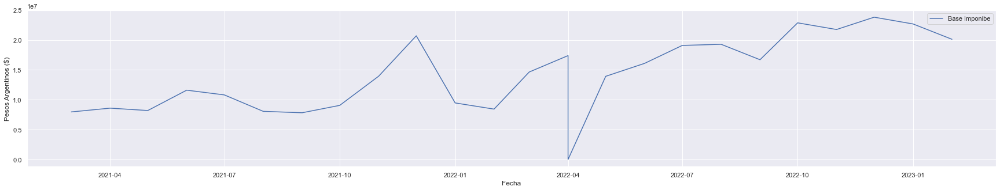

27-94057280-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


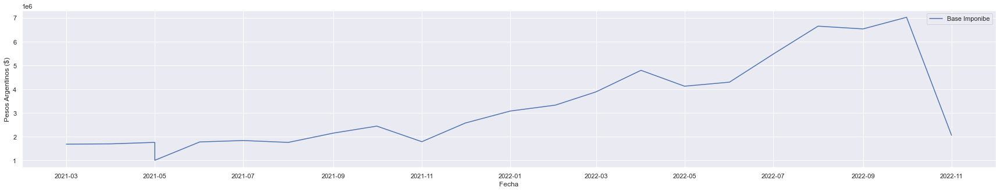

20-94629171-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


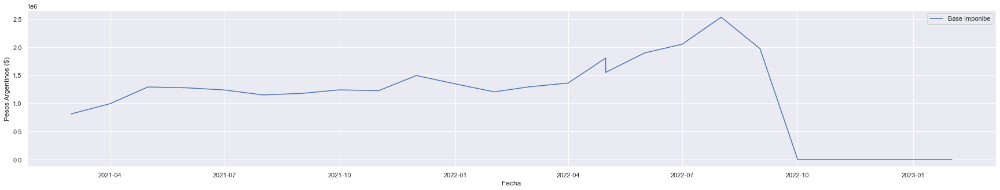

30-71626730-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


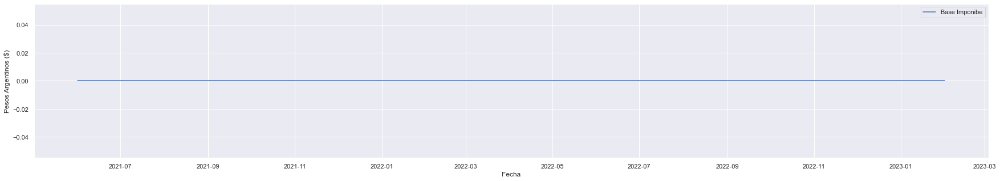

<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


30-71426469-5


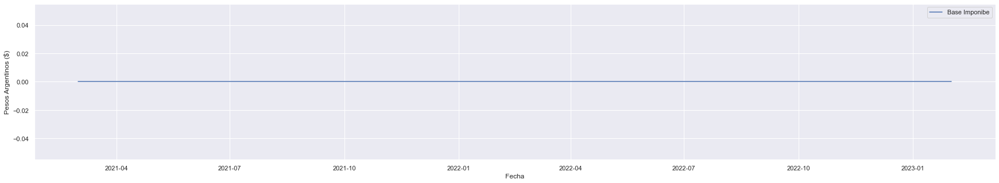

27-95245823-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


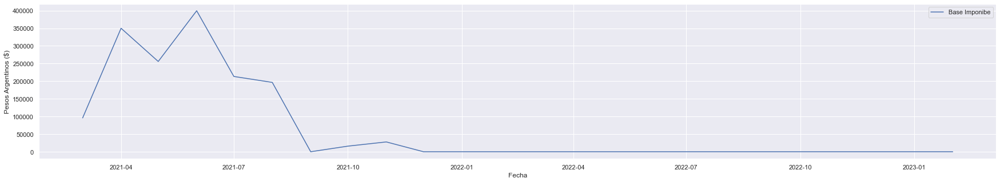

30-71490214-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


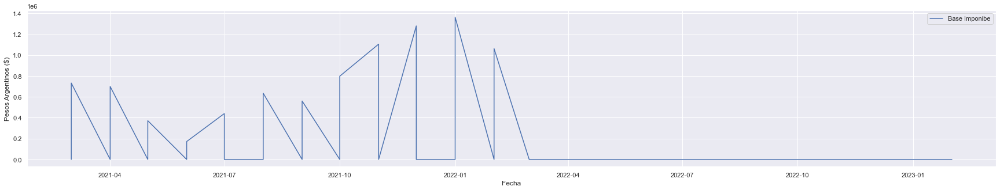

30-71668320-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


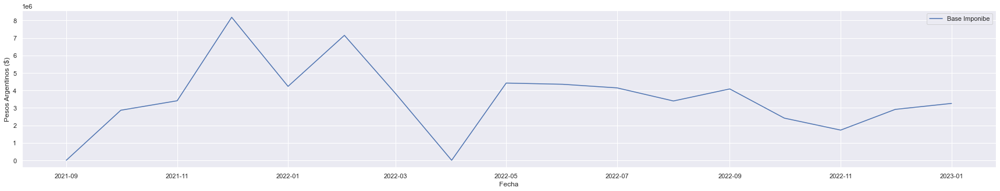

20-94007399-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


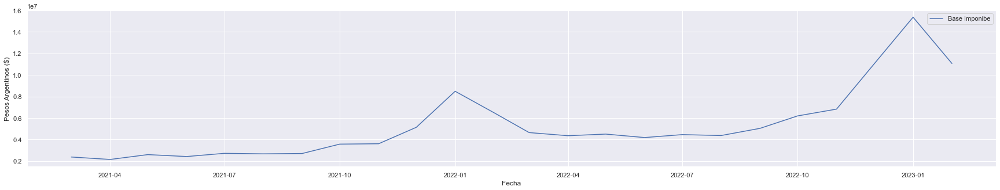

30-71142736-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


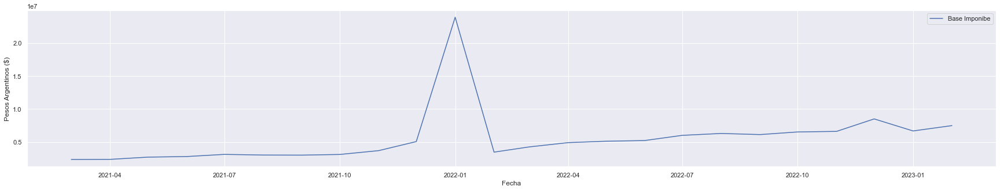

30-71565171-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


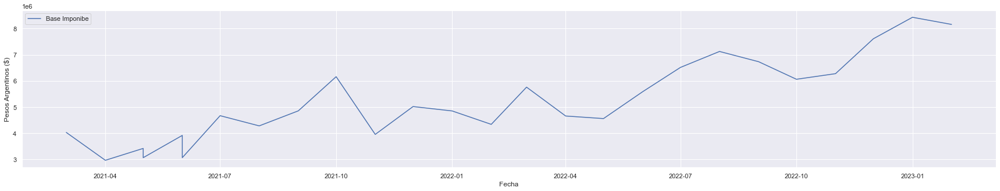

20-94742894-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


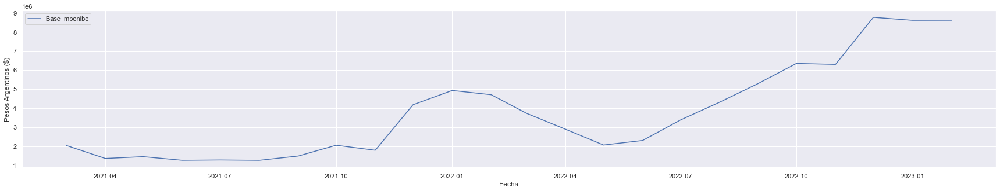

30-66897893-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


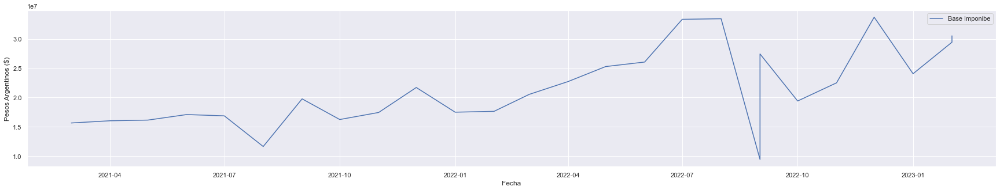

30-71481486-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


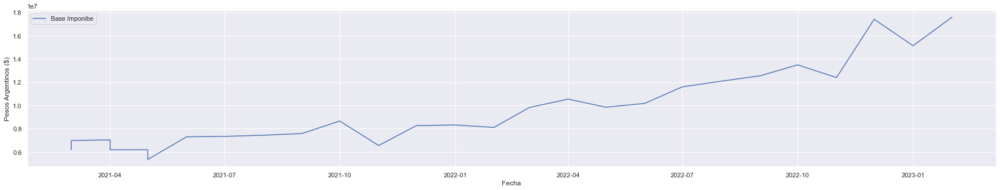

30-71049877-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


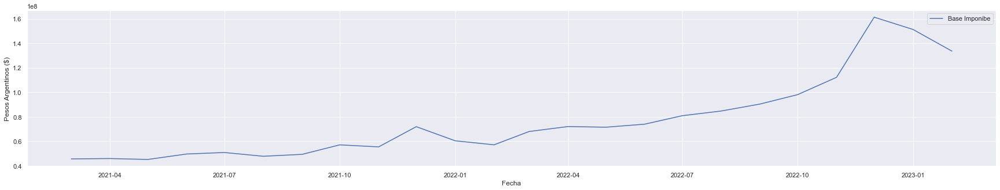

20-14301925-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


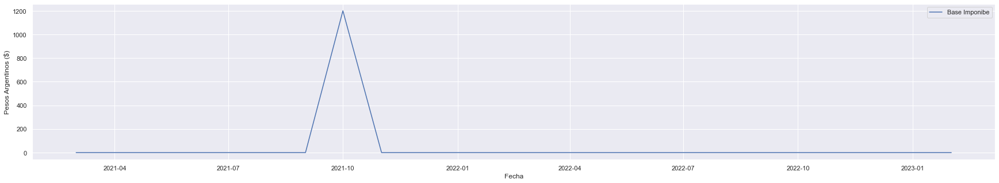

27-95290387-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


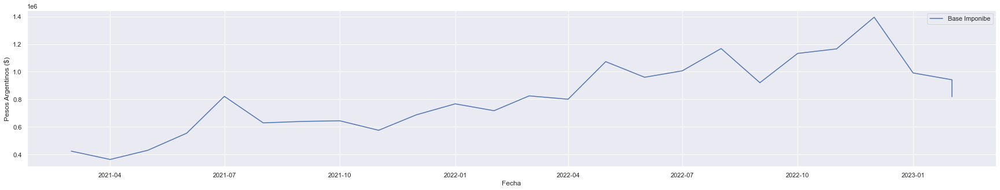

20-95135404-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


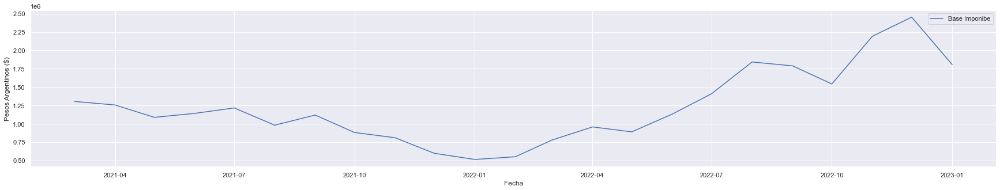

27-94026960-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


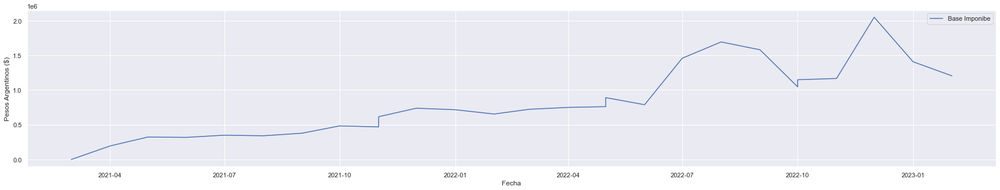

30-71187322-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


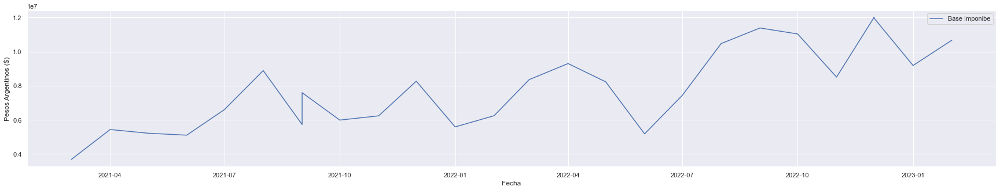

20-95293117-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


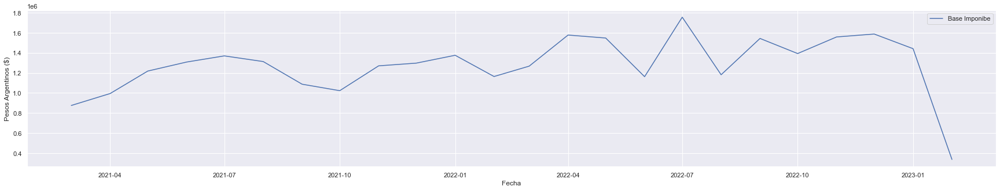

20-95159402-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


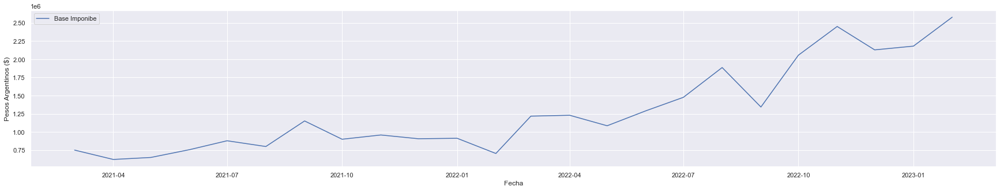

20-94012410-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


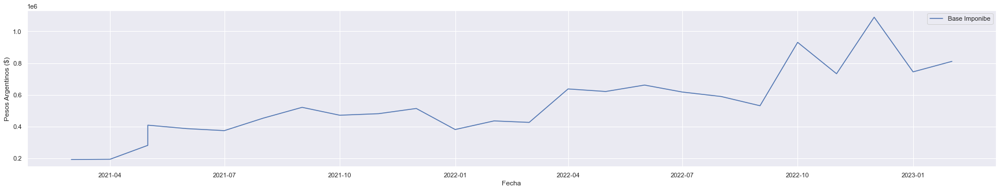

20-95613026-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


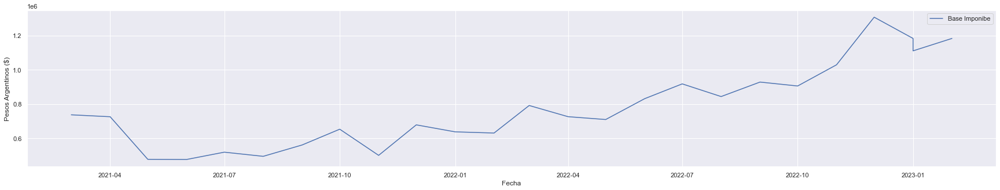

27-29332962-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


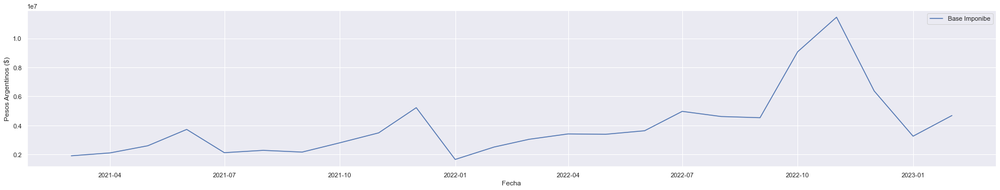

20-95637403-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


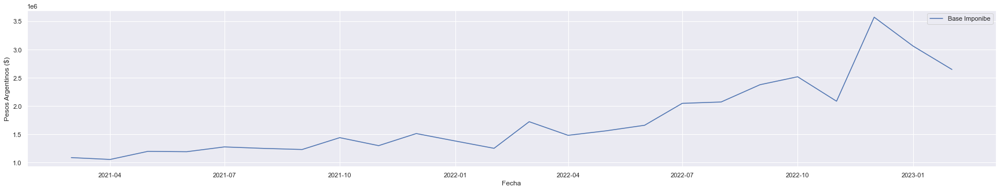

20-95196388-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


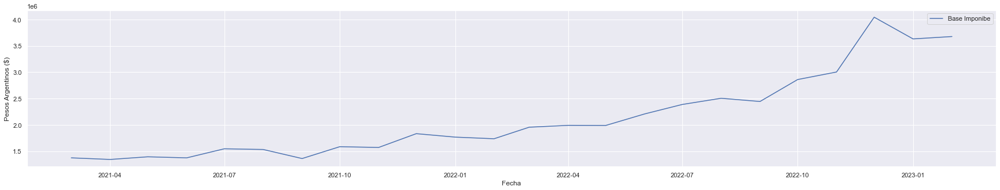

23-26528947-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


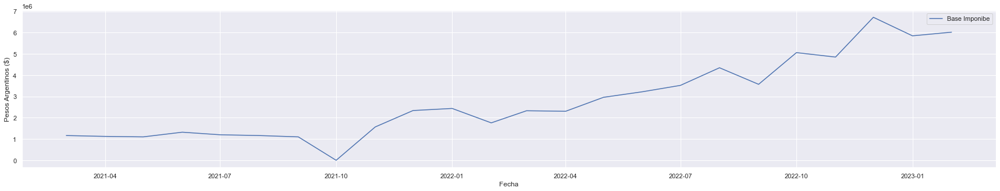

27-95749195-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


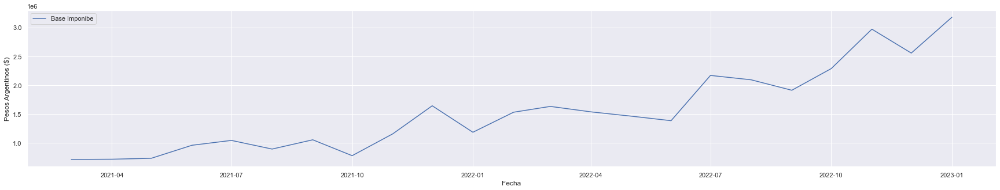

20-95895309-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


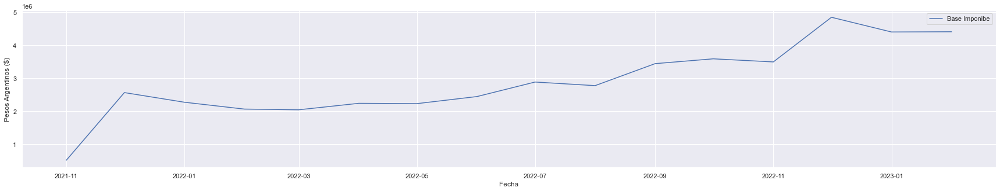

27-95727911-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


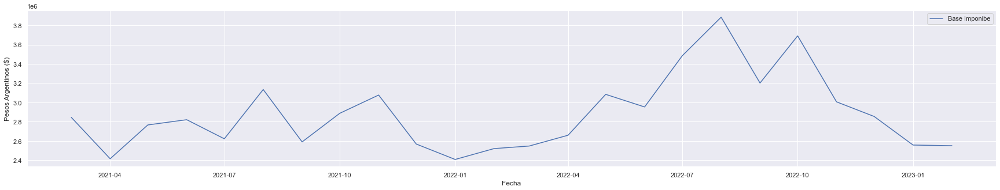

30-71670747-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


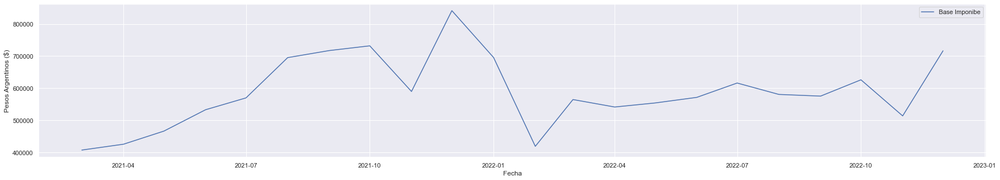

30-71462353-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


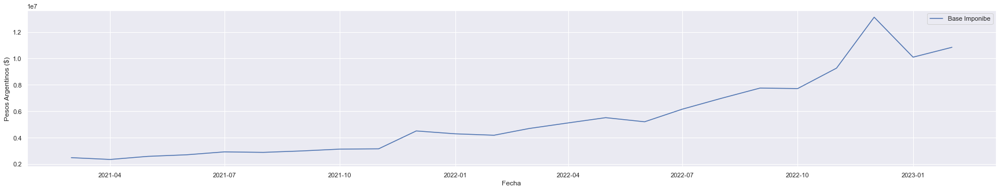

30-70918645-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


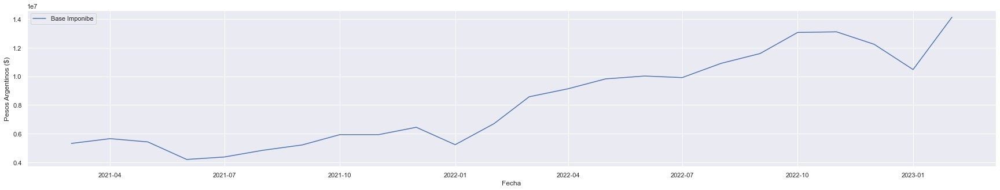

20-12245004-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


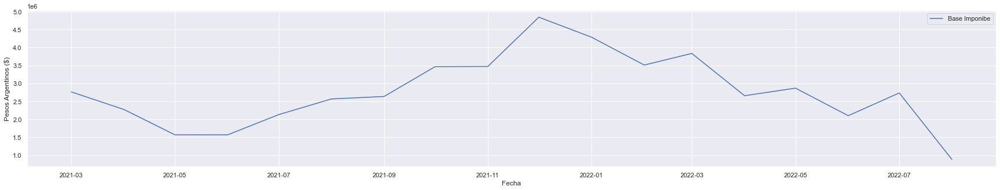

30-71729018-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


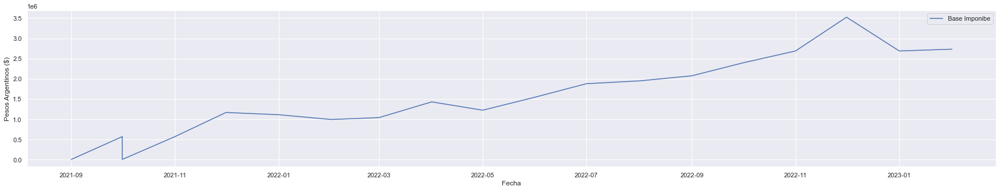

27-95245820-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


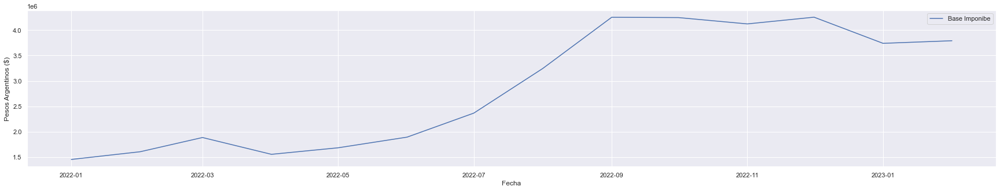

20-35168948-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


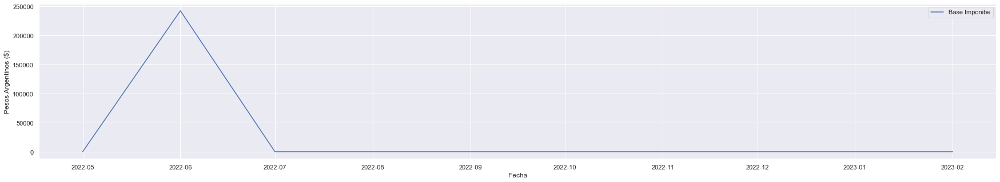

30-71121930-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


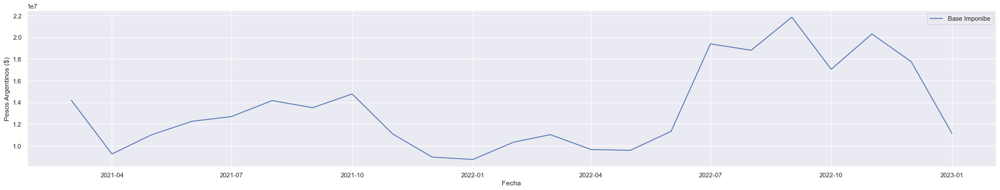

30-71735211-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


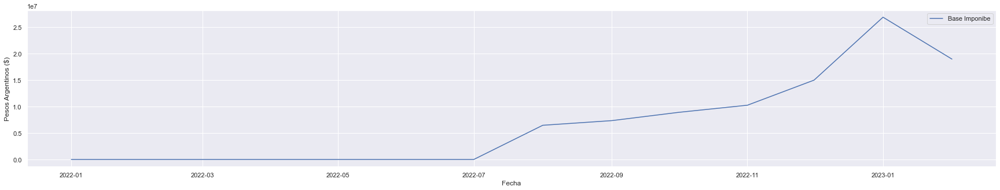

27-20581105-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


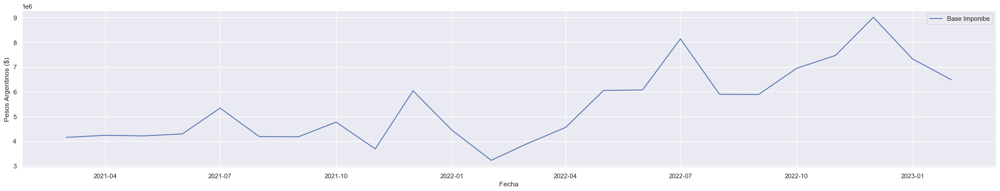

20-95459675-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


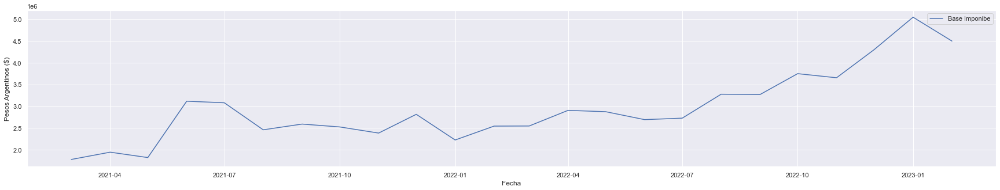

20-24182642-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


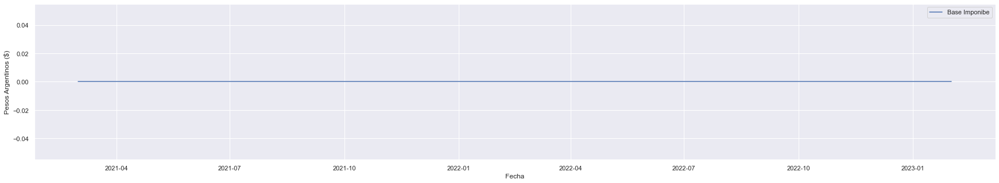

27-95288824-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


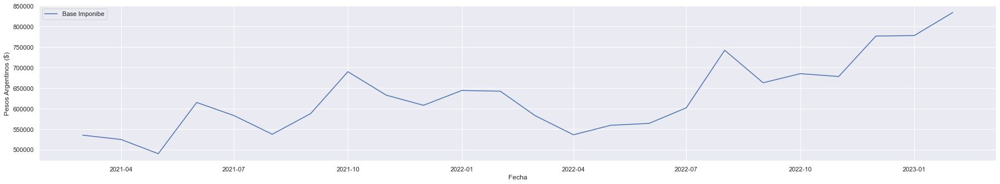

30-71198069-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


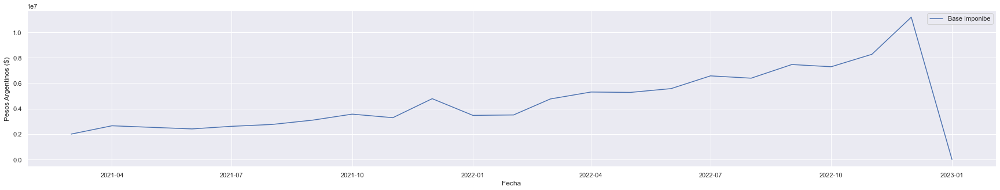

20-95422188-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


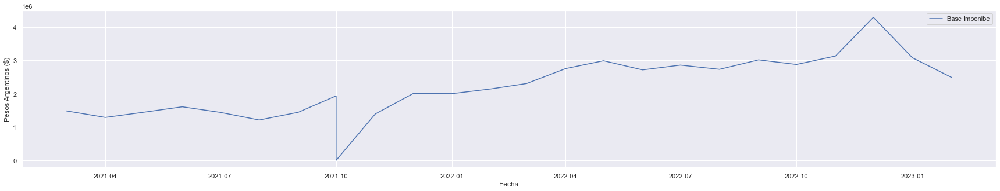

27-94883318-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


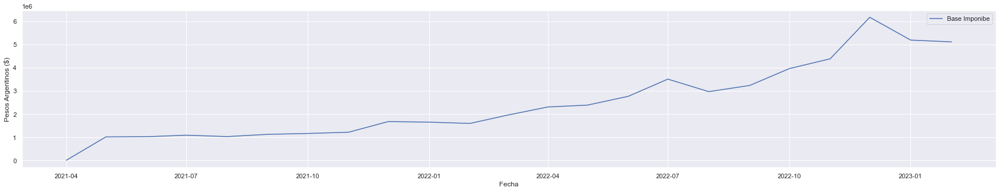

20-93861699-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


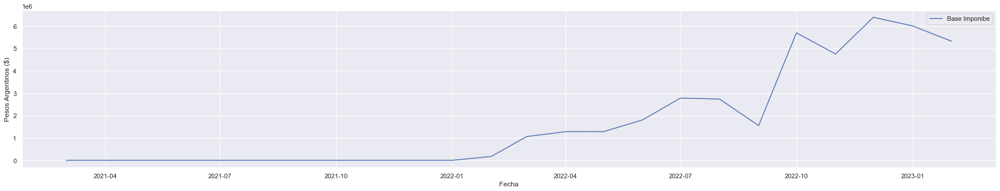

20-95184052-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


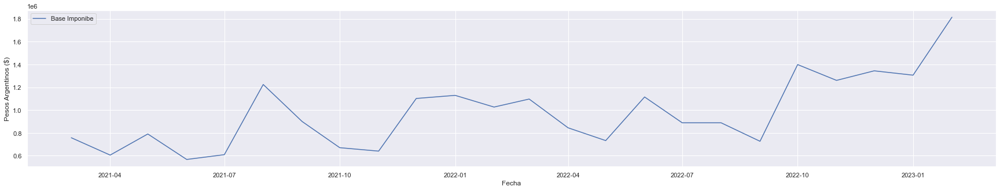

27-29962880-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


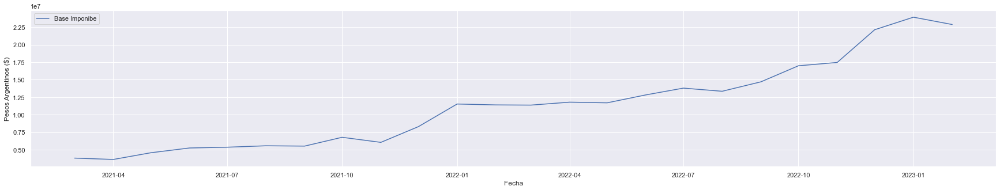

30-66917489-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


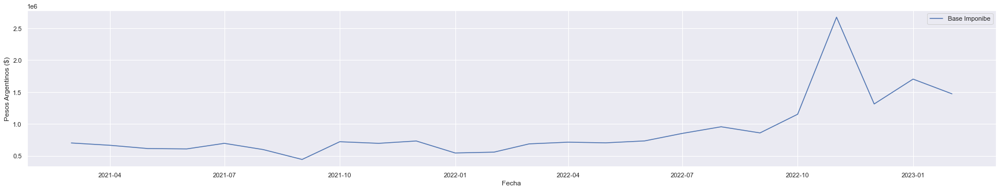

27-17776707-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


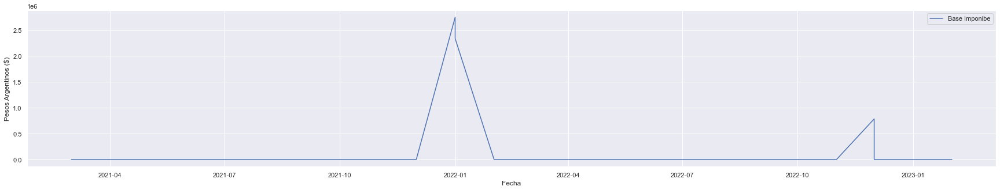

20-13726835-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


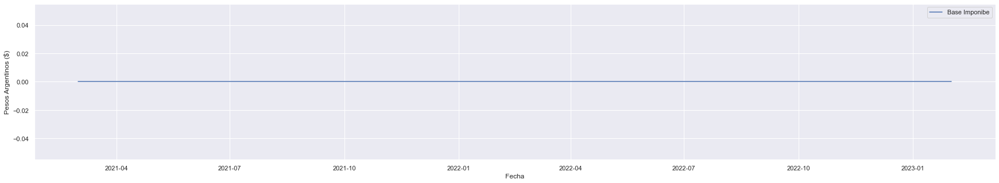

30-71588840-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


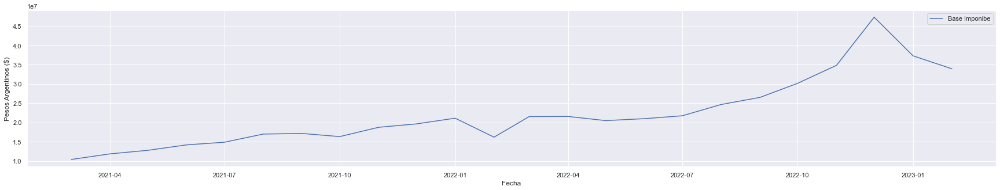

20-94005914-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


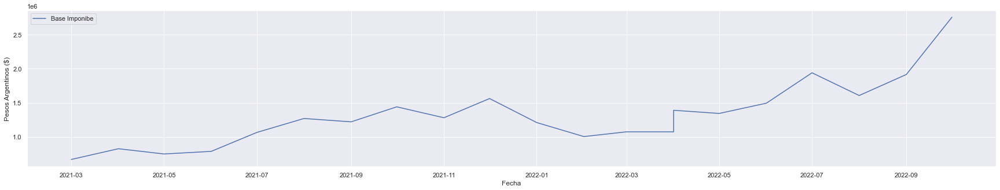

20-25997255-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


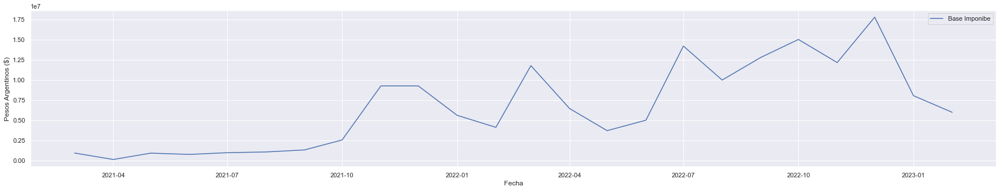

30-71756284-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


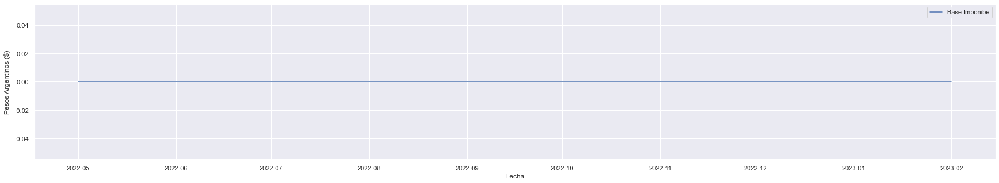

20-95693838-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


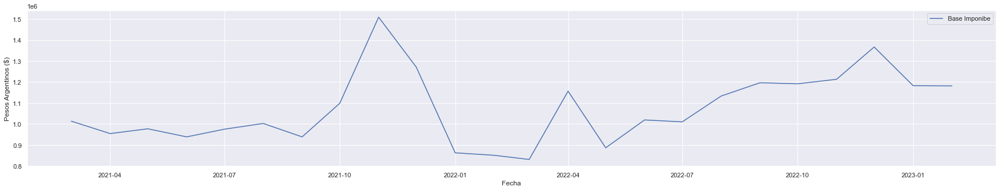

20-95641526-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


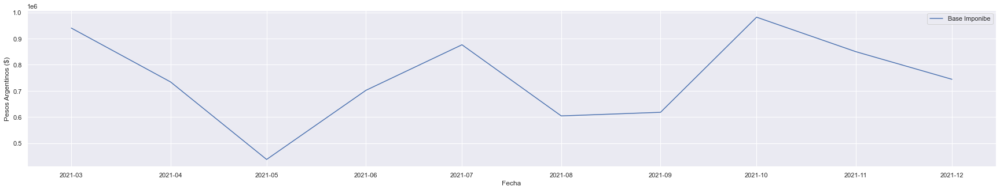

20-95642102-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


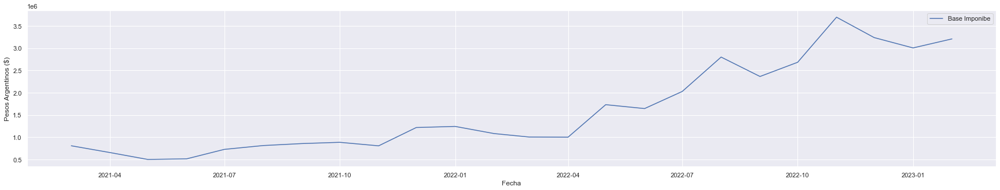

27-12640960-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


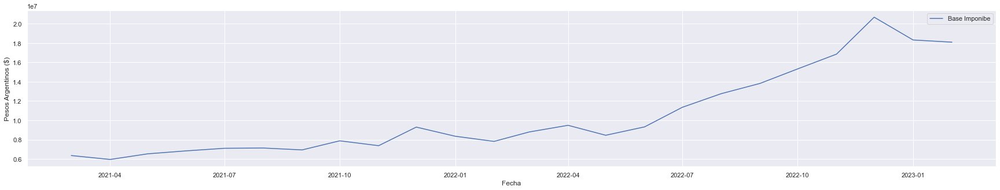

27-94948951-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


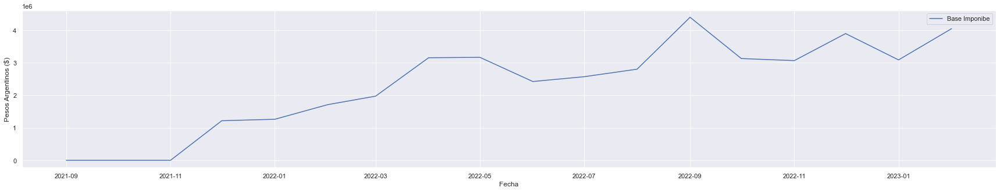

20-38338549-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


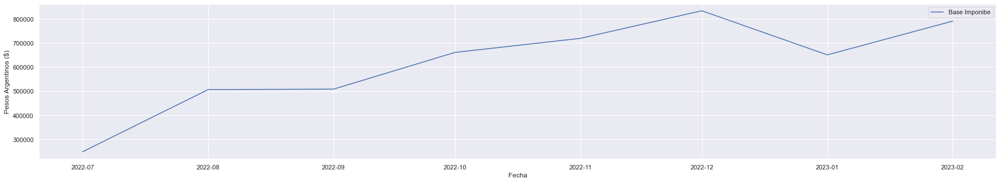

27-05787712-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


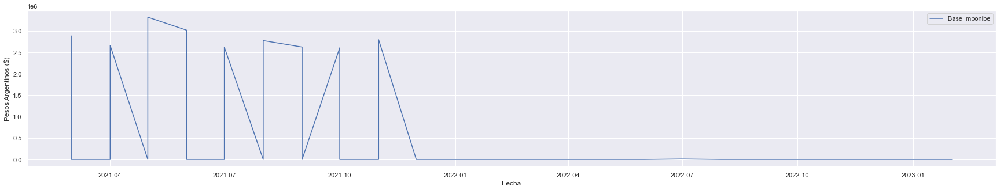

20-18017761-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


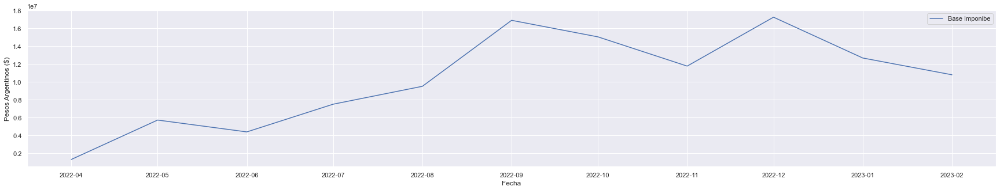

27-14839694-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


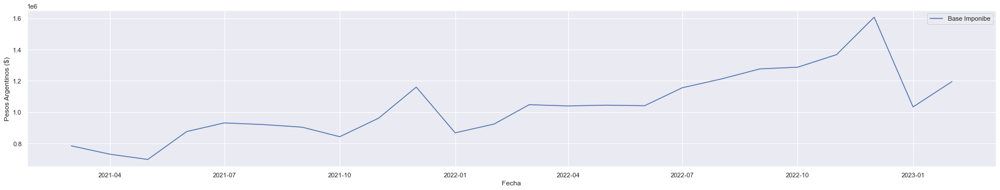

27-94030342-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


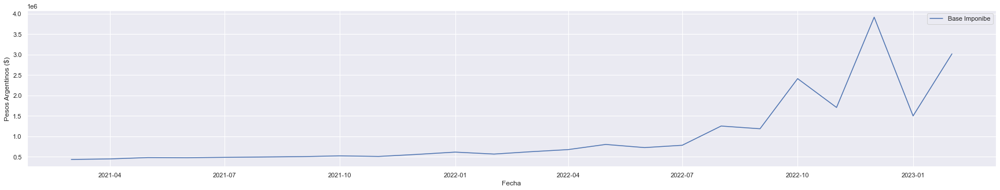

20-94171114-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


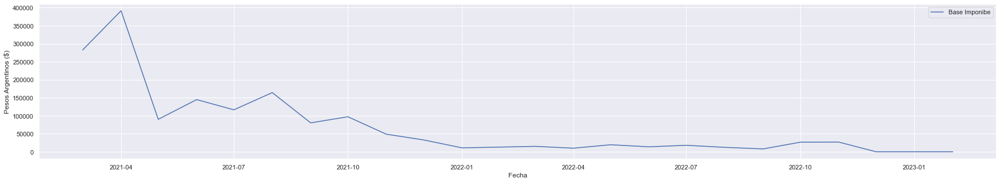

20-18176724-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


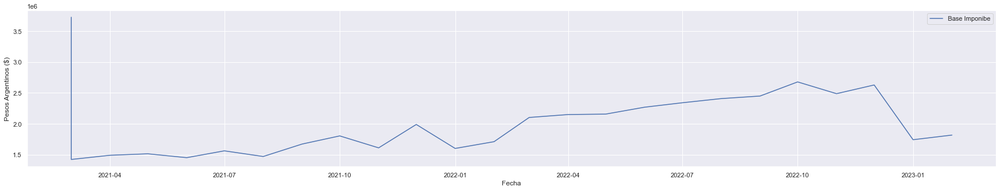

30-71669740-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


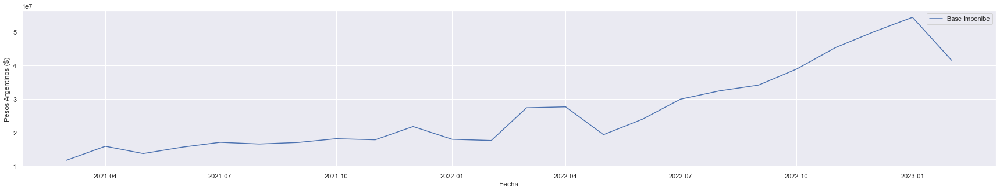

27-95559503-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


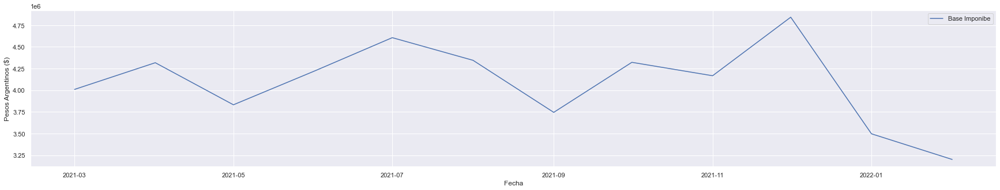

30-71247875-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


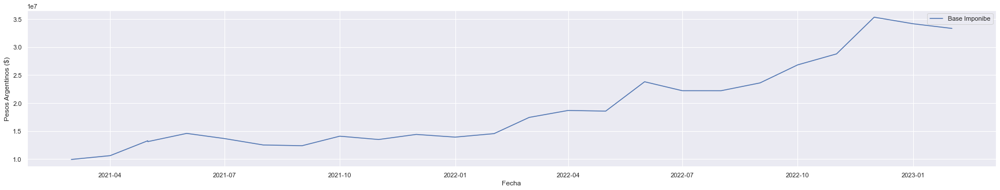

30-61823998-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


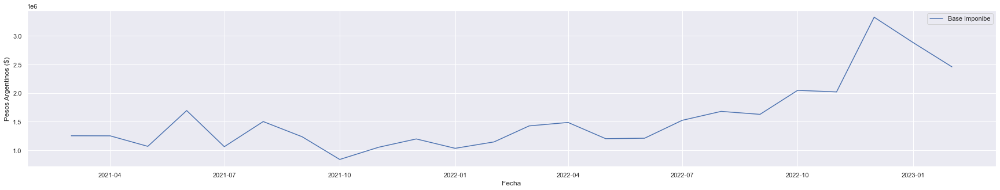

30-71619451-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


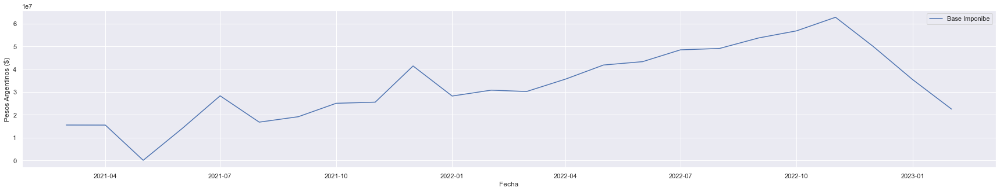

30-71585233-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


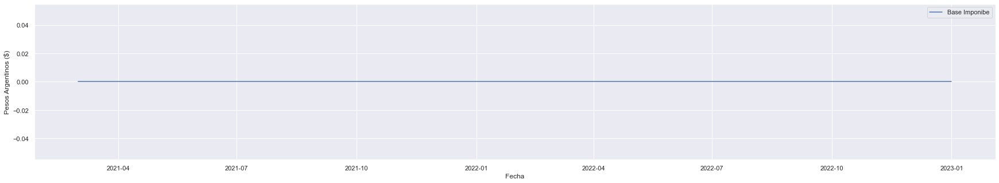

30-71044376-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


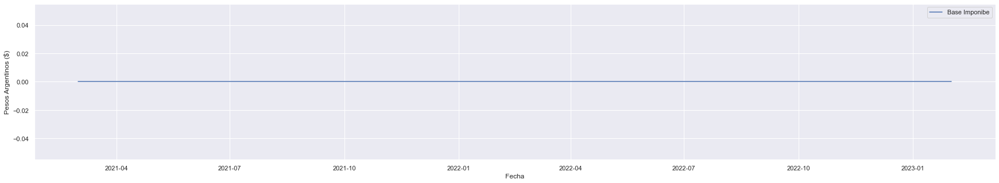

20-11483518-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


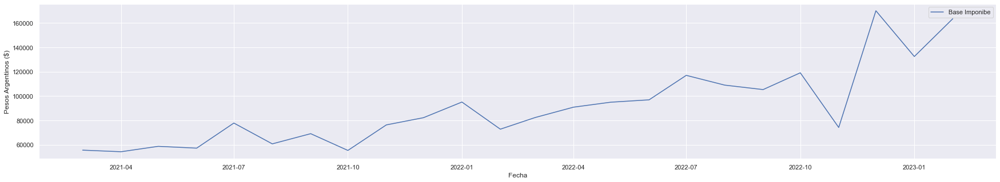

20-95733067-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


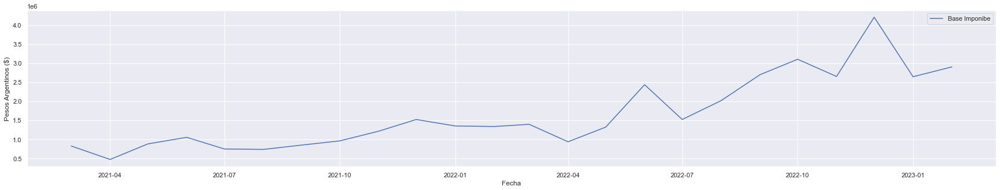

27-94011264-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


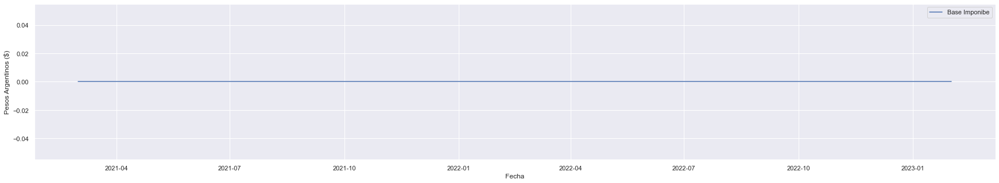

30-71771126-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


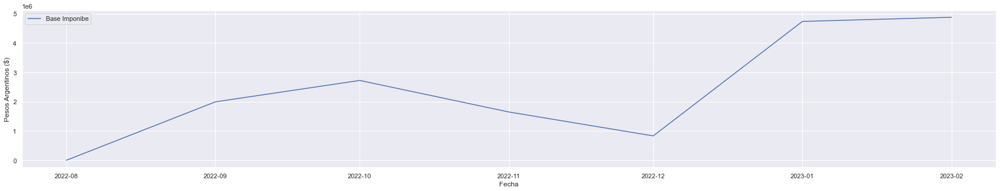

30-71692780-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


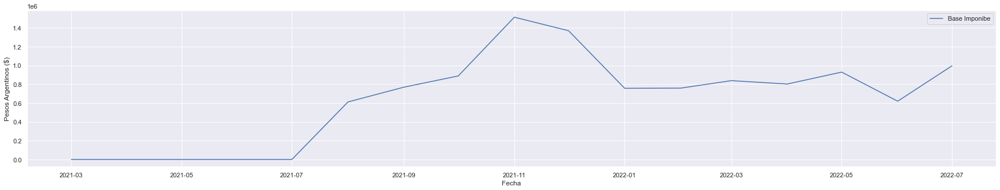

30-71688308-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


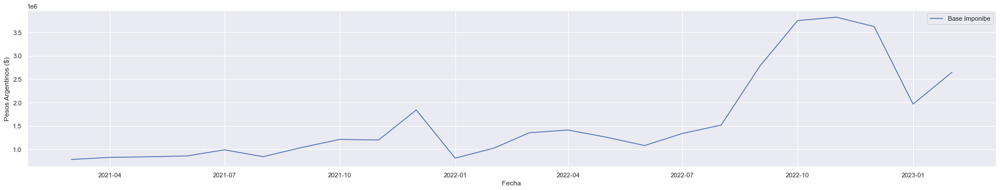

30-71220202-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


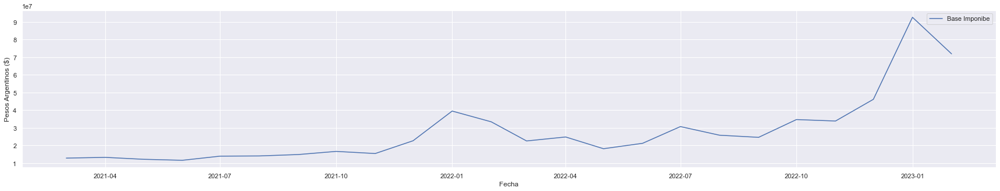

20-25953923-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


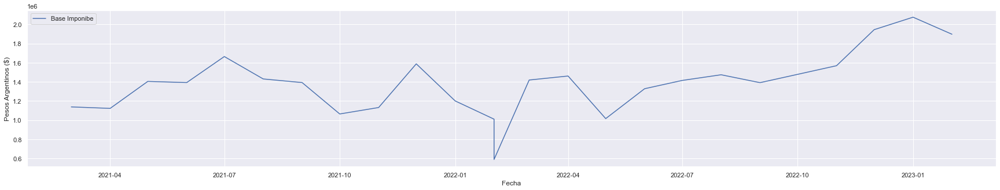

30-71059390-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


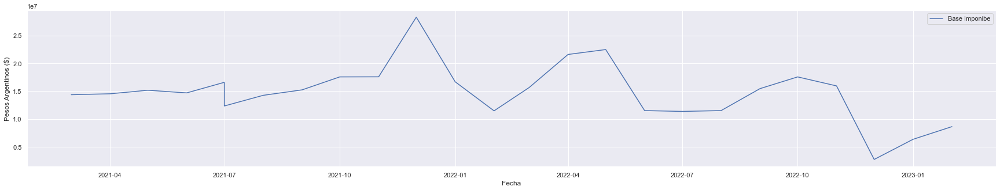

20-94019550-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


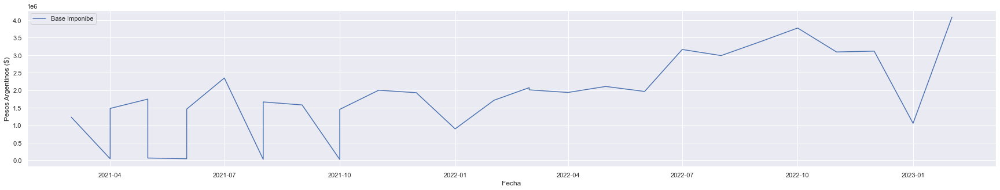

20-32081018-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


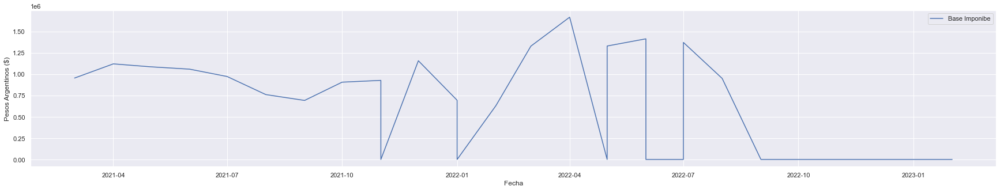

20-12037317-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


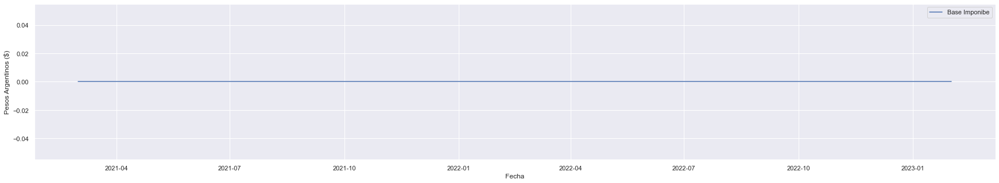

20-94956695-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


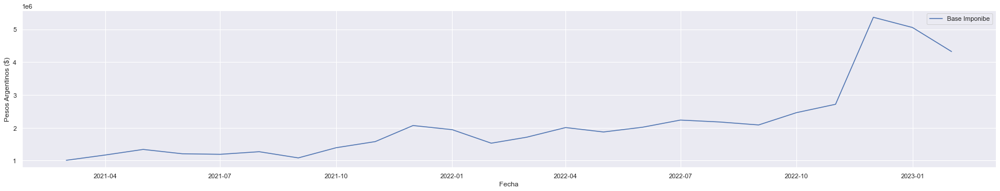

27-95723684-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


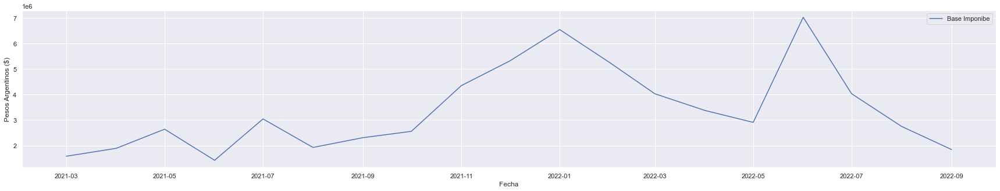

20-17145297-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


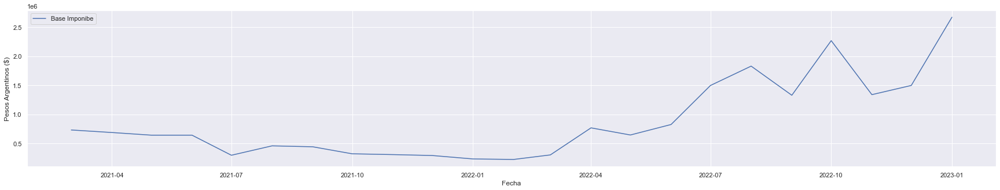

20-95071122-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


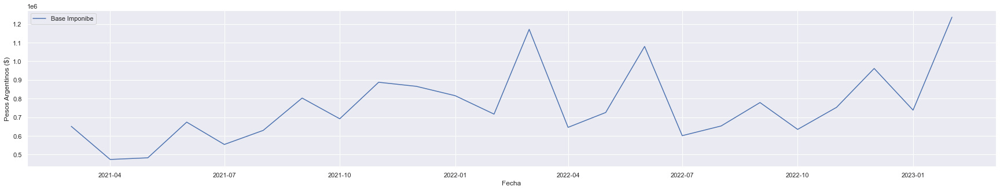

23-94011932-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


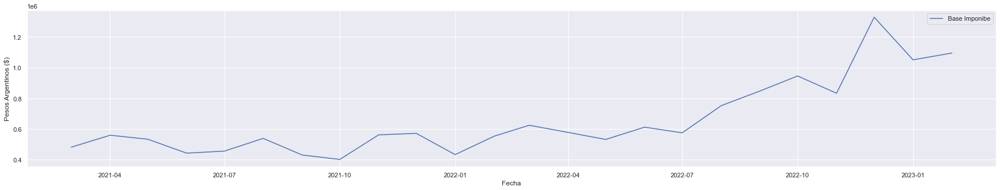

20-11250982-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


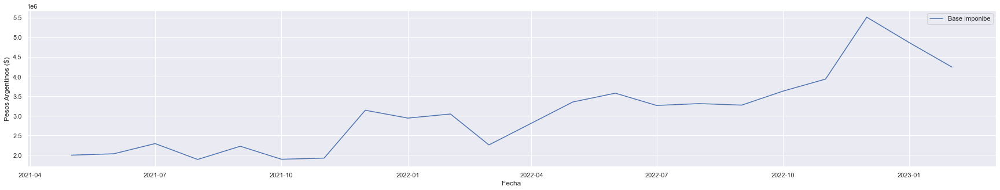

20-20579551-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


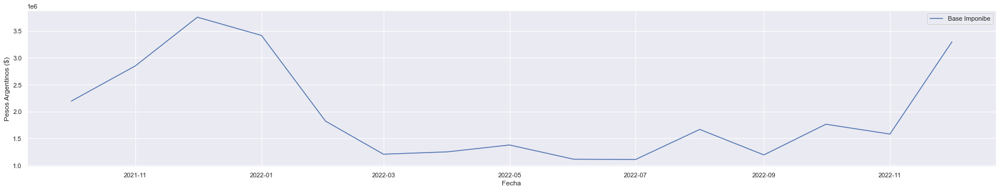

20-17623659-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


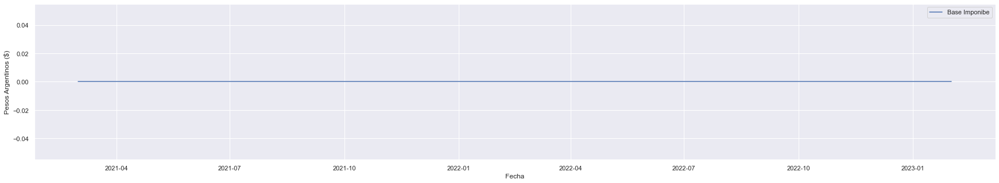

27-95367020-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


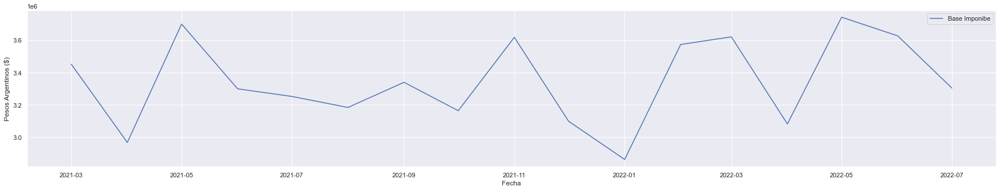

30-71446405-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


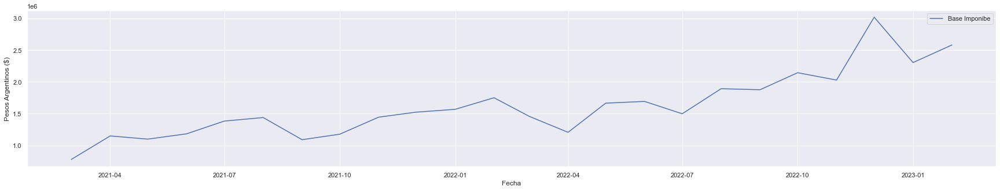

27-94009928-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


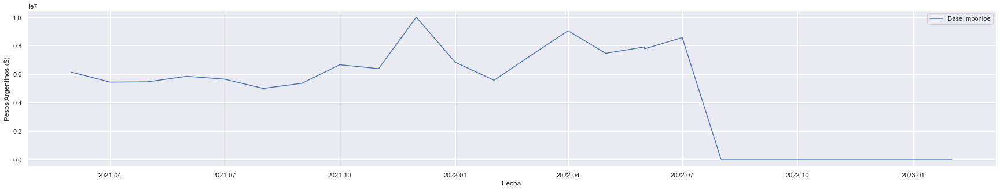

20-95321929-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


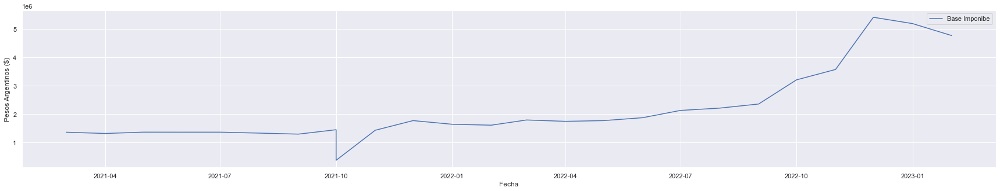

20-94031046-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


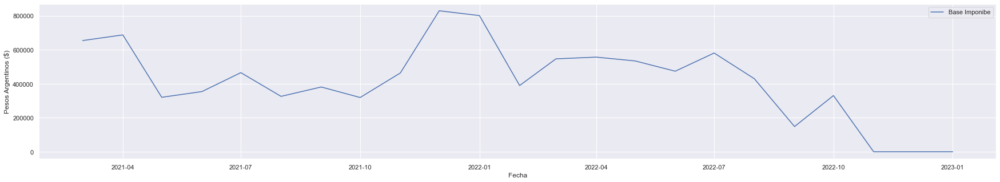

27-93860686-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


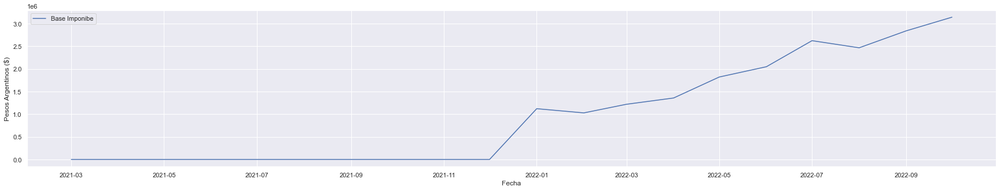

30-71712479-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


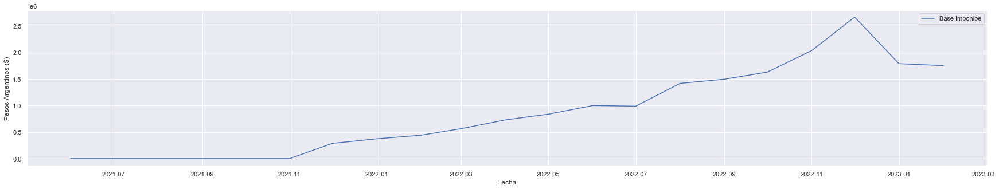

30-71712458-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


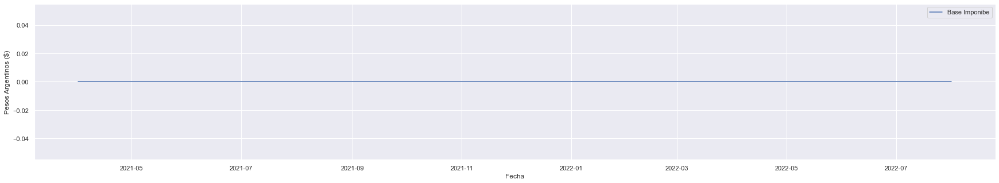

20-25429111-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


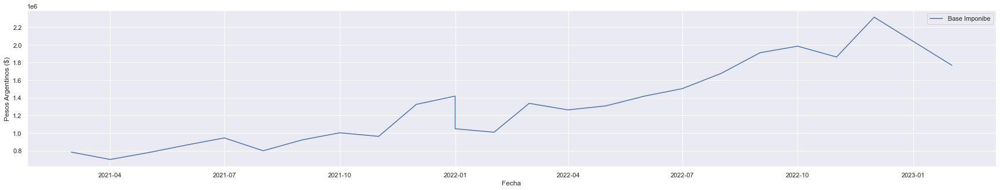

30-66845052-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


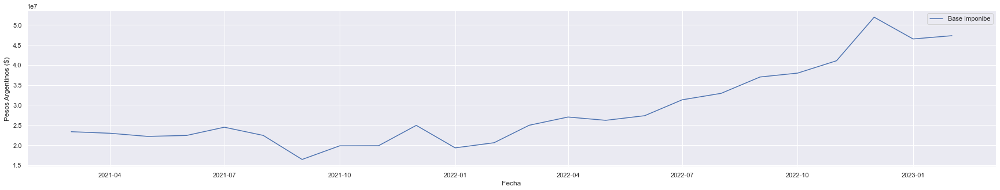

30-71671165-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


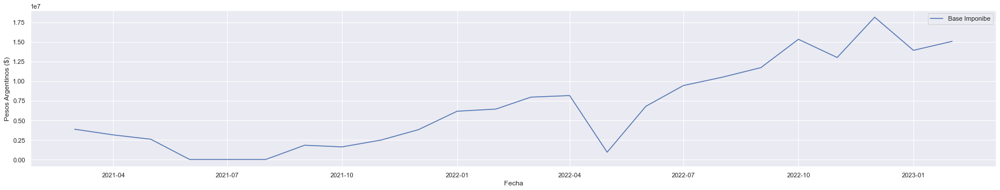

27-94162828-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


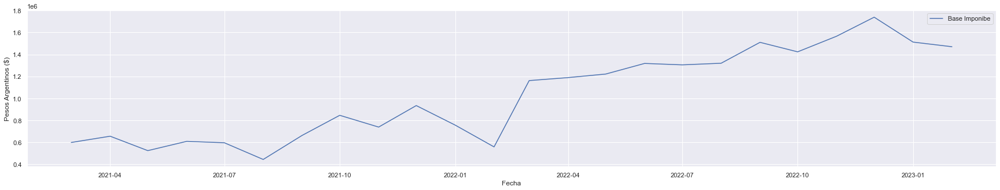

30-66847881-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


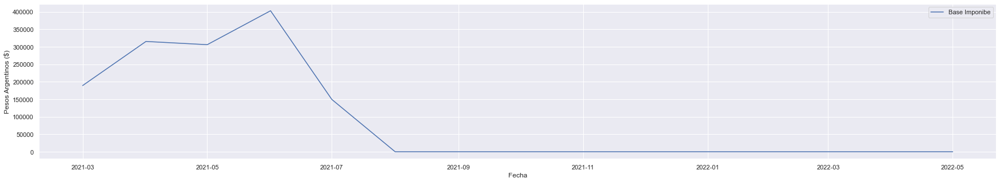

20-27572012-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


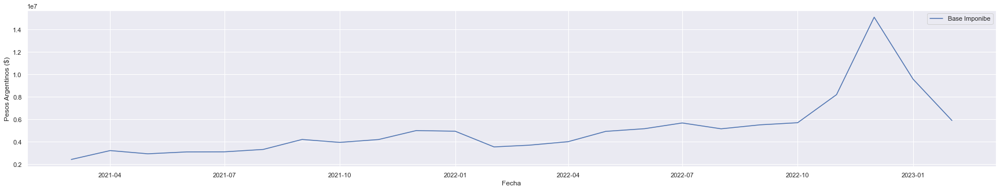

20-23537338-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


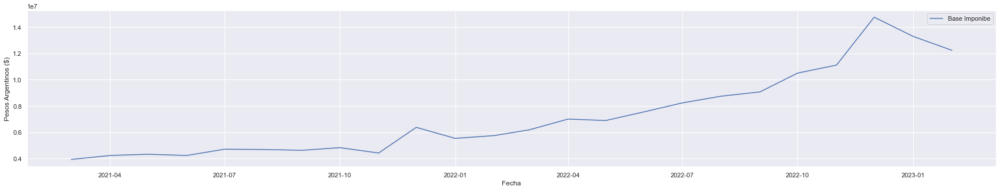

20-25633342-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


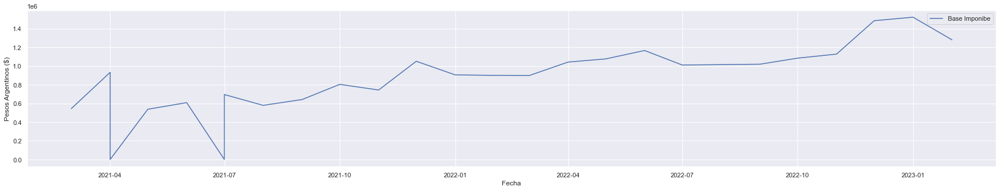

20-08000621-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


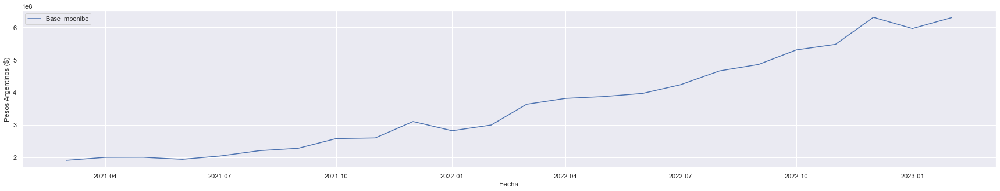

30-71682168-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


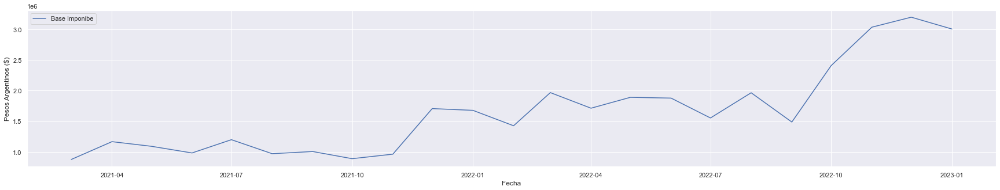

27-95630043-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


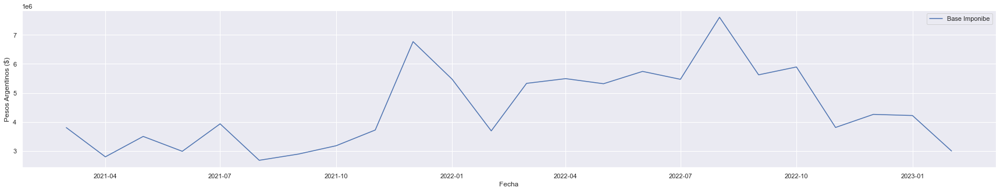

20-08359455-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


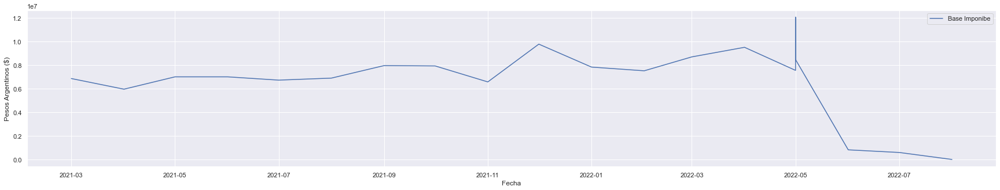

30-71642959-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


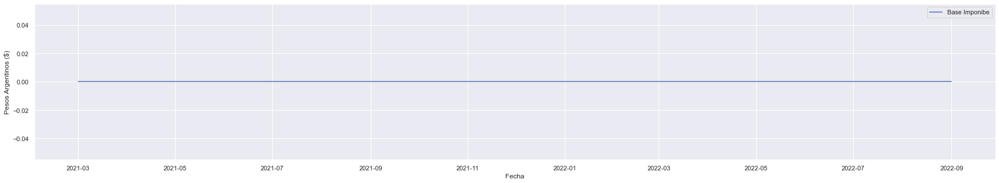

27-06684136-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


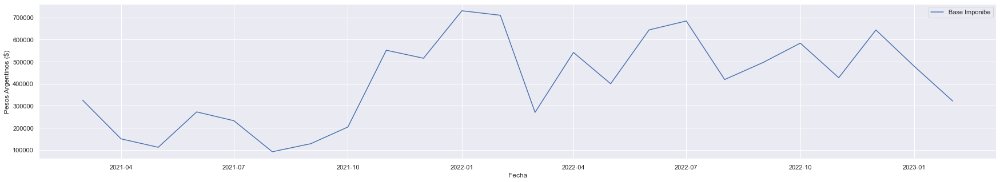

33-71500719-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


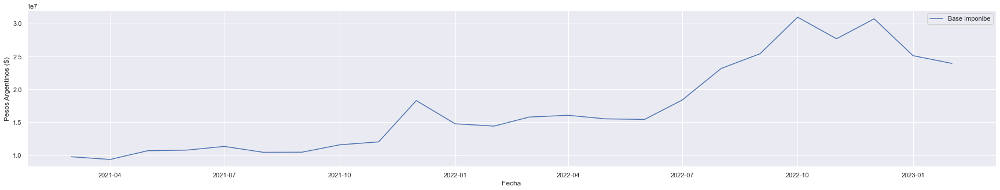

20-96015151-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


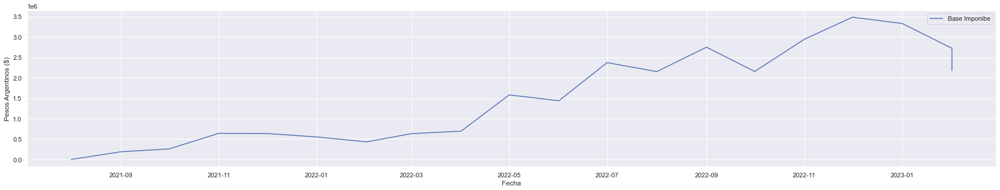

<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


27-21656002-2


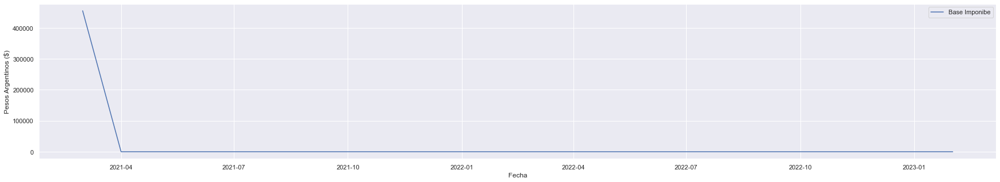

20-62830352-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


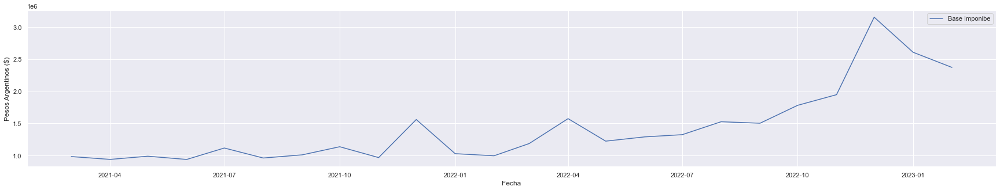

30-71243932-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


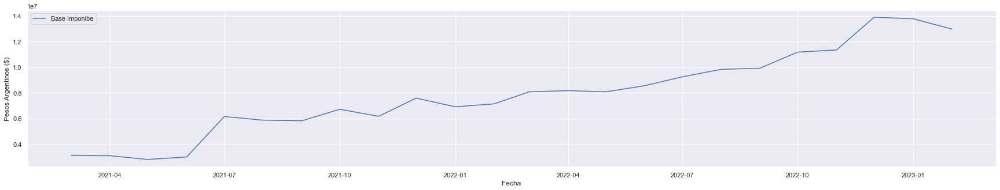

27-21859908-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


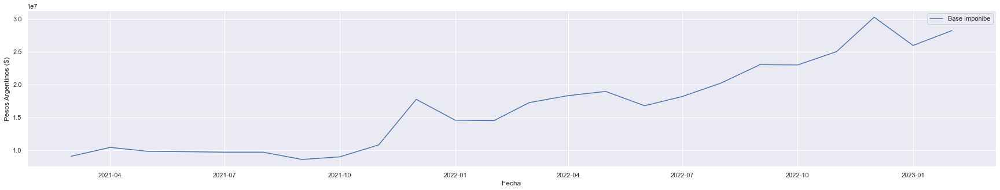

20-95778083-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


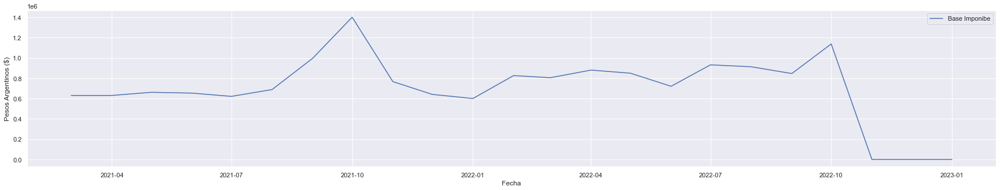

30-71703381-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


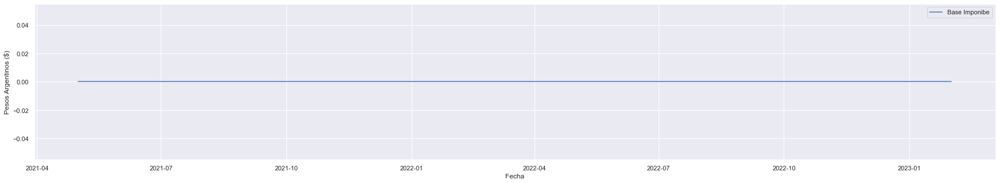

27-94083305-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


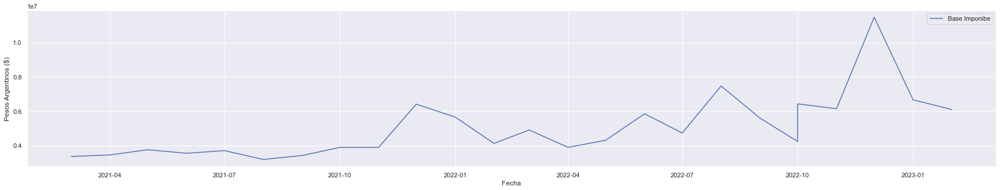

23-41639937-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


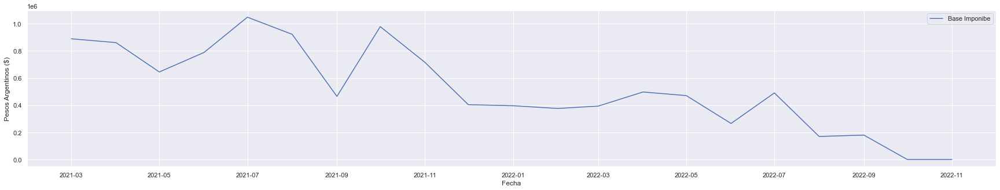

20-34274698-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


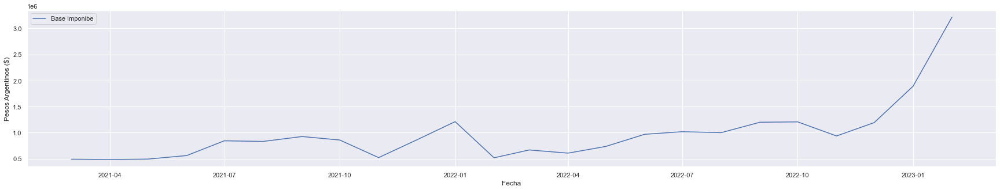

33-71454132-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


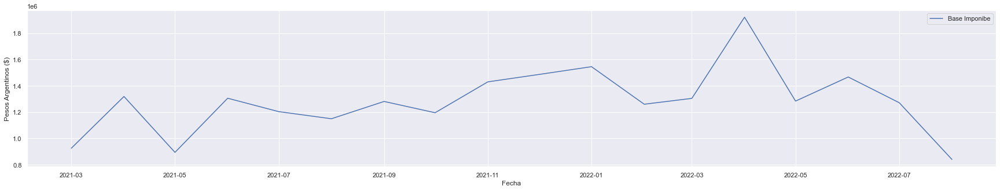

33-71421969-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


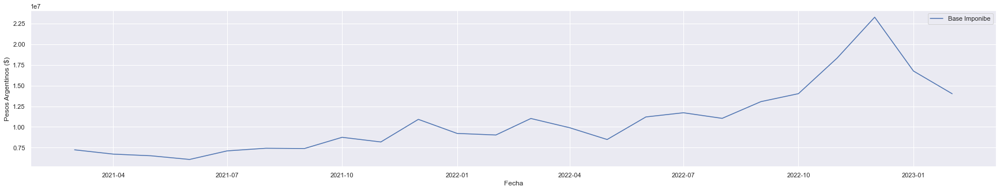

23-60426886-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


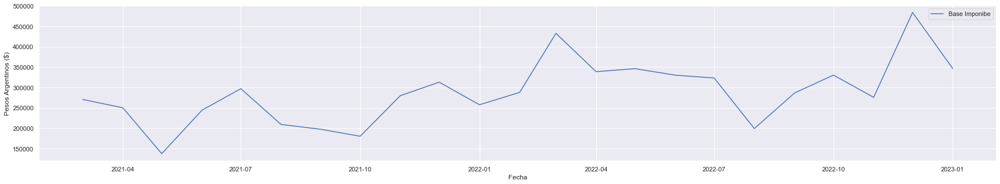

20-94737169-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


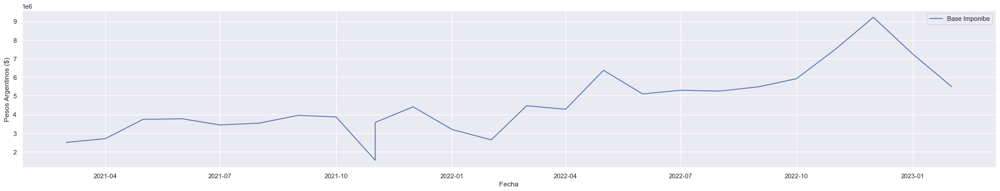

30-71719649-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


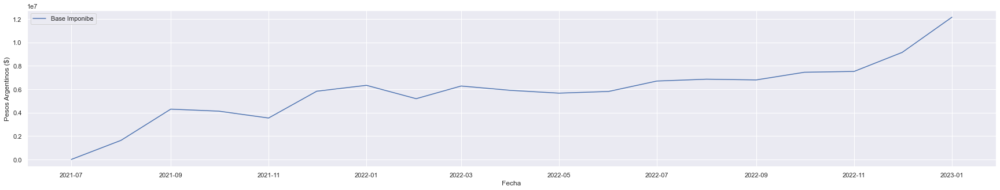

20-96007193-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


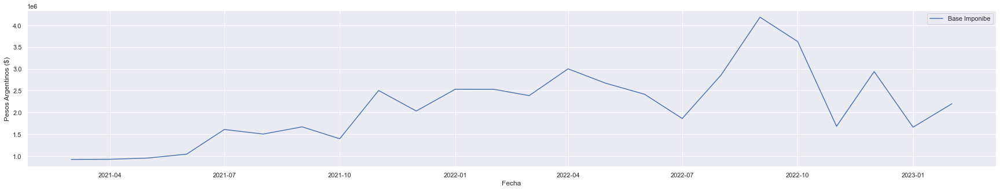

20-95615262-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


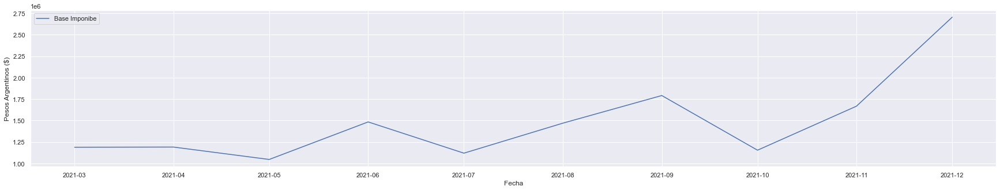

23-94026947-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


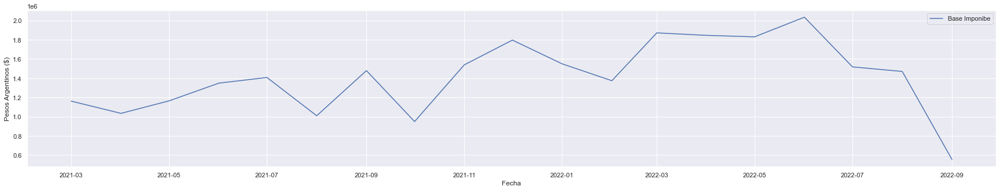

20-06449339-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


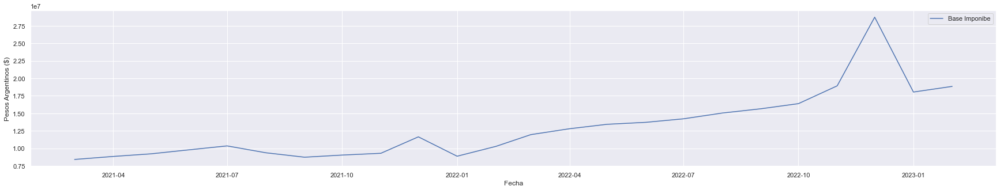

30-71673390-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


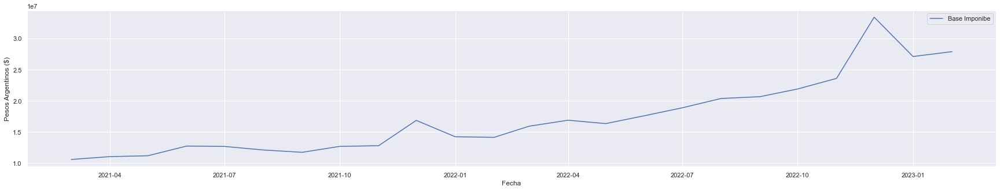

20-17371111-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


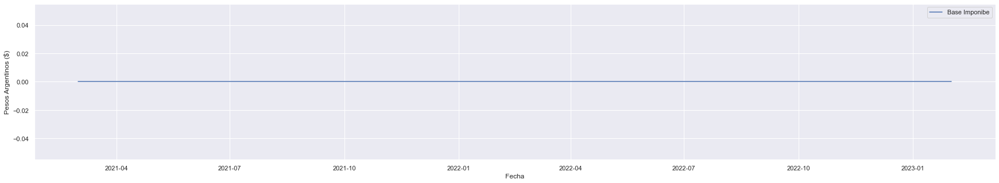

30-71464822-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


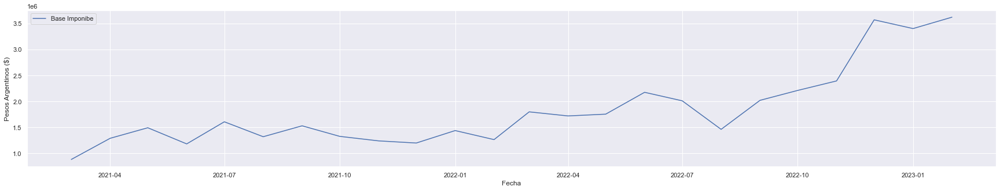

23-95242719-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


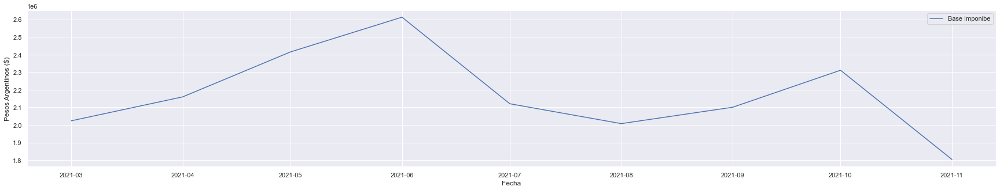

30-70905595-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


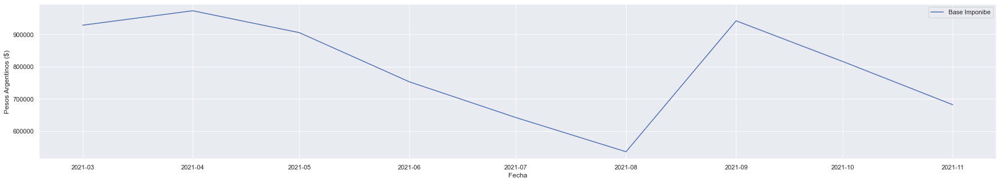

30-71679075-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


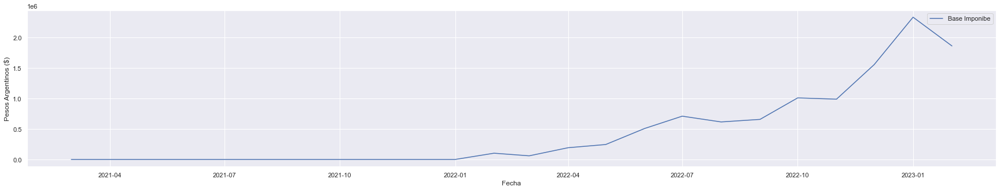

30-71505263-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


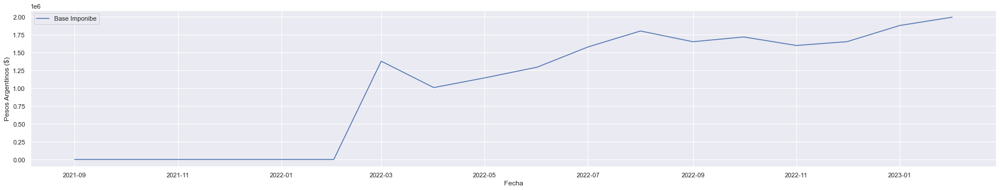

27-95602078-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


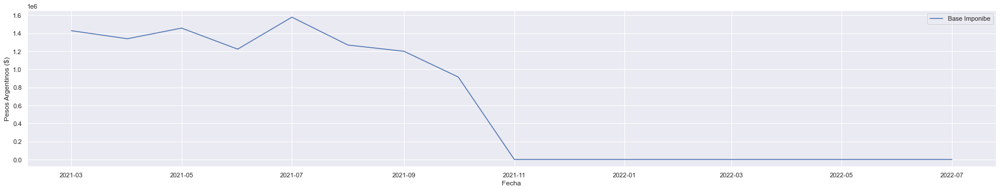

20-33825239-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


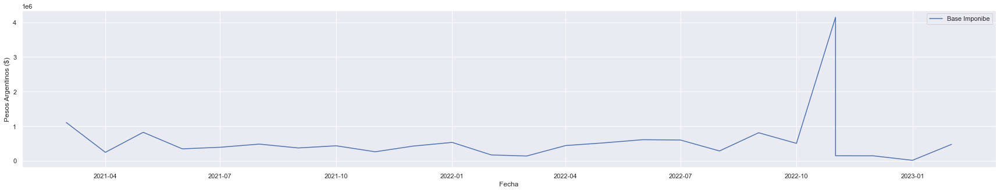

27-94241283-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


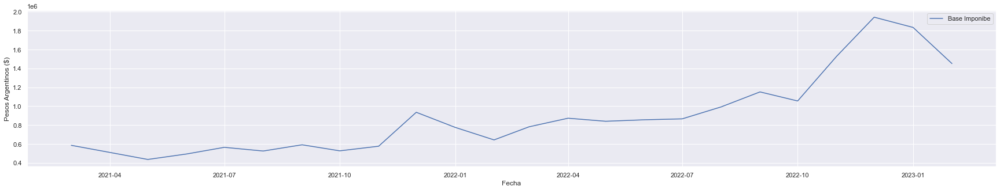

30-71657601-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


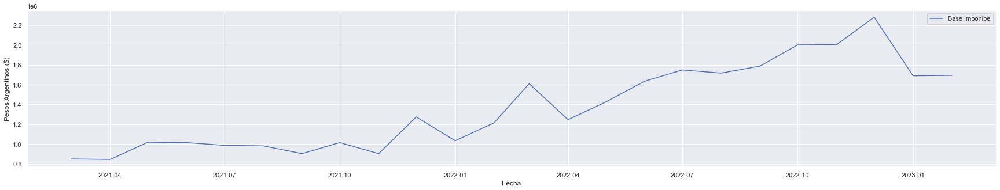

27-31449224-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


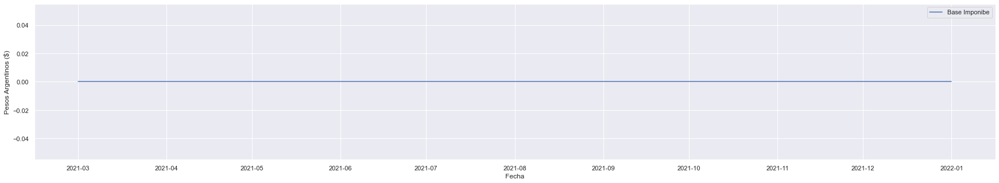

30-71039994-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


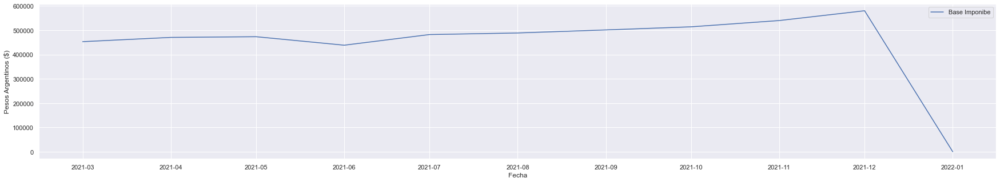

20-94037157-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


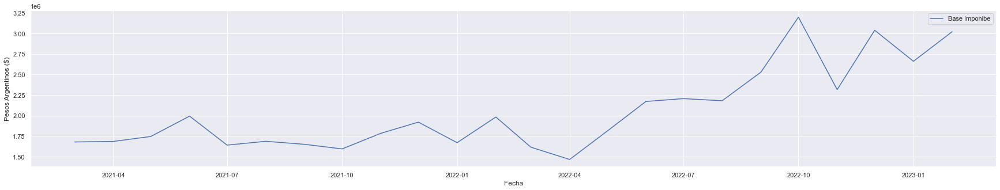

30-61551093-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


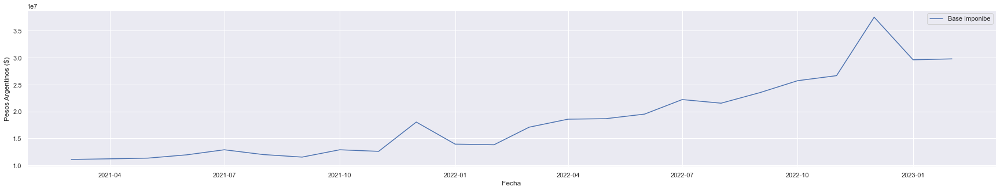

30-71673223-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


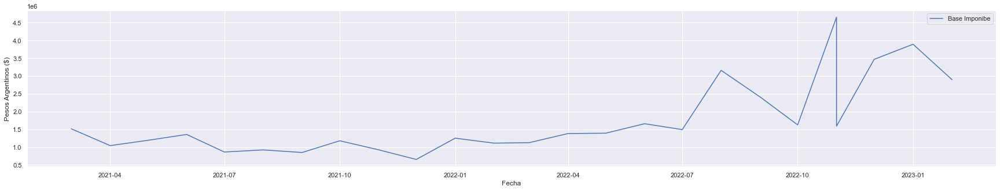

30-71573569-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


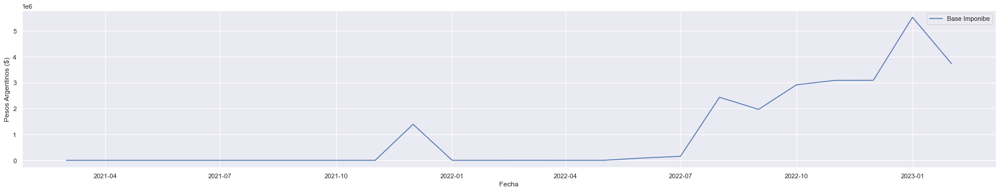

27-26528978-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


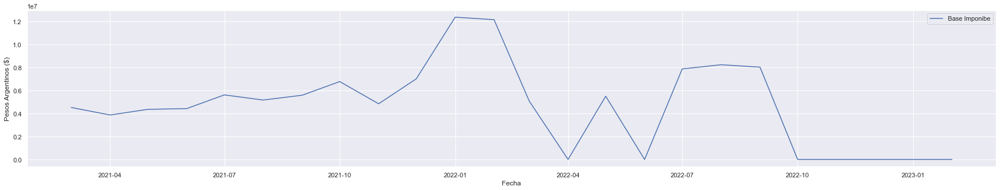

20-05075989-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


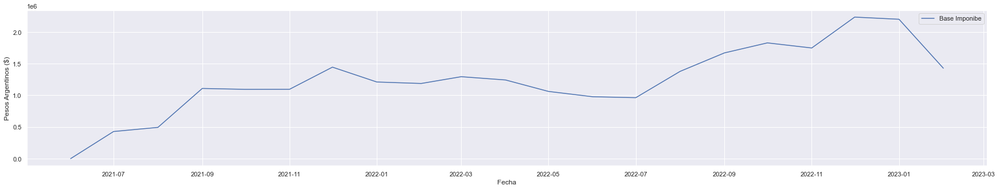

27-32280537-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


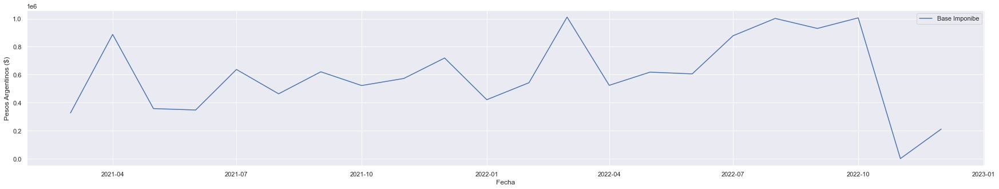

20-22996316-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


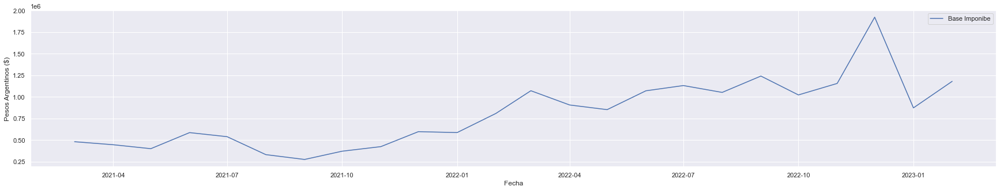

23-24597720-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


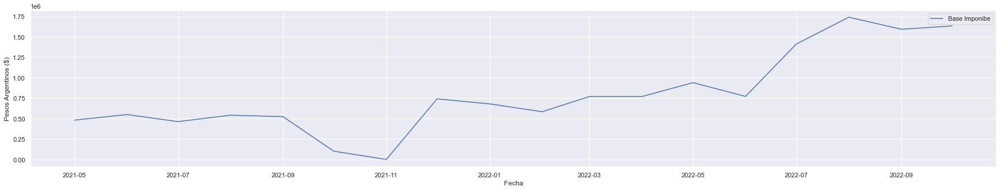

27-94028888-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


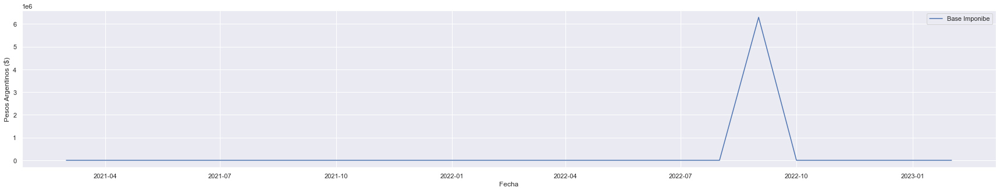

20-95513804-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


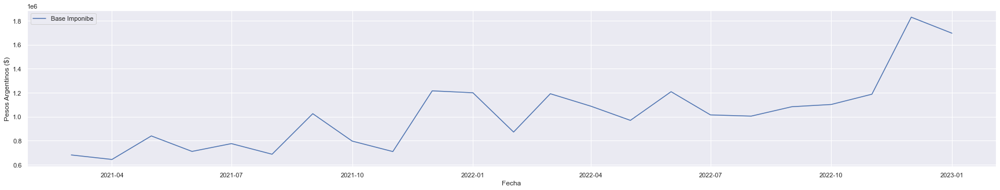

27-94658534-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


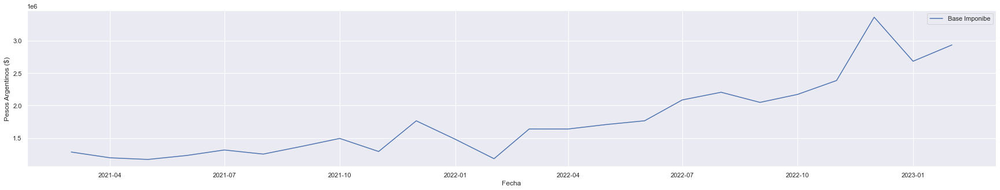

20-94011039-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


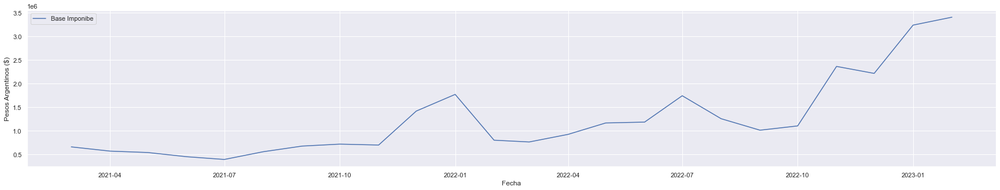

23-94019917-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


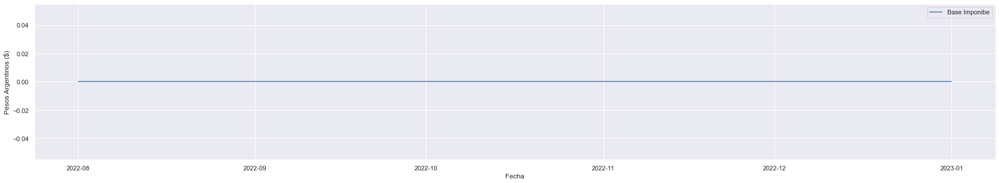

30-71250911-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


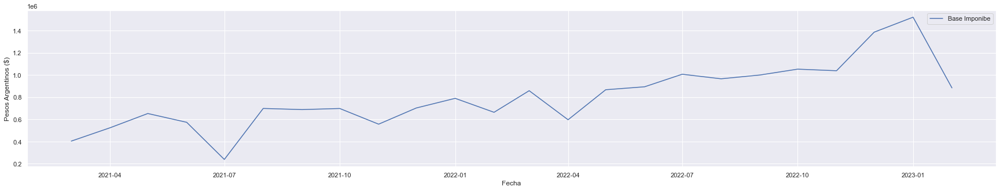

20-94531203-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


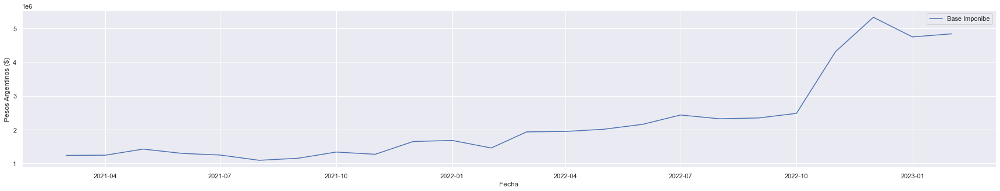

20-23161991-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


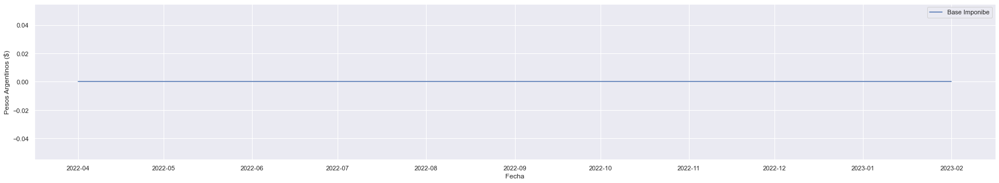

20-95637142-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


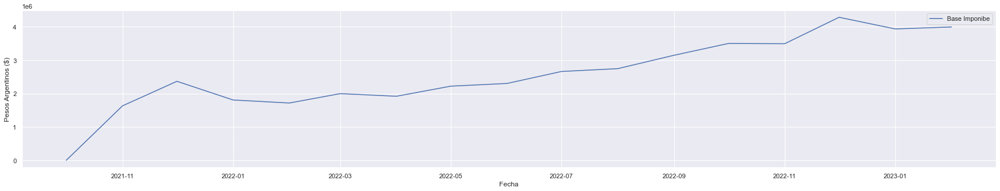

30-70924268-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


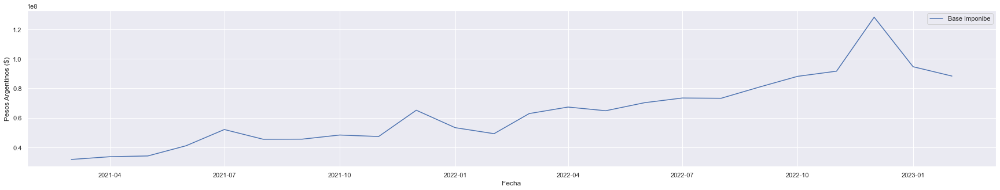

30-71430521-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


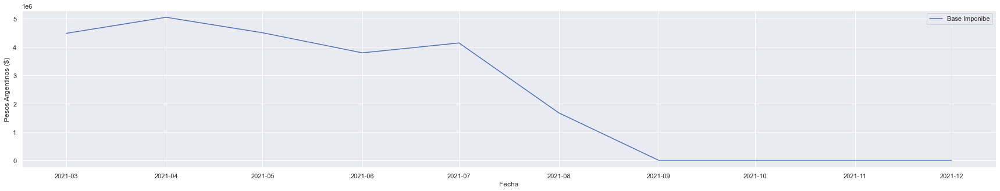

27-94732442-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


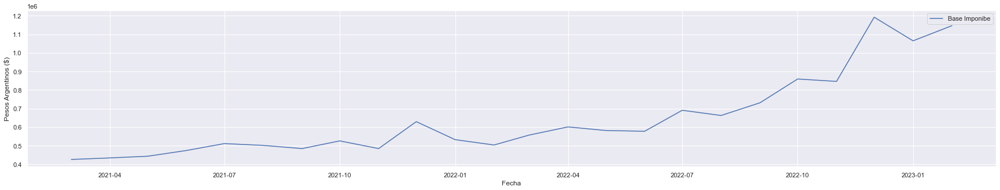

20-18504614-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


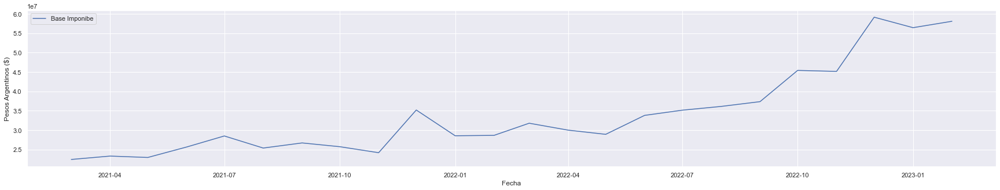

20-93662795-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


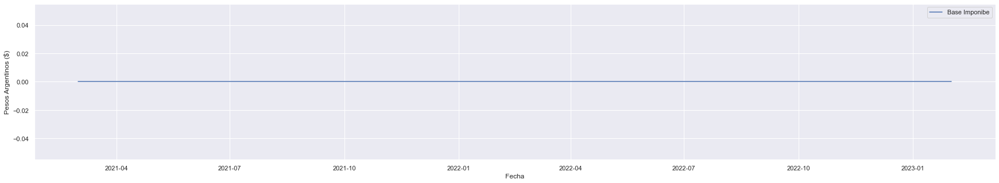

27-12398646-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


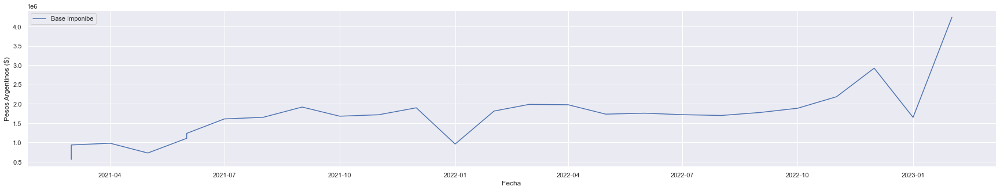

20-95074537-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


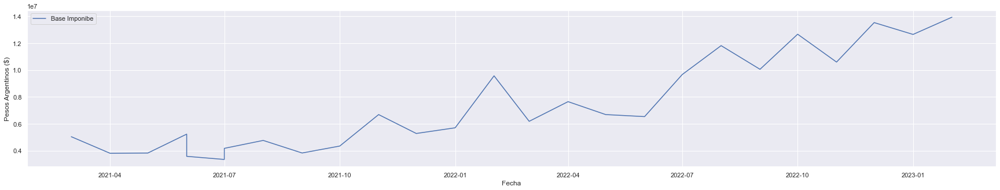

23-95309265-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


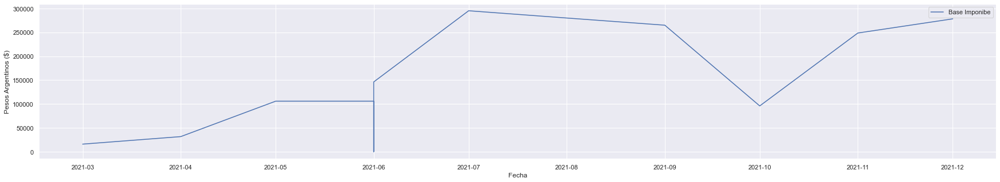

20-08116889-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


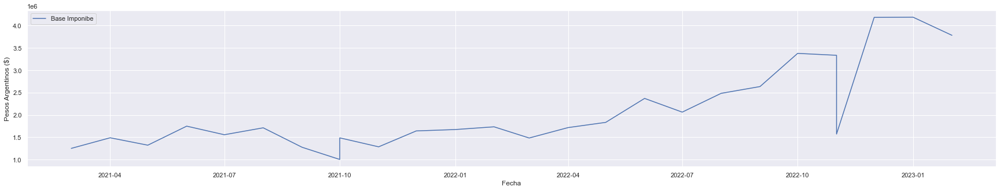

20-95269781-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


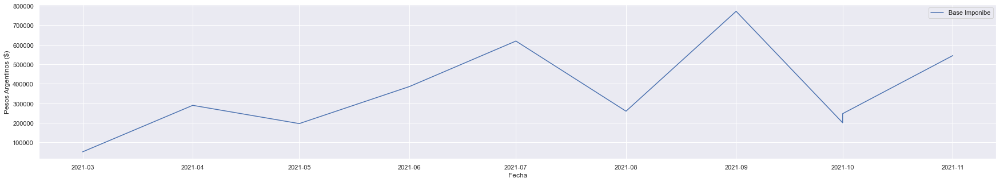

20-16151193-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


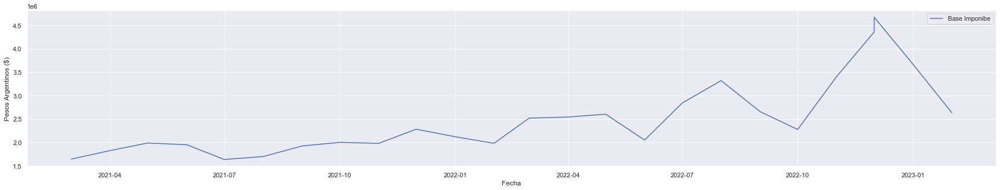

23-94482466-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


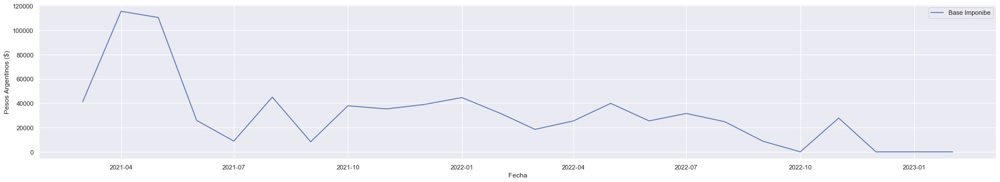

27-28198141-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


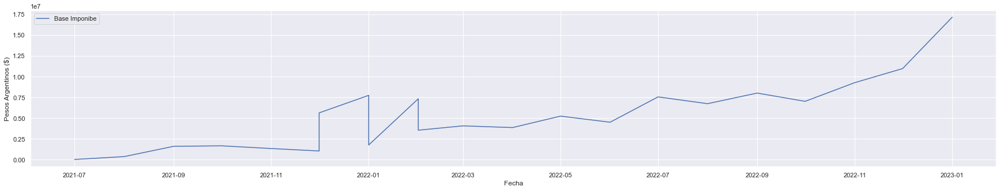

27-94556307-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


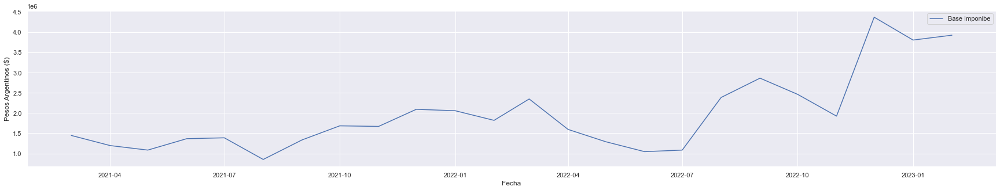

30-71470707-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


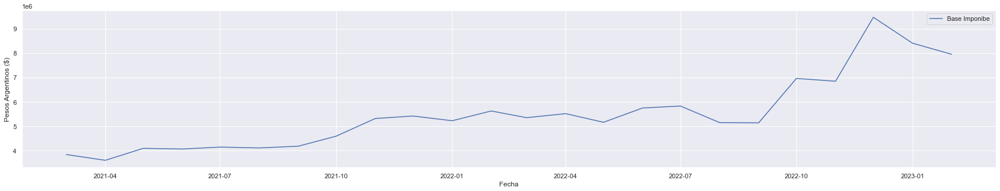

27-10553372-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


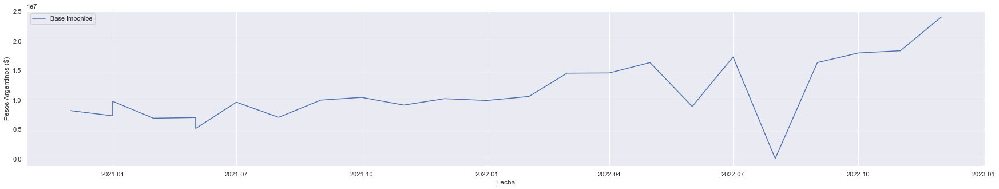

30-71082071-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


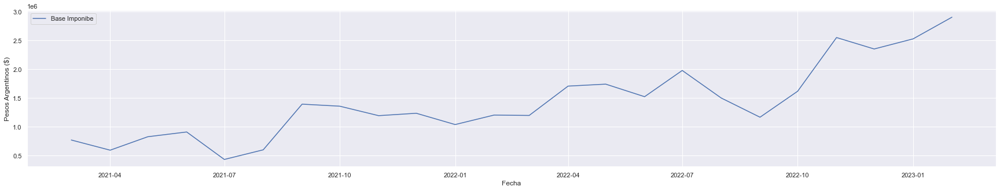

20-24149926-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


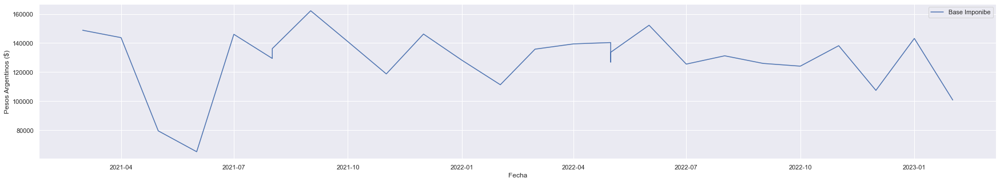

27-95580033-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


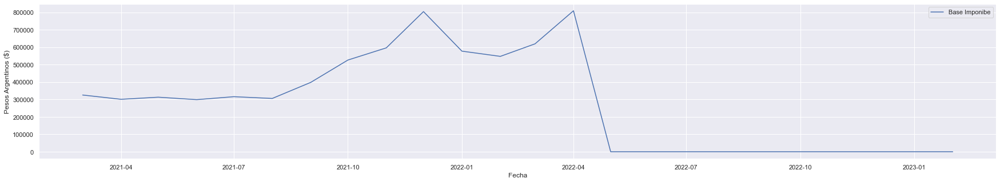

20-22865576-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


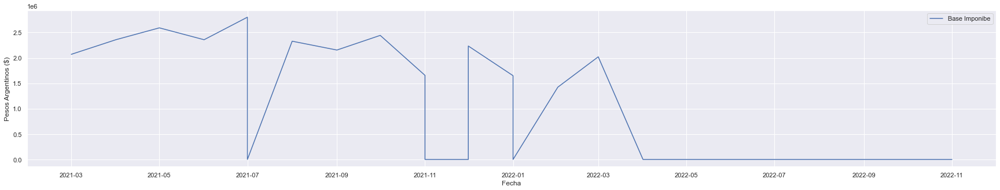

30-70914045-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


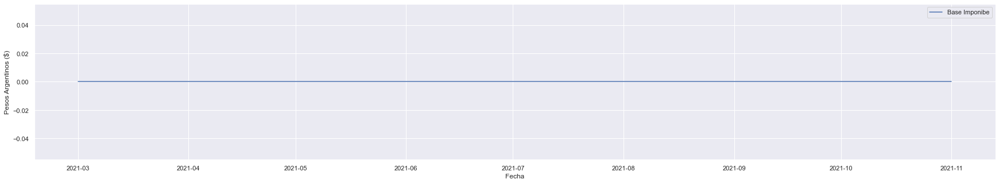

20-95169265-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


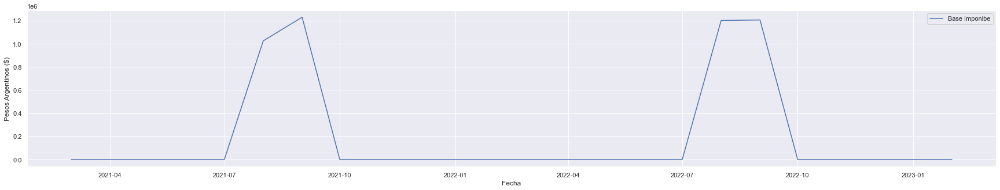

27-94720736-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


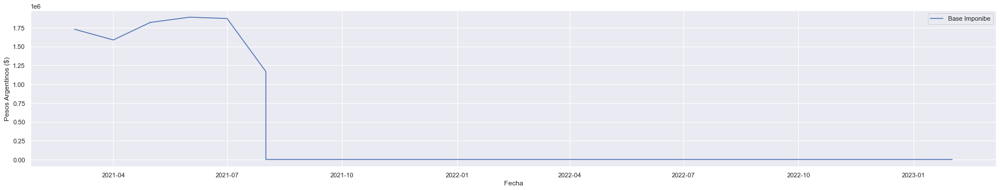

27-95362700-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


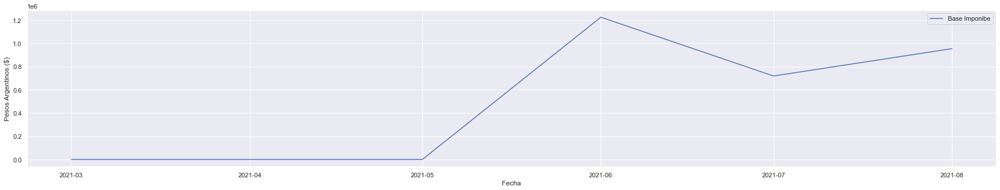

23-11483523-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


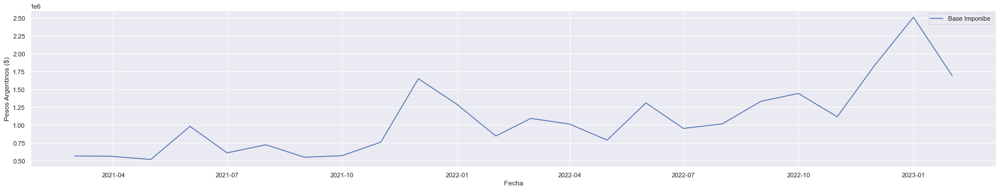

20-95731473-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


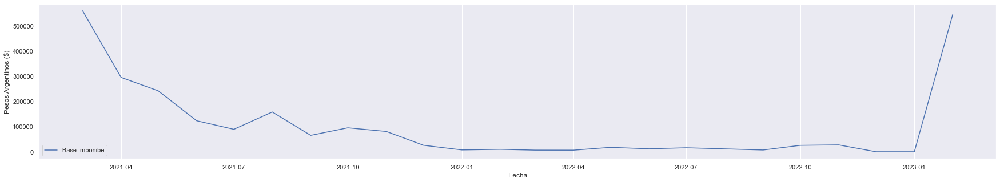

30-71627558-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


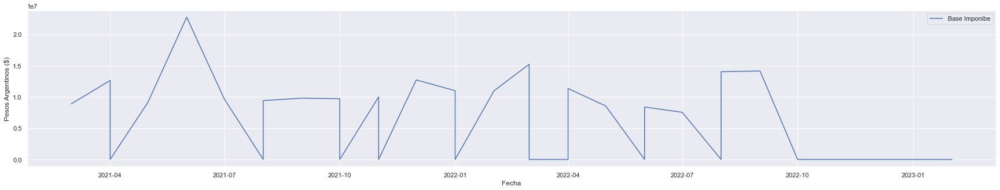

30-71682090-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


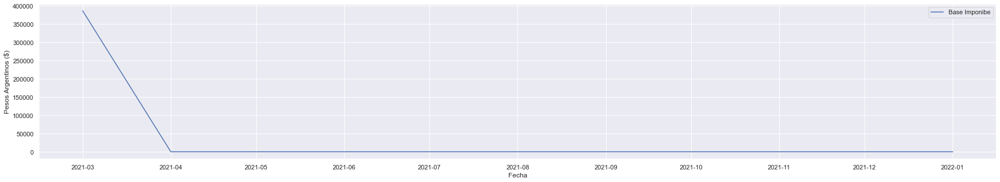

20-06430824-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


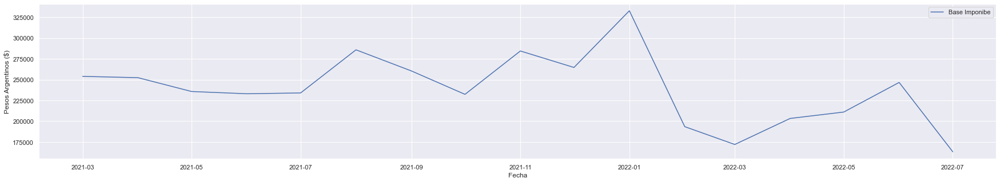

33-71580183-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


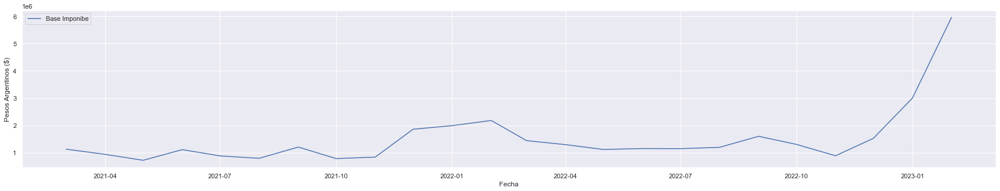

20-34372908-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


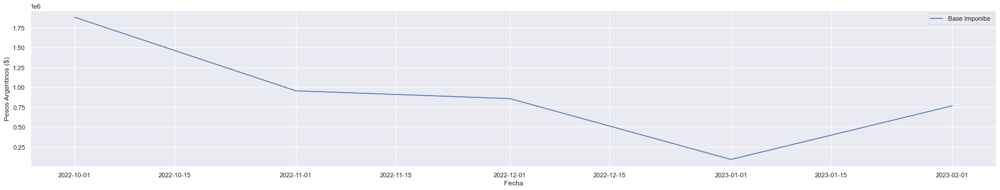

27-94012900-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


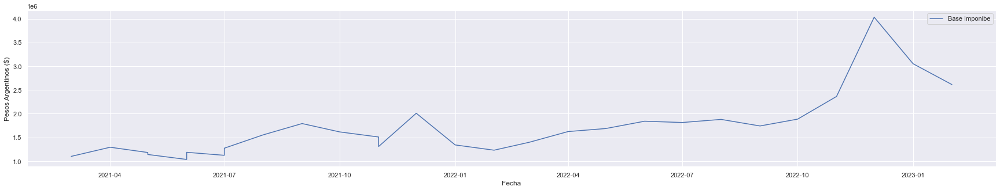

30-70935363-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


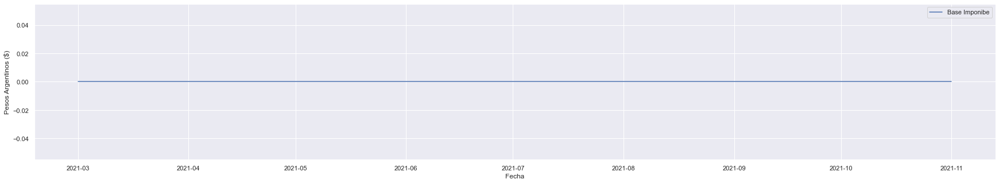

30-71404116-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


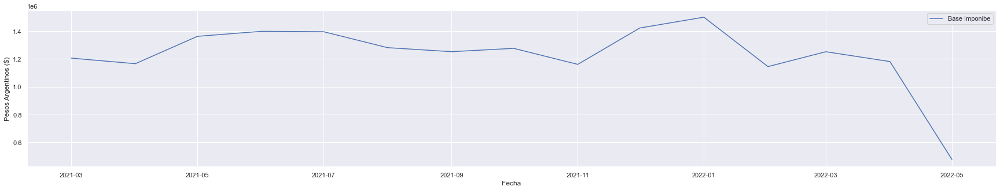

30-71638013-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


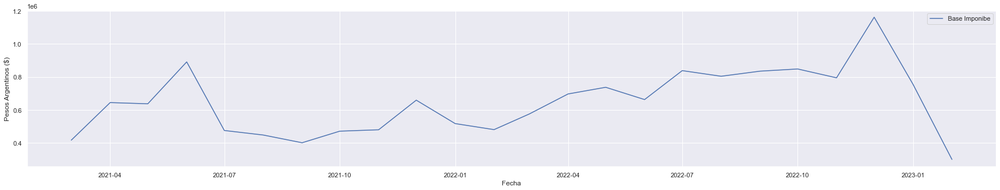

20-95613373-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


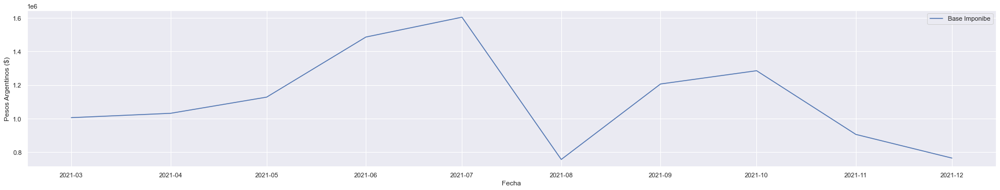

20-27096013-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


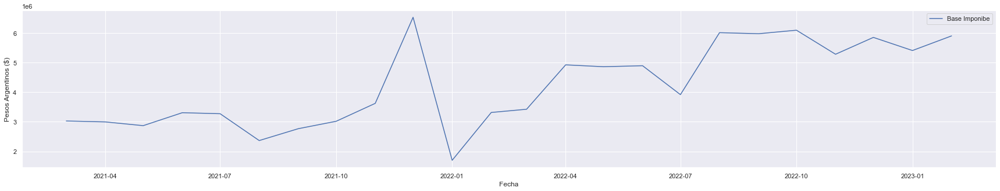

30-71696948-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


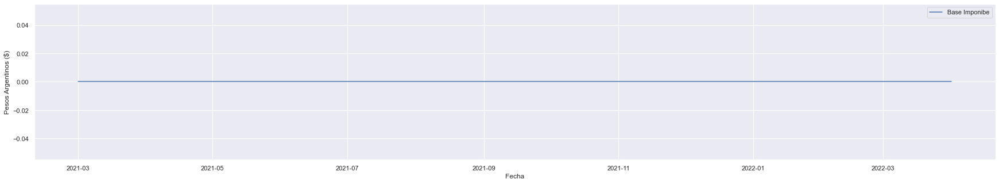

30-71717556-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


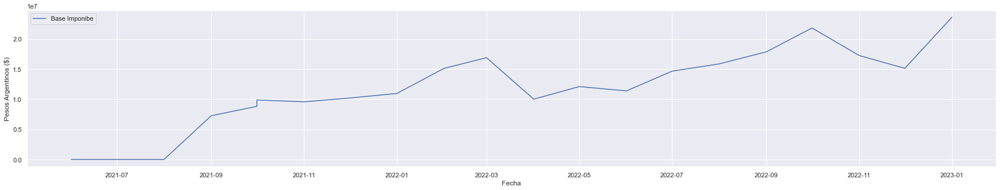

20-27880256-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


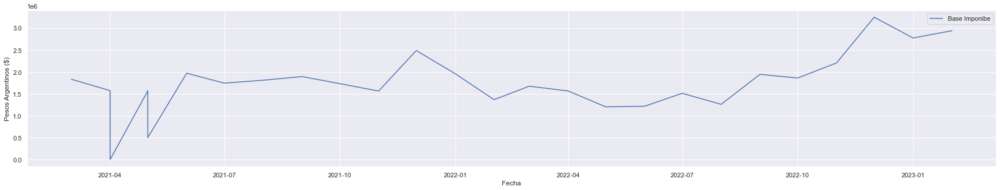

23-17490205-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


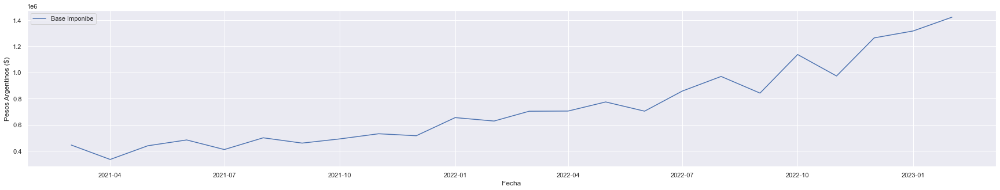

20-95599825-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


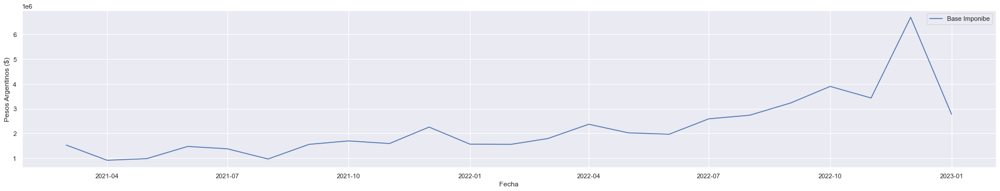

27-94778833-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


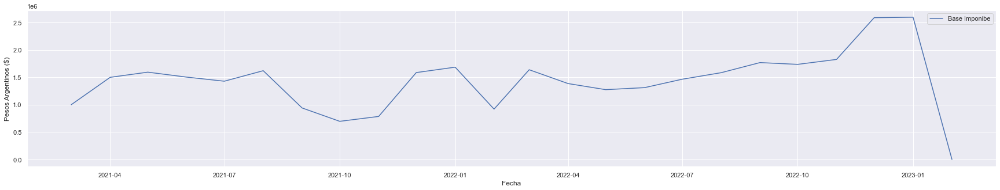

27-95485824-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


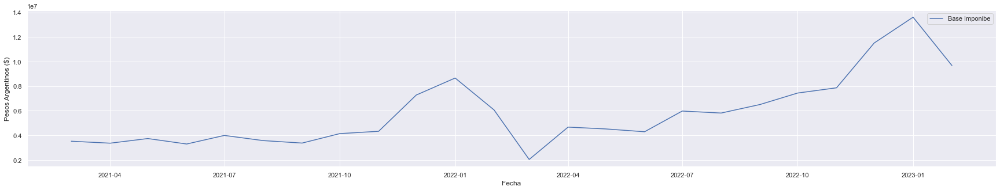

27-10521586-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


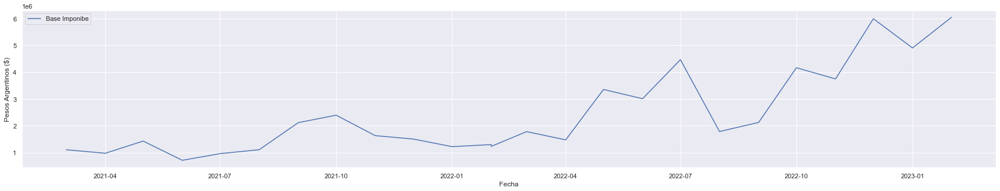

20-94037406-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


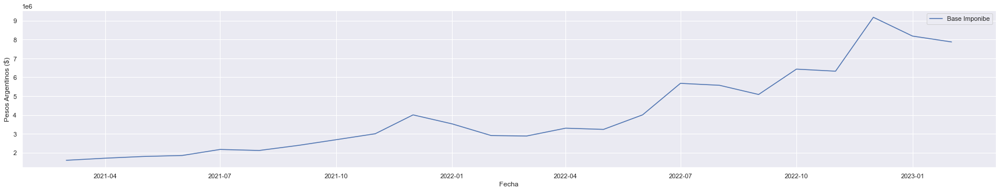

20-96019405-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


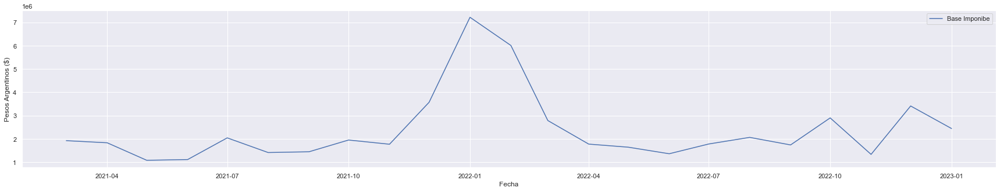

30-71633520-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


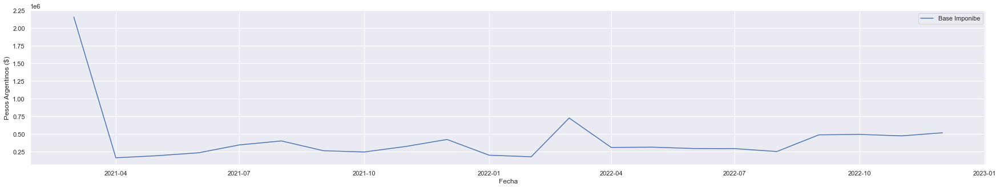

27-95804165-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


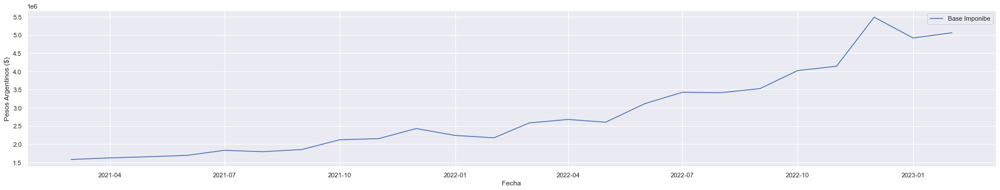

30-71740638-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


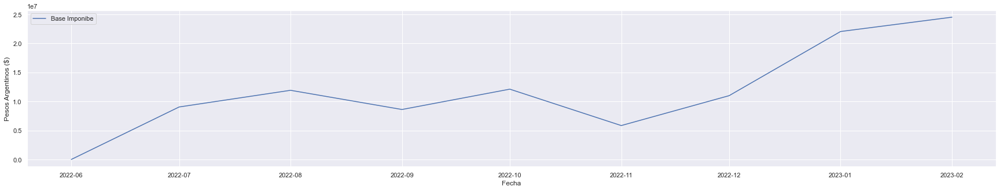

33-71414343-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


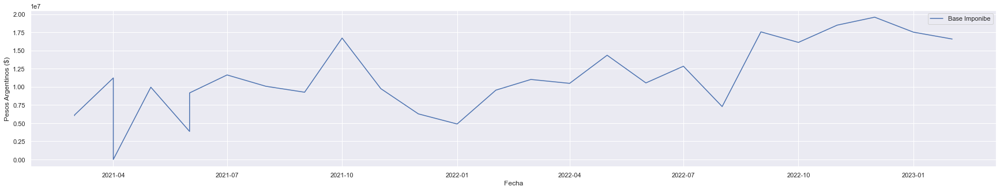

20-96117159-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


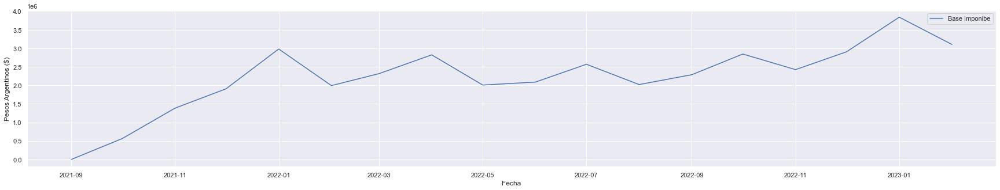

30-71619392-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


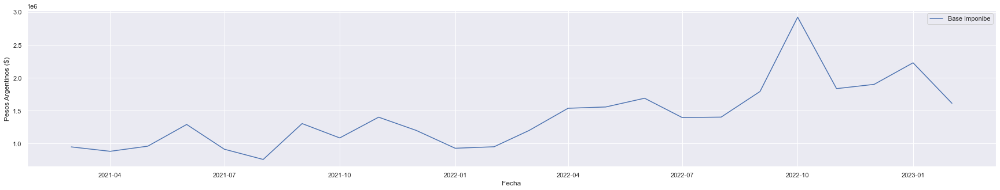

20-94052987-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


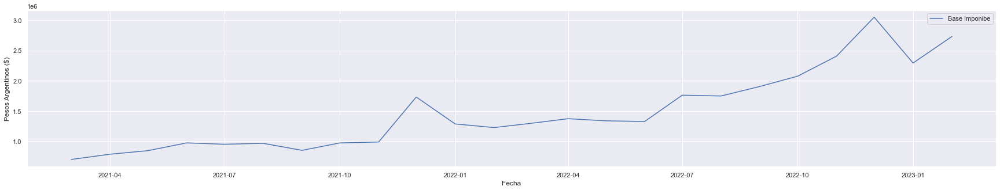

20-94068741-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


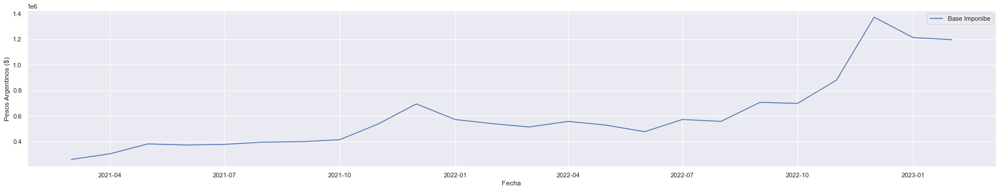

20-21778856-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


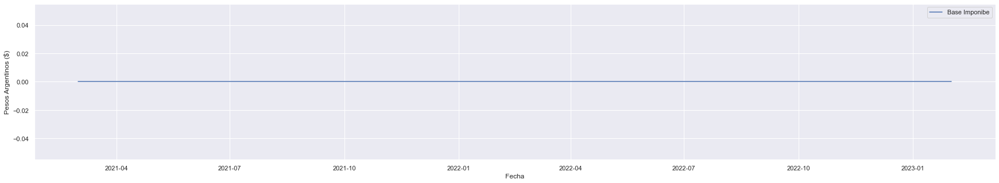

30-62546584-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


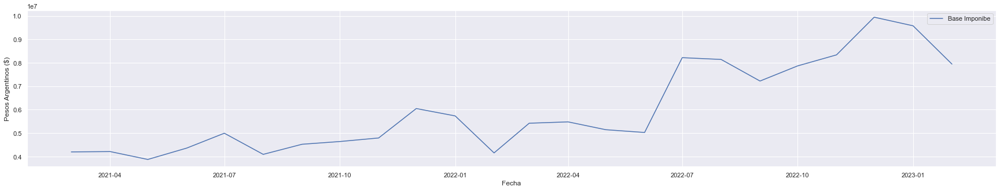

30-71756761-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


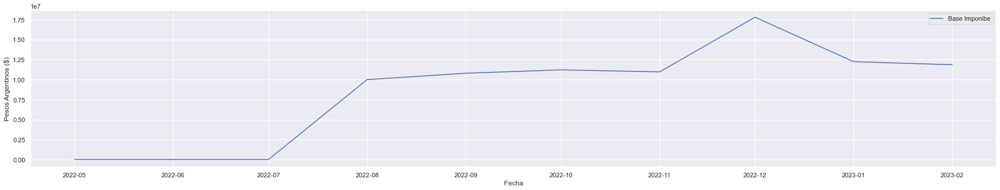

20-95089399-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


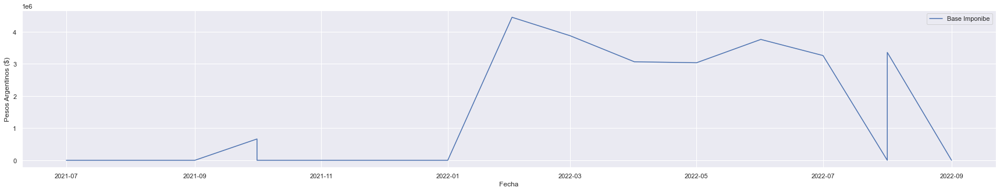

20-95751075-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


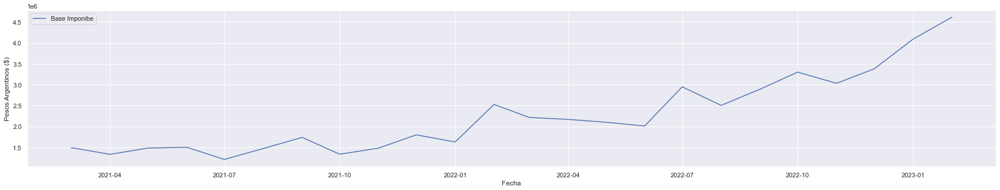

20-95750667-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


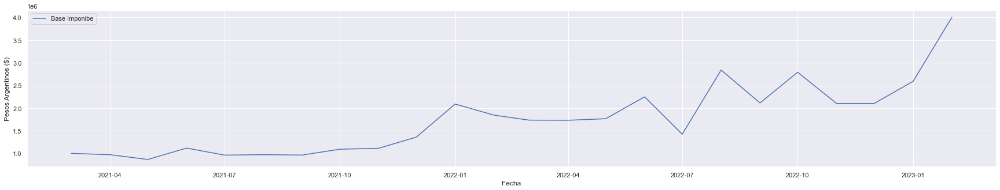

23-96005744-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


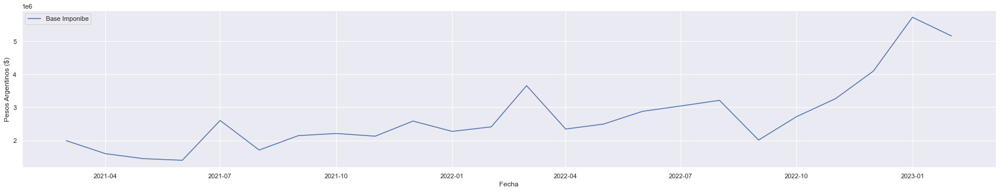

30-71616195-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


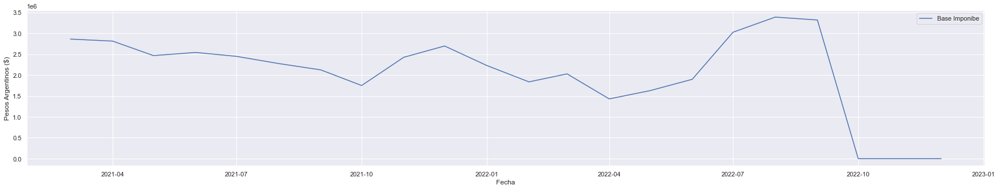

27-94206786-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


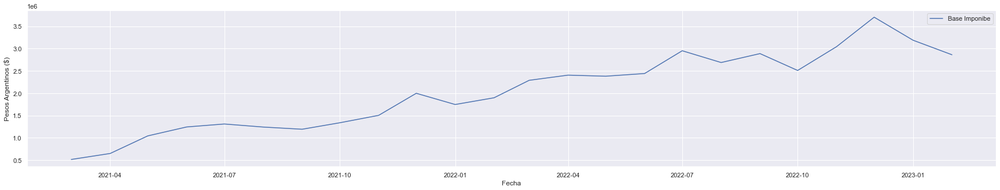

30-66834676-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


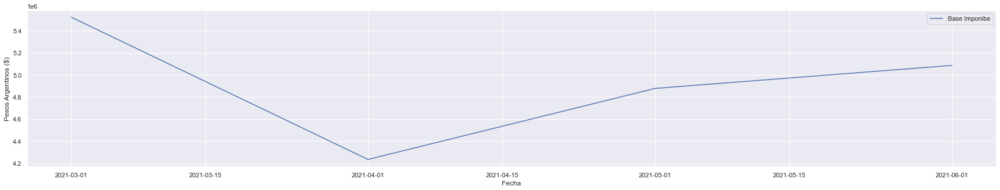

27-94451222-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


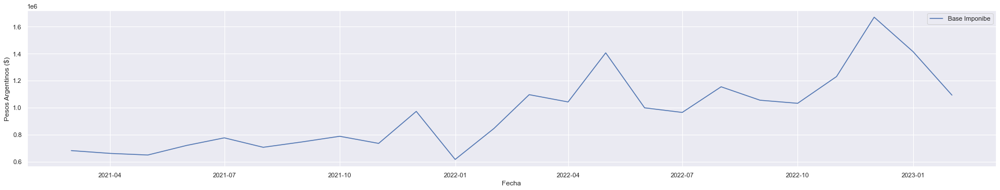

30-71563437-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


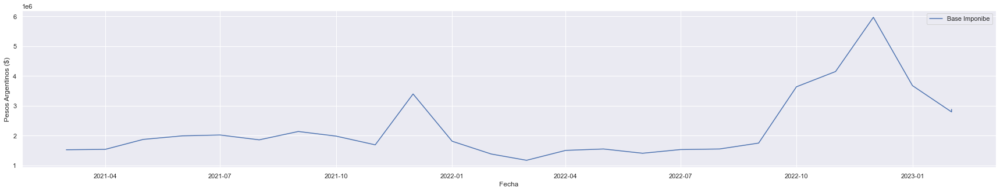

20-94206778-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


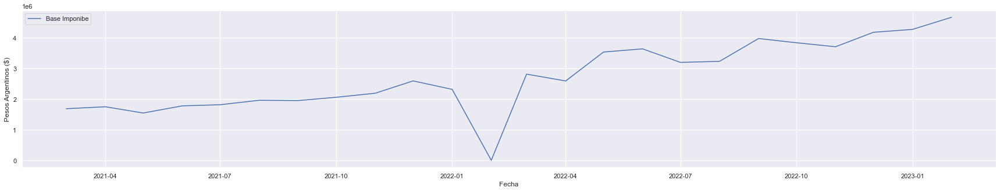

20-30782246-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


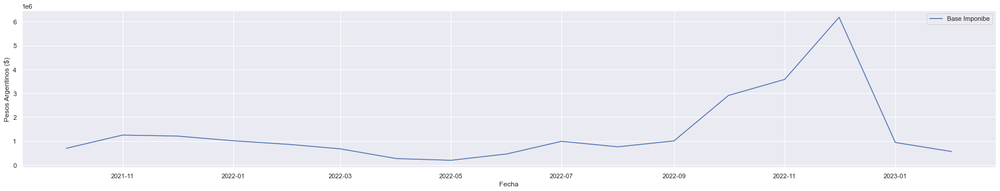

30-70023491-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


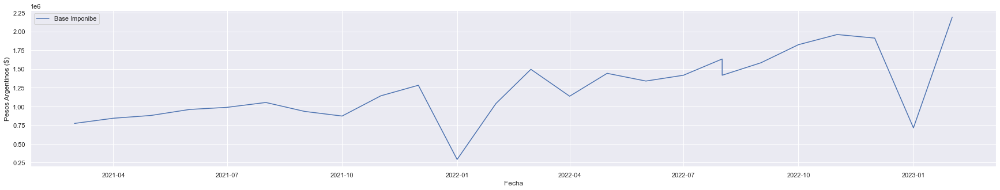

30-70943338-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


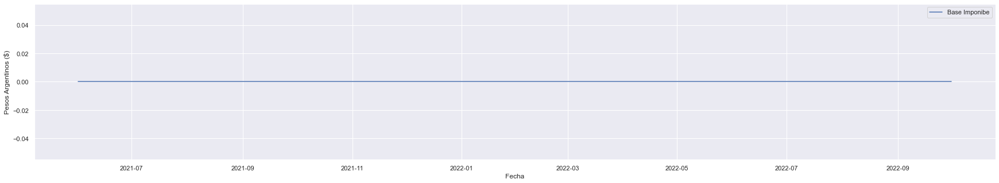

33-70843354-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


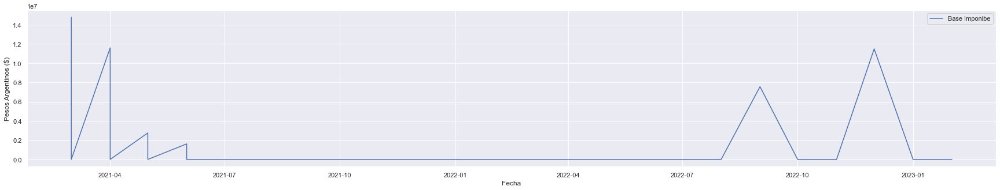

30-71404302-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


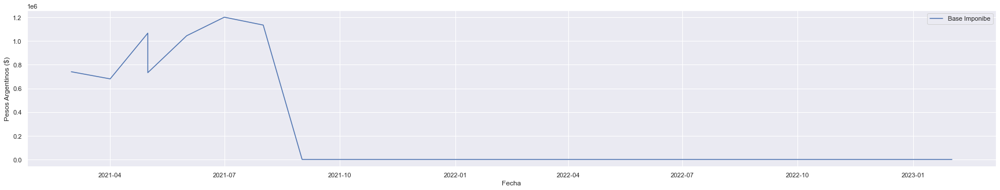

20-95964423-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


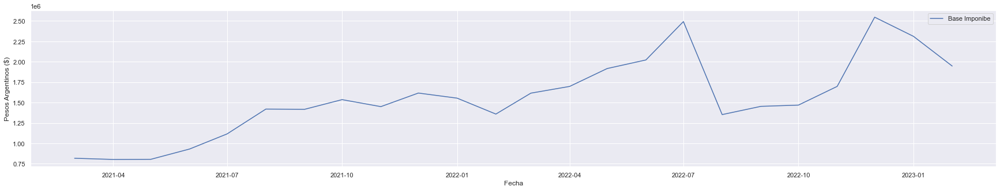

33-50233216-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


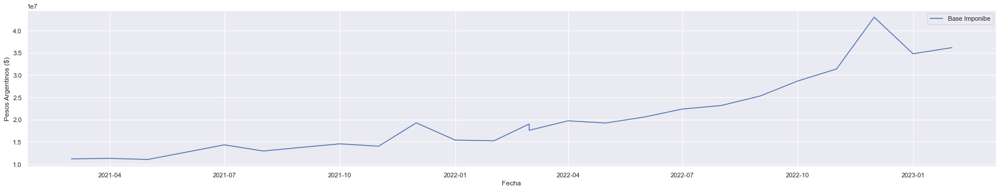

20-94041475-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


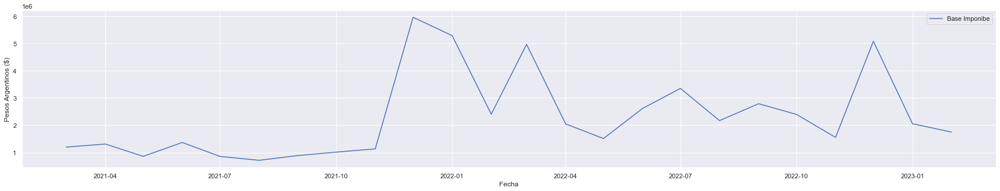

30-71645483-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


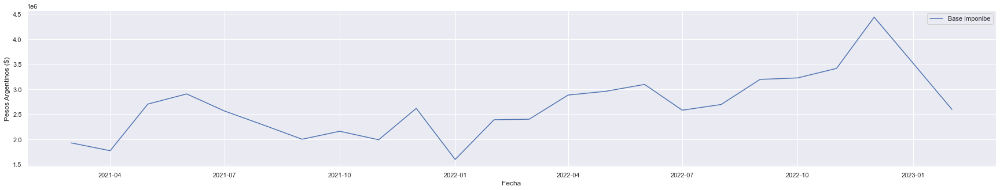

20-06696387-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


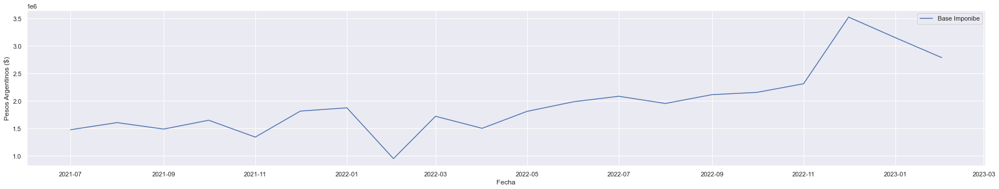

20-95370967-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


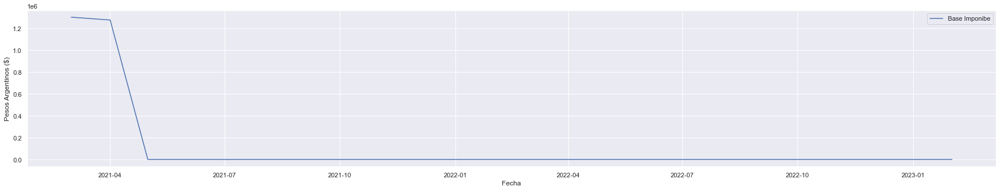

20-14265902-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


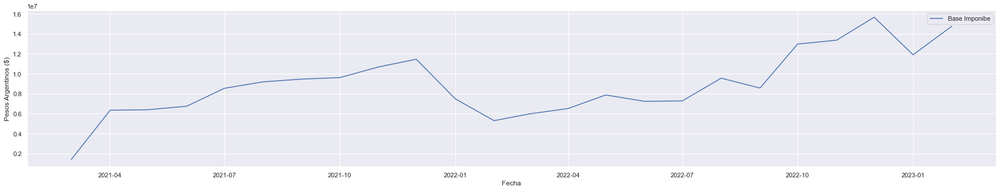

30-71155631-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


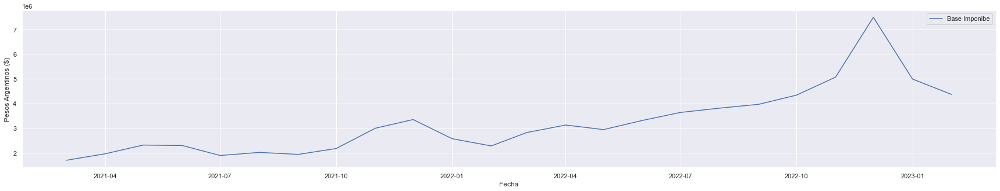

27-22769308-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


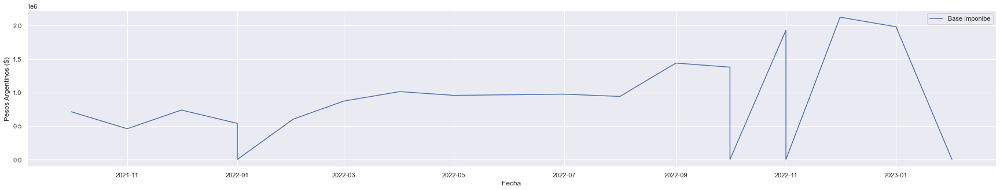

20-95407522-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


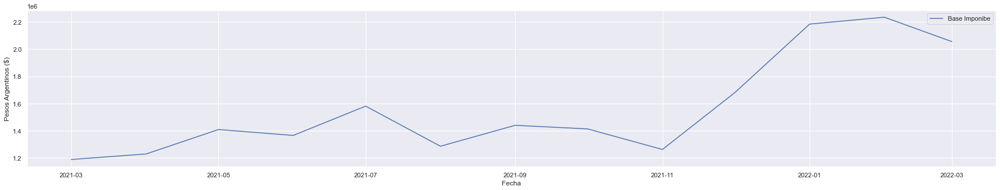

20-18190046-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


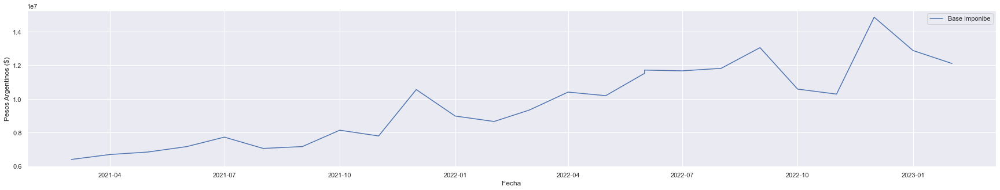

30-71109839-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


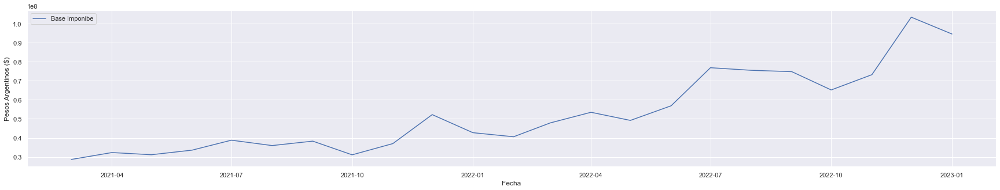

27-26808795-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


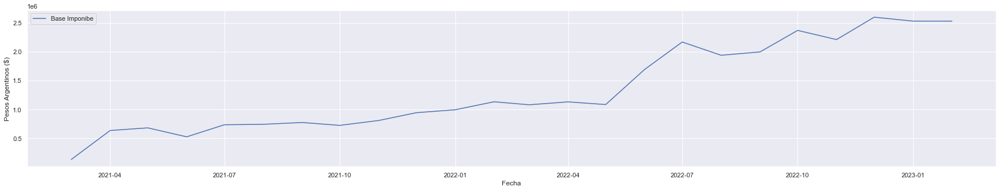

27-35171411-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


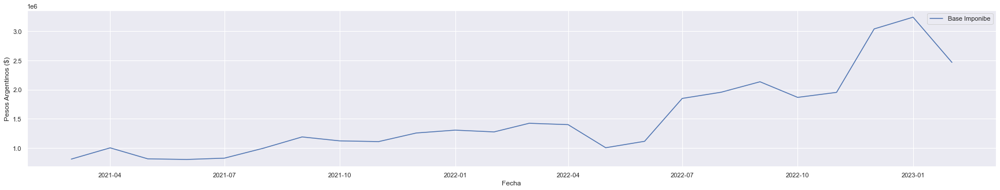

20-95570021-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


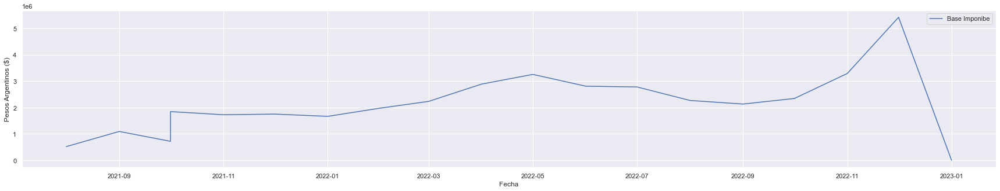

27-23422569-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


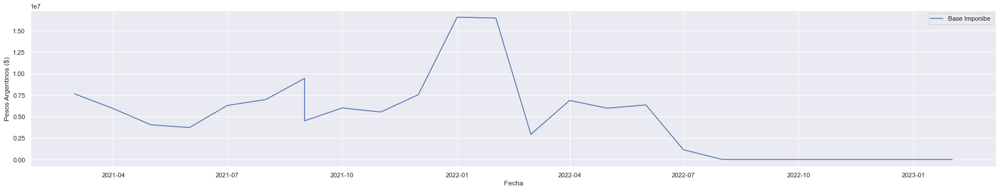

27-94741187-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


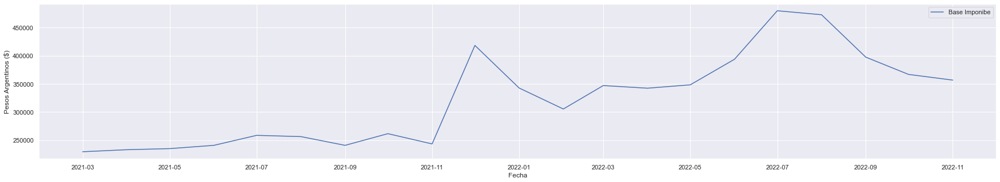

20-35588193-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


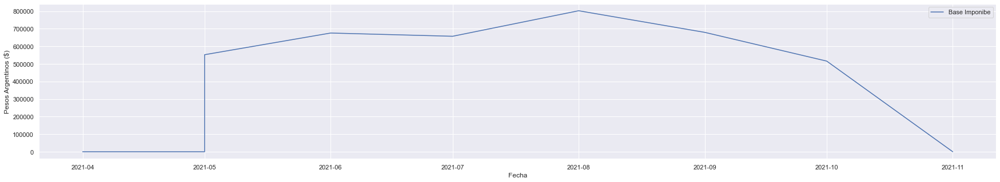

20-26546849-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


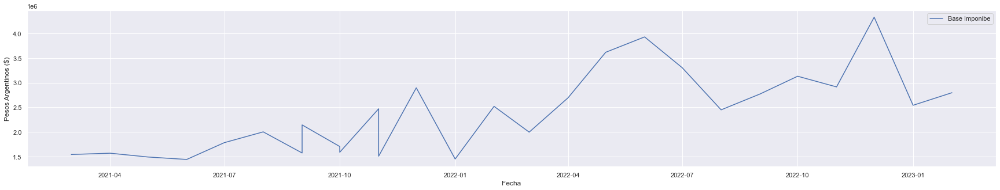

20-16432107-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


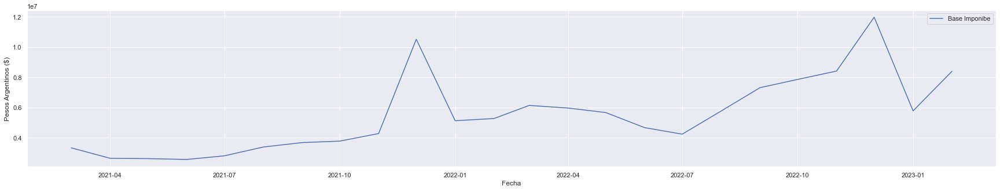

27-22040046-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


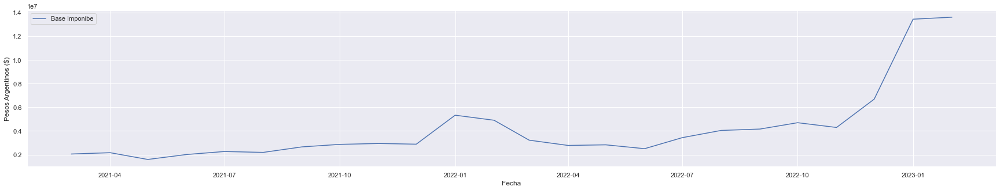

30-71695976-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


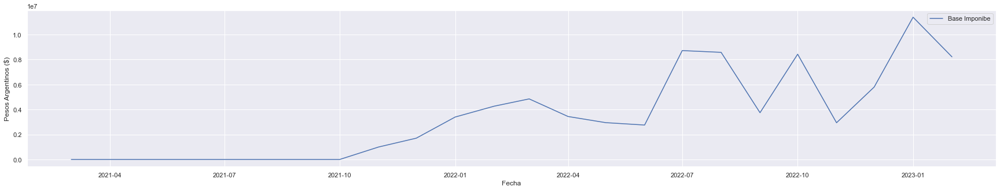

27-11470185-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


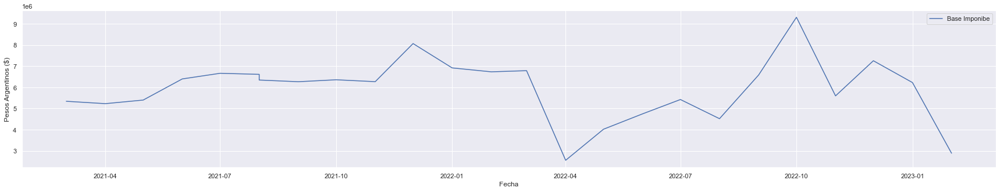

20-22773254-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


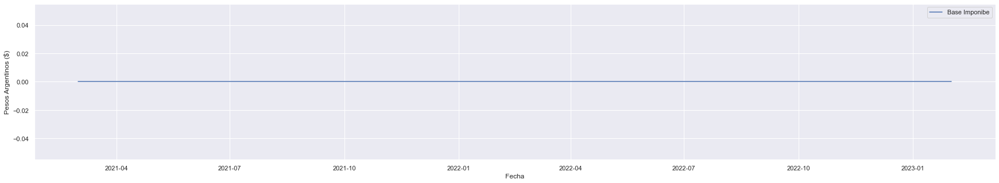

27-31405678-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


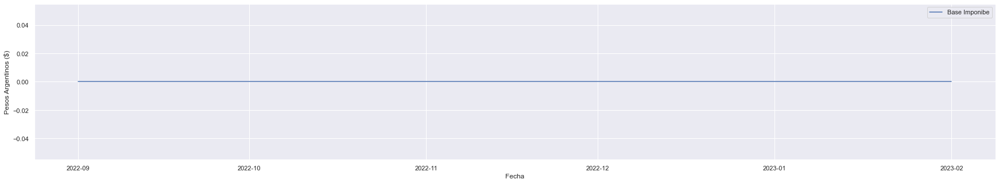

30-71154864-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


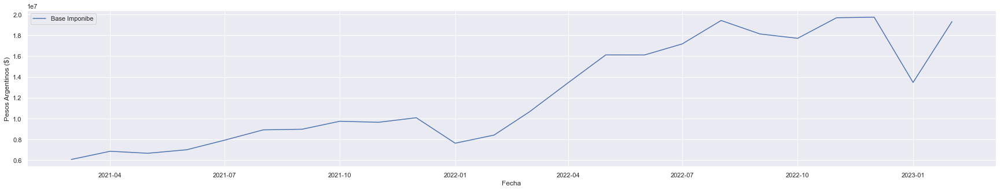

30-71041436-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


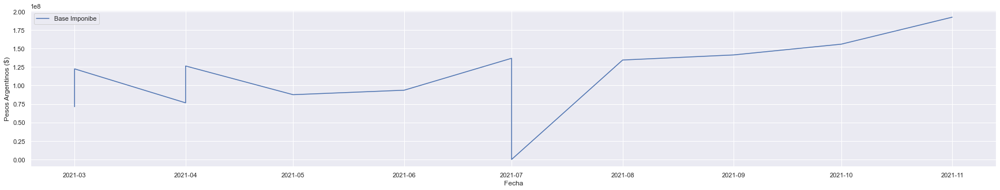

27-94107550-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


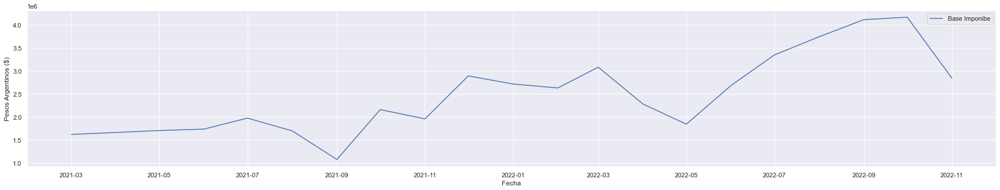

20-16575272-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


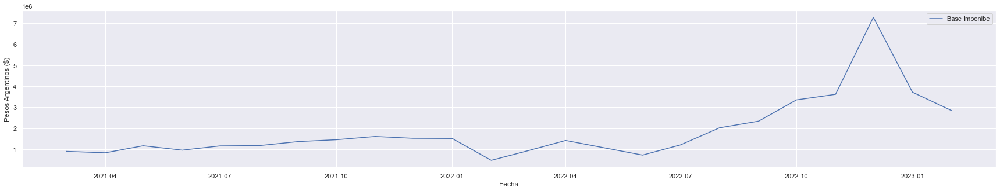

30-71608885-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


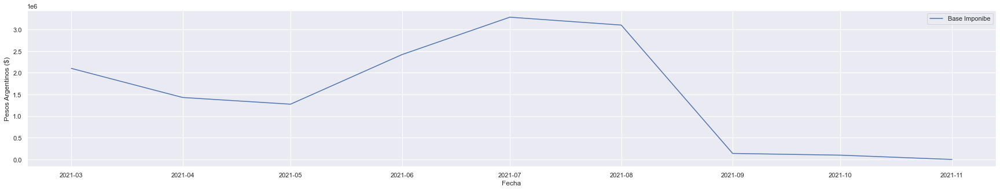

33-71131926-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


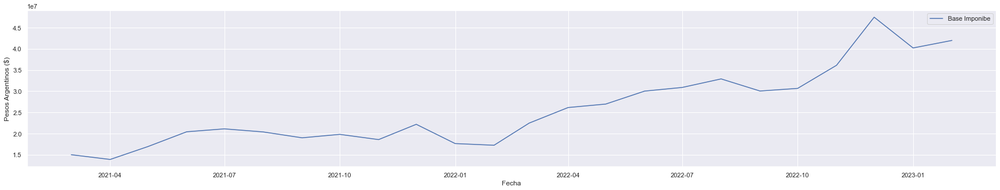

30-71662743-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


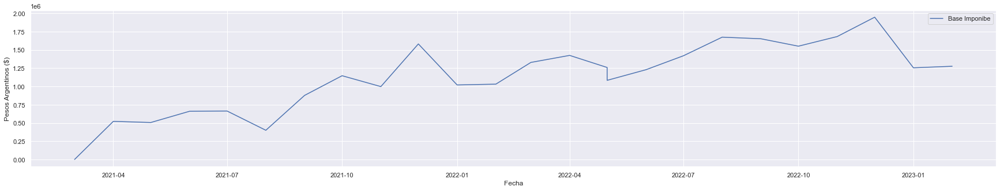

30-71206874-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


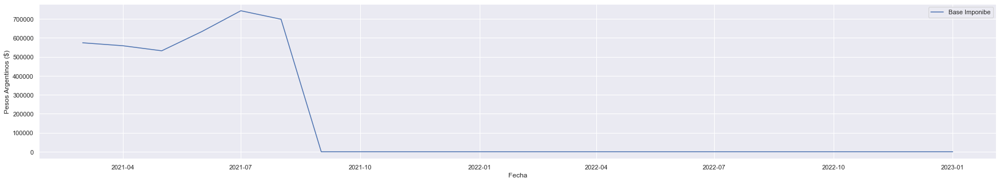

20-96145377-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


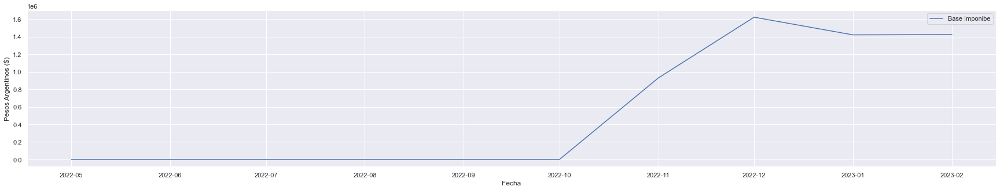

23-95621425-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


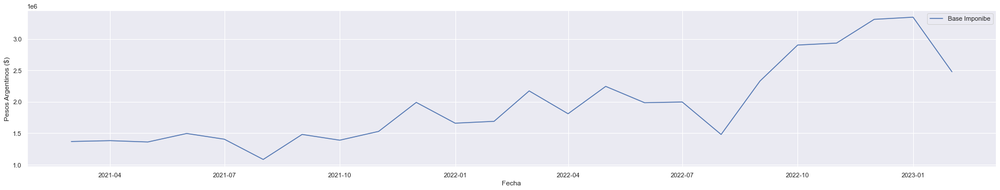

27-94811261-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


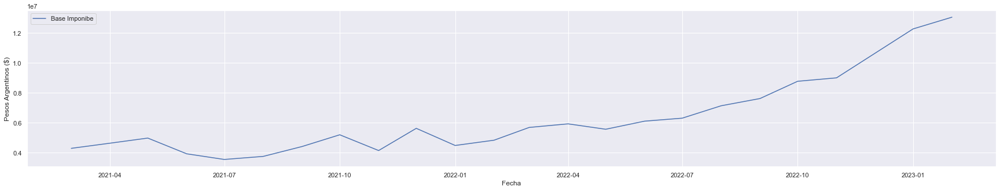

20-94165536-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


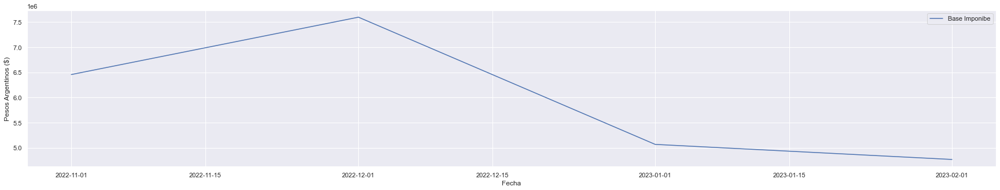

30-70776119-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


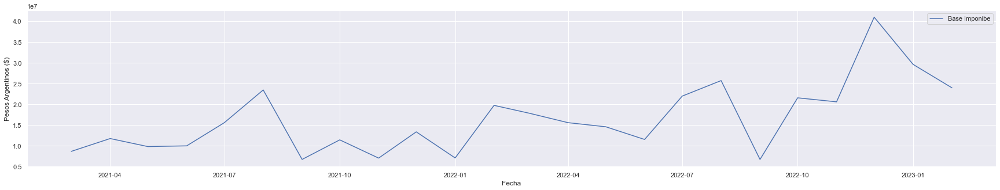

27-03216619-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


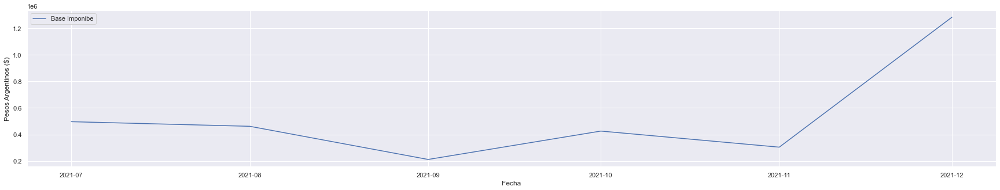

20-31022206-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


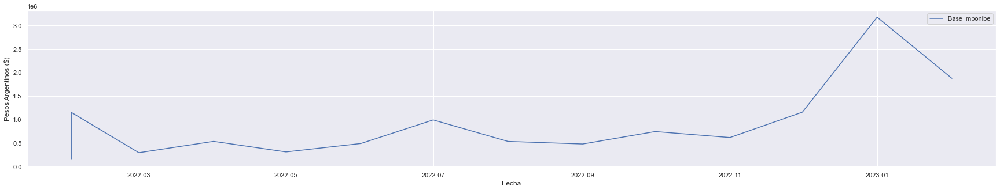

20-94011946-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


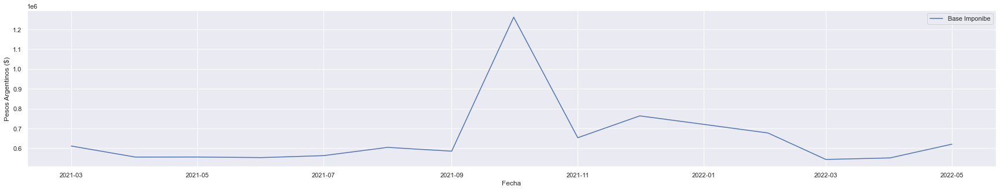

20-95496994-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


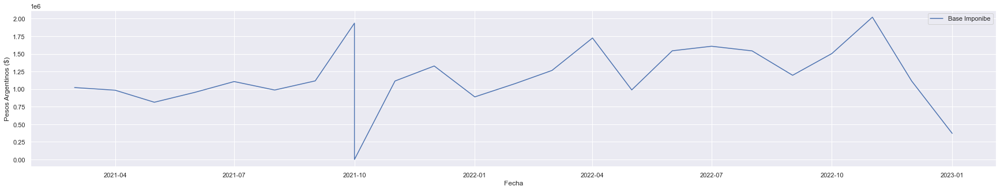

20-95168194-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


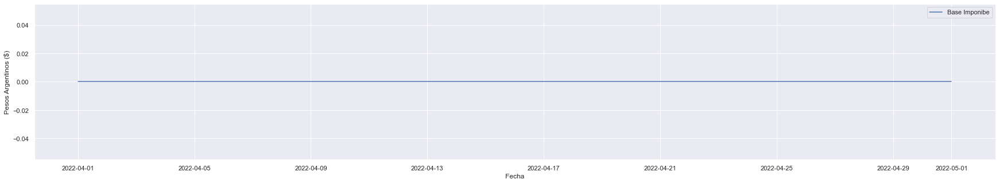

20-21402455-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


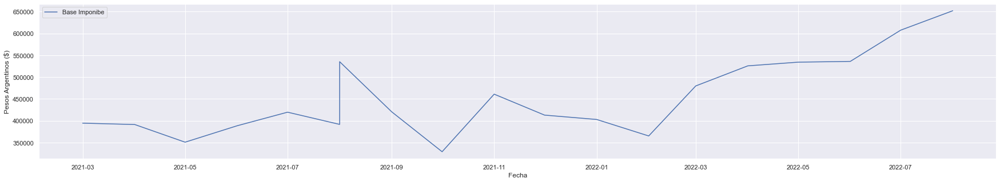

20-34416957-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


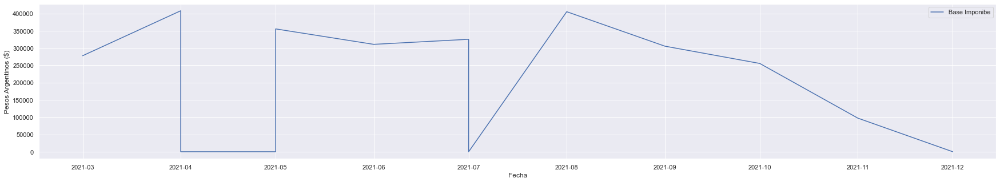

30-70944309-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


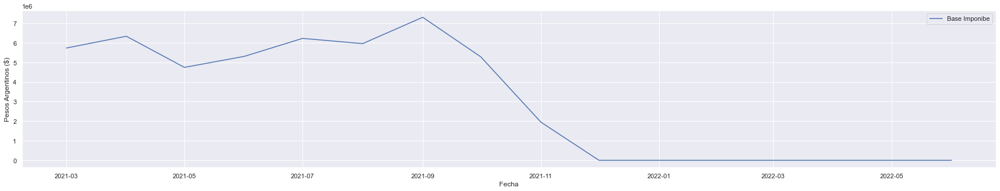

20-13963032-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


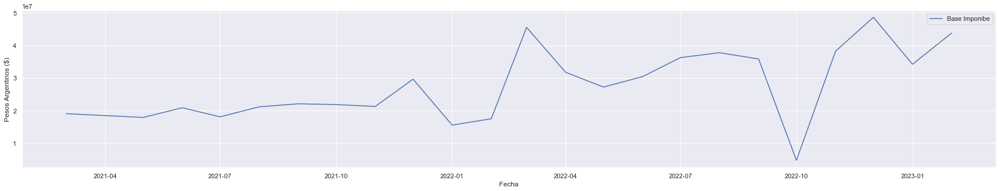

27-95637140-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


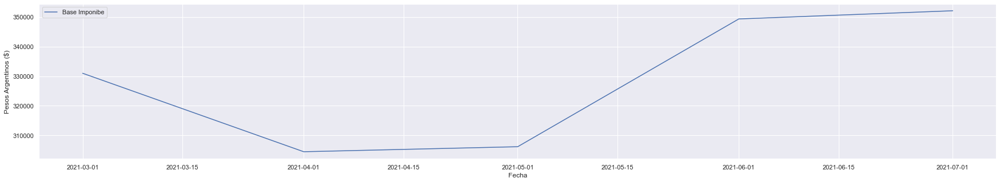

27-95196386-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


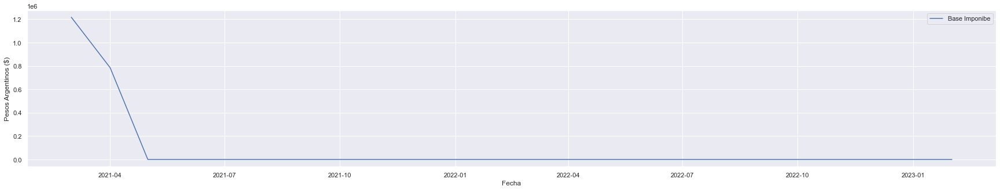

30-71559093-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


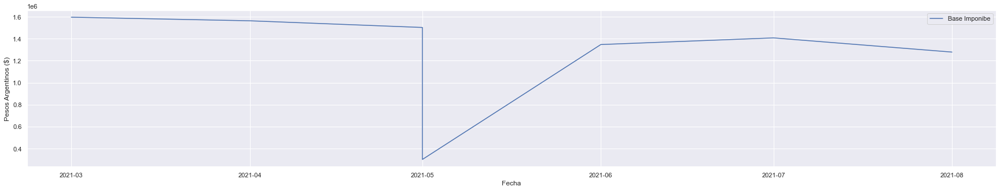

20-23293519-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


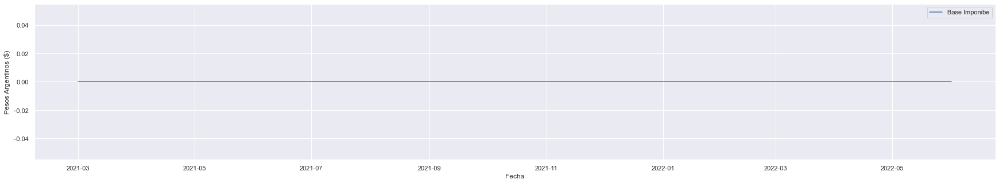

30-71761708-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


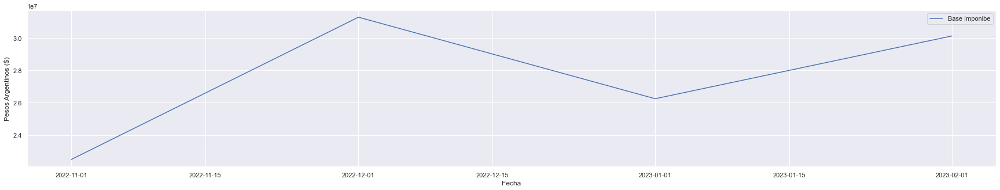

20-95884585-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


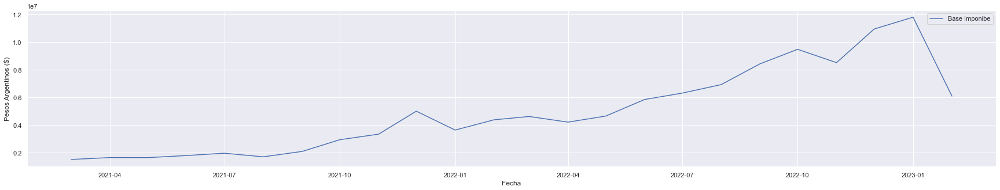

30-71695787-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


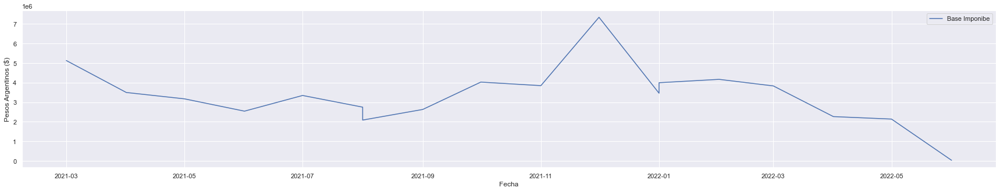

20-22465336-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


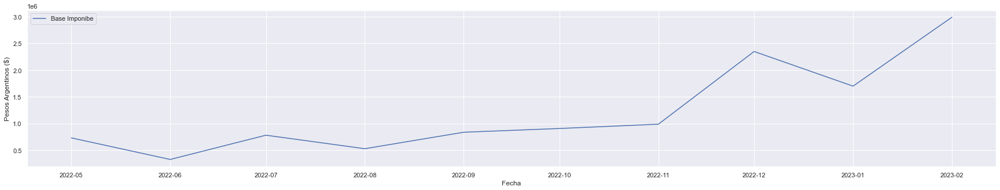

30-71669105-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


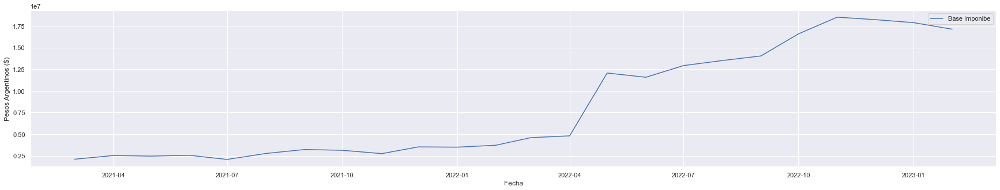

33-71617426-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


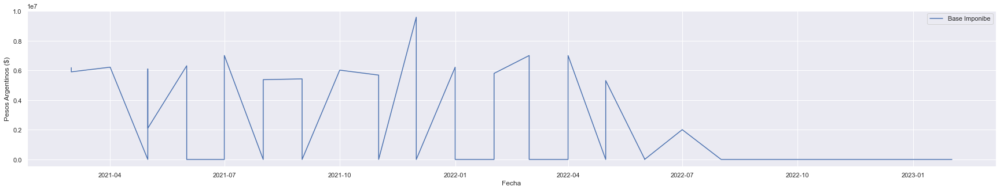

20-11559104-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


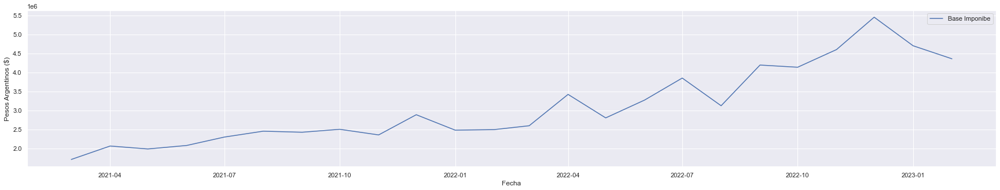

20-95324892-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


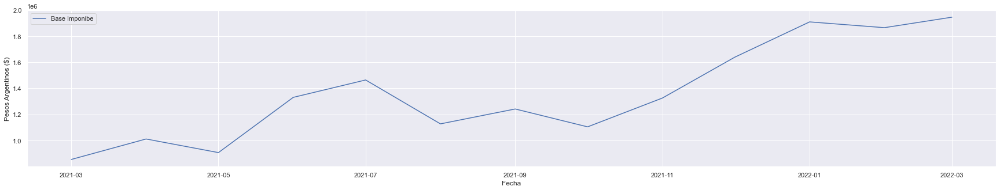

30-71243851-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


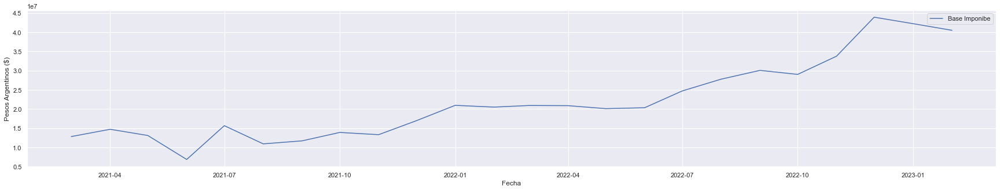

27-94882867-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


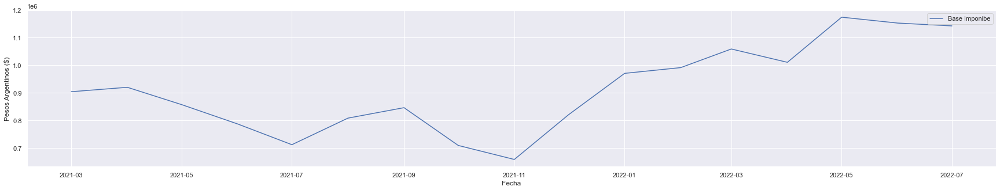

27-94015784-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


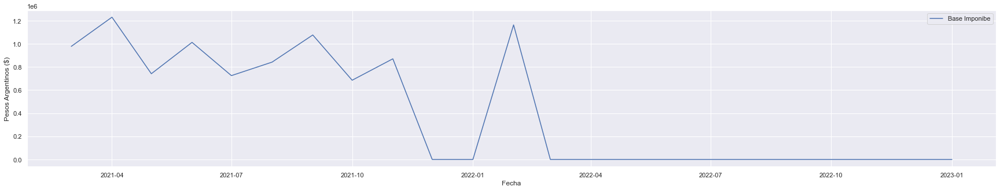

20-37286121-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


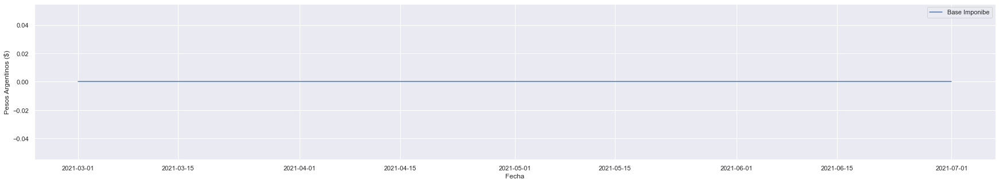

20-35141979-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


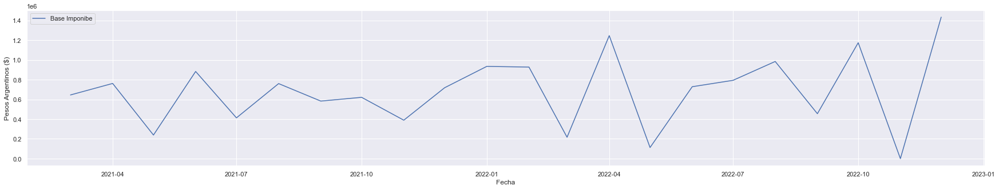

30-71785859-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


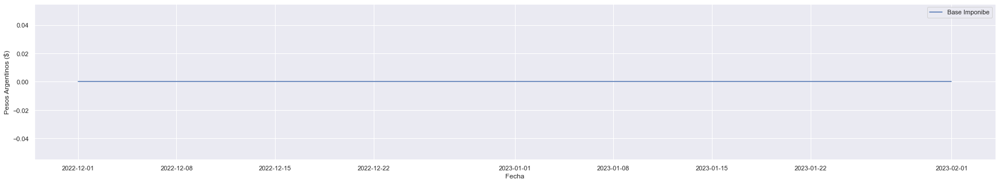

23-95343579-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


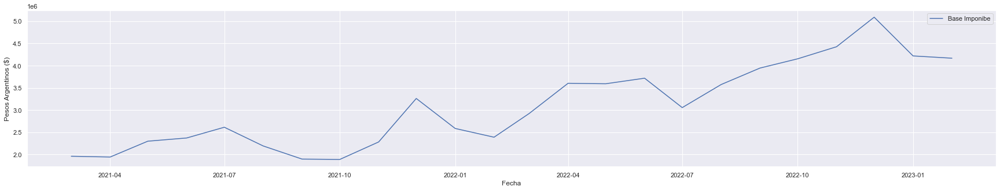

20-94794635-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


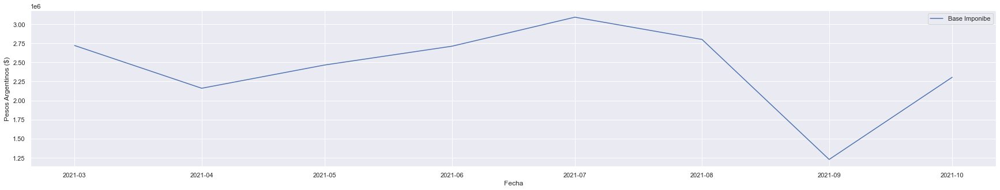

27-94781303-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


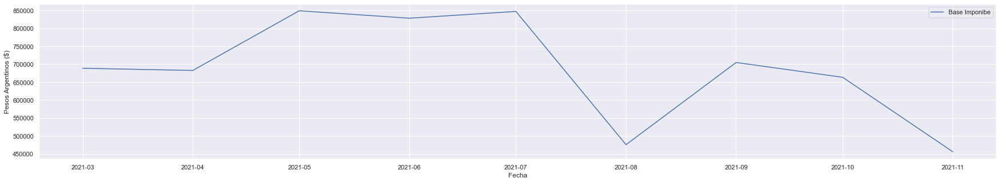

33-71133398-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


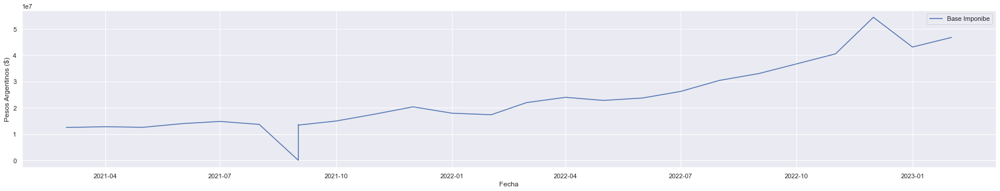

27-94627267-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


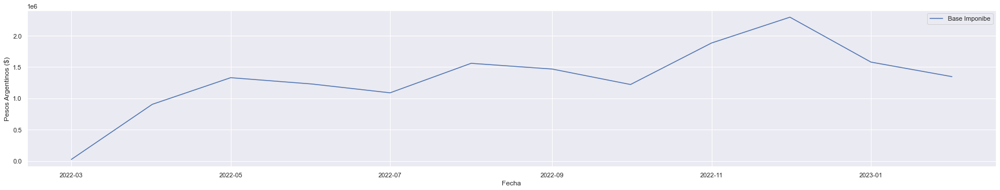

27-27880332-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


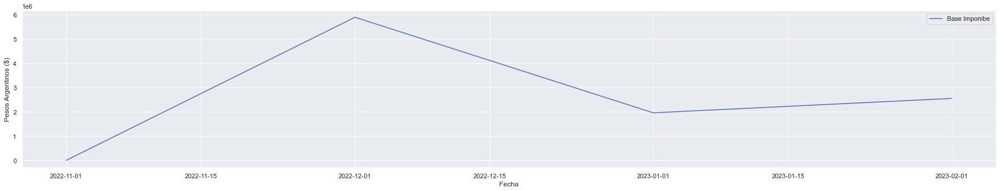

27-94018090-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


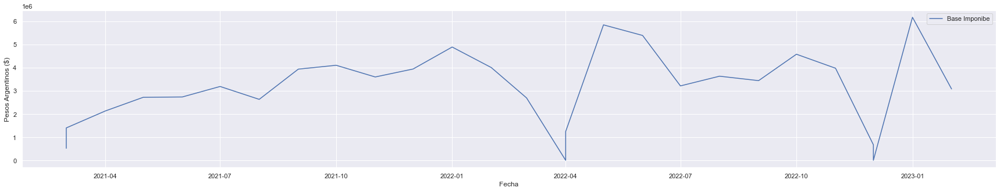

30-71728277-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


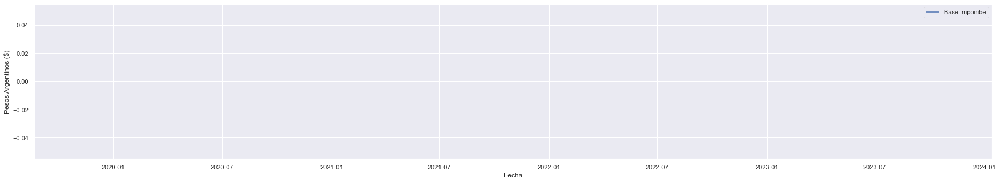

30-71729730-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


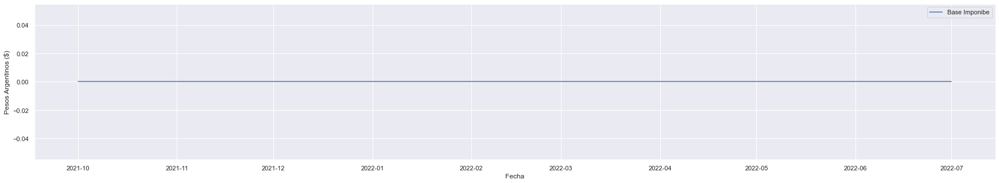

20-94739123-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


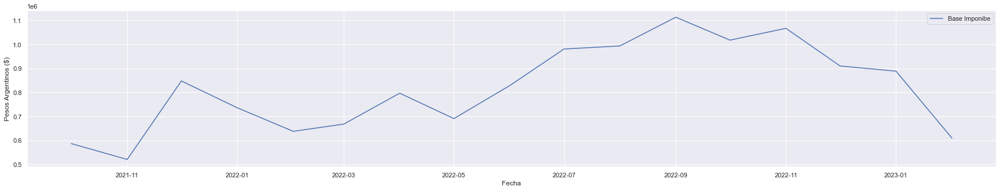

27-95242721-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


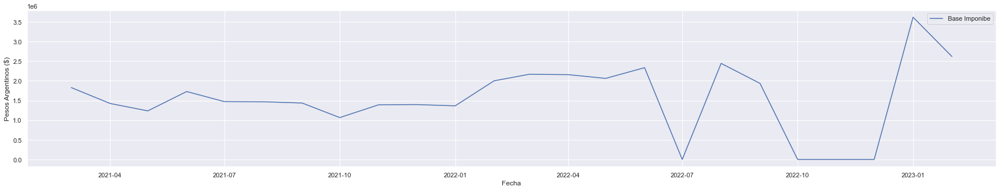

30-71763239-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


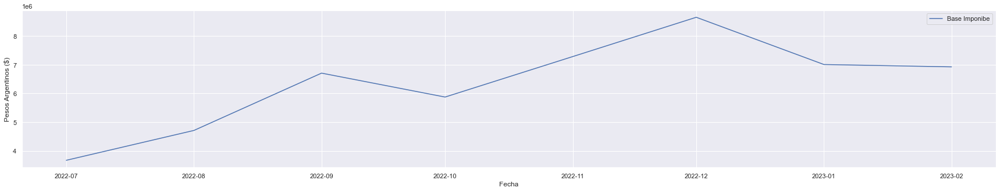

23-08401357-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


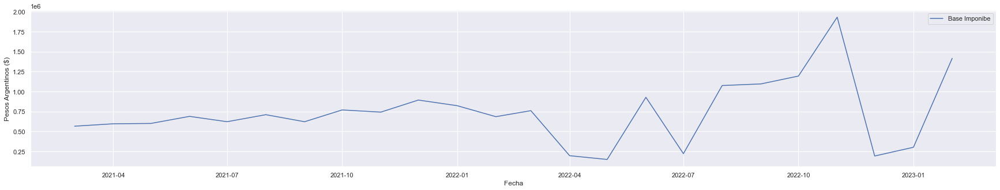

33-71633402-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


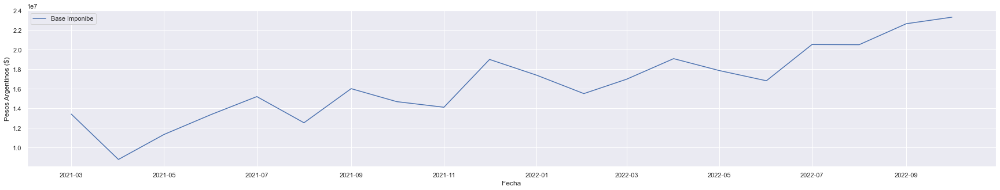

20-95720244-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


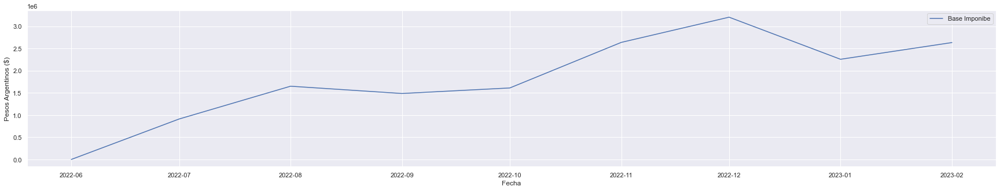

30-71715563-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


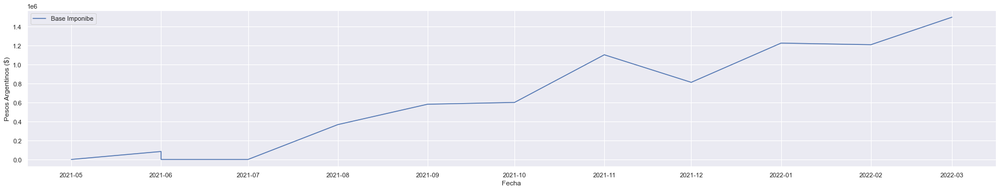

27-94182247-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


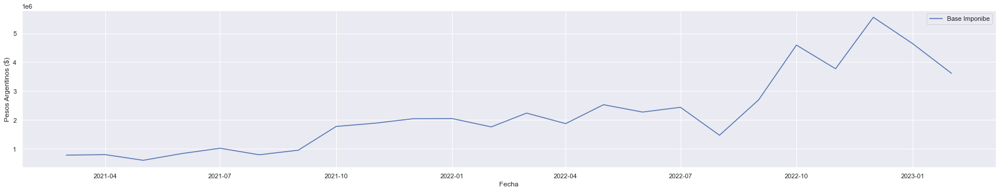

30-71509270-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


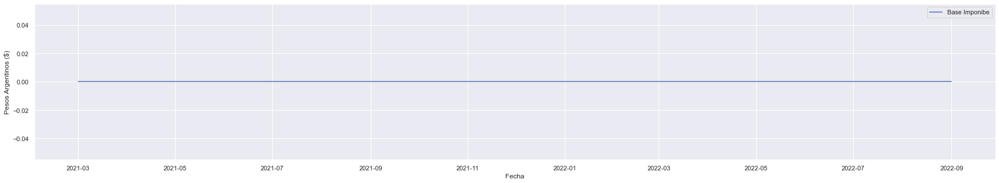

27-31097784-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


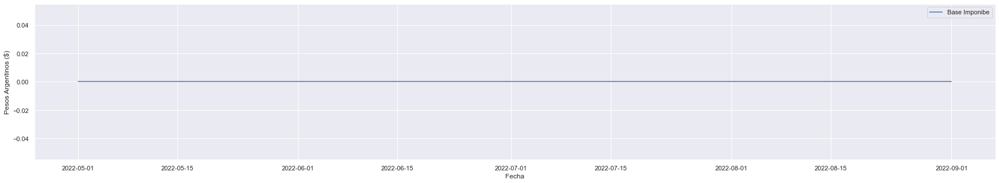

27-96075330-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


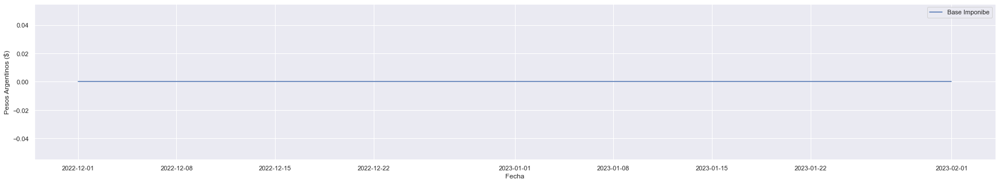

20-28506235-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


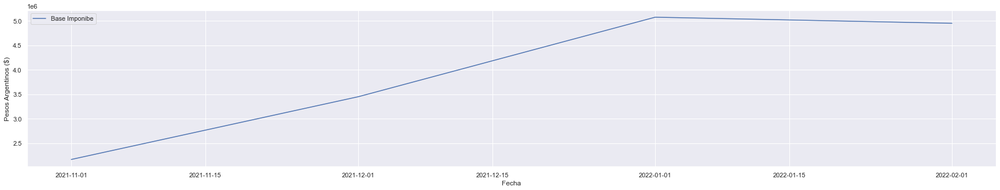

30-71708758-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


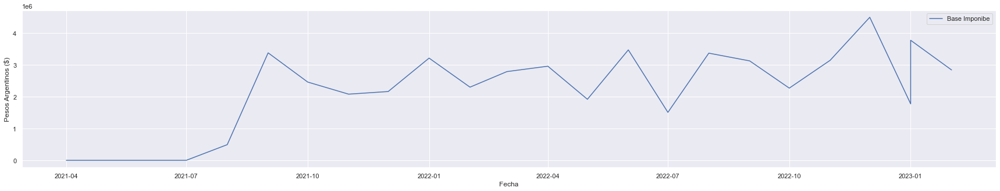

27-95771960-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


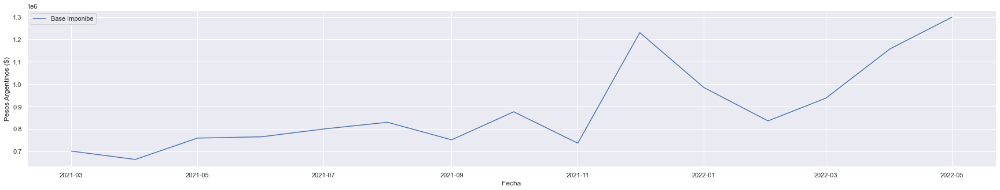

20-94460311-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


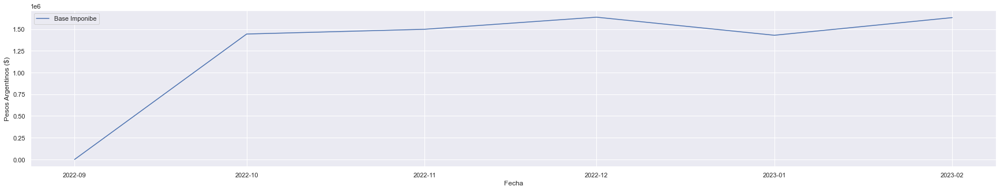

27-95724918-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


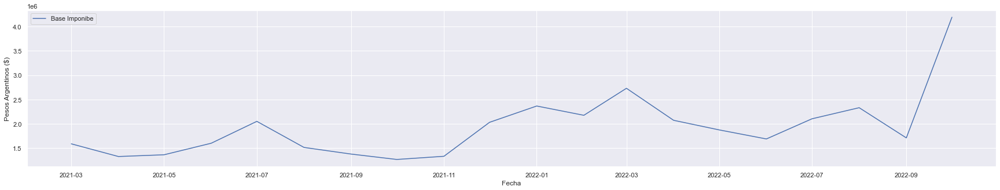

30-71782691-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


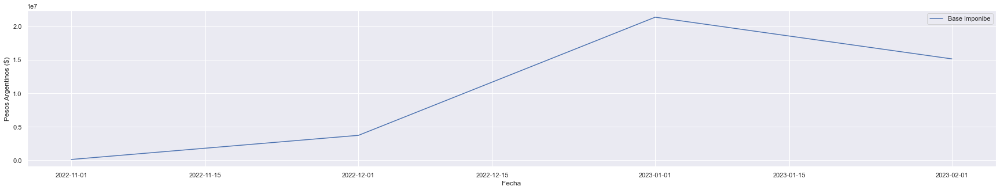

20-94107548-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


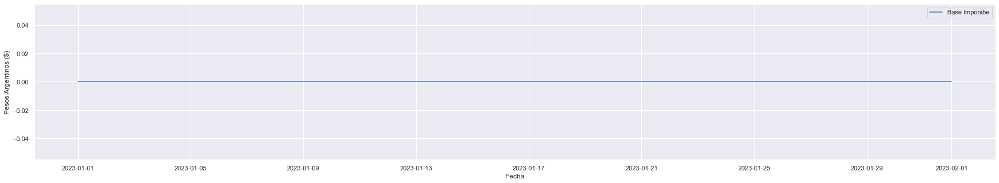

30-71648525-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


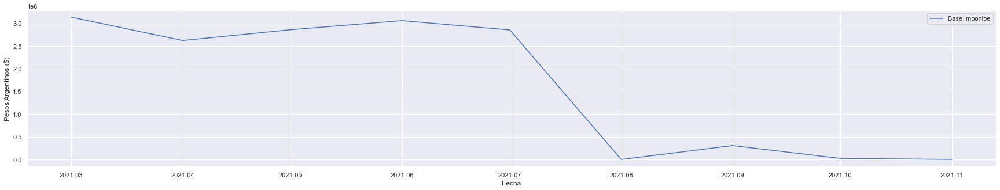

20-94597476-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


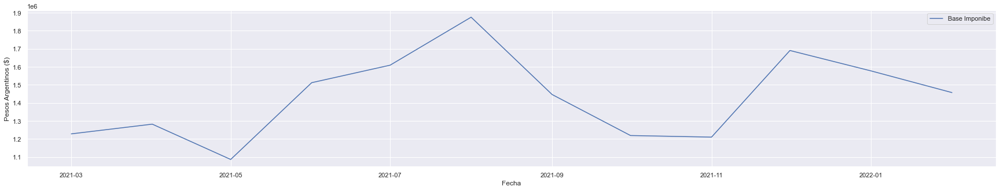

30-71463398-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


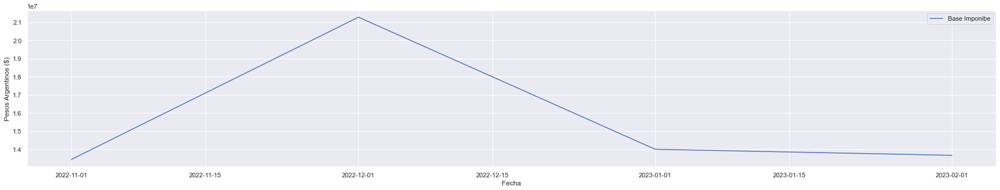

20-94307486-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


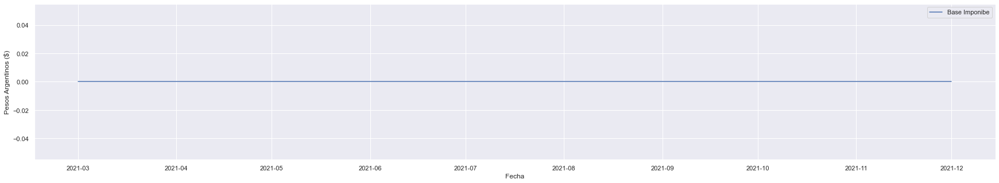

30-71049251-0


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


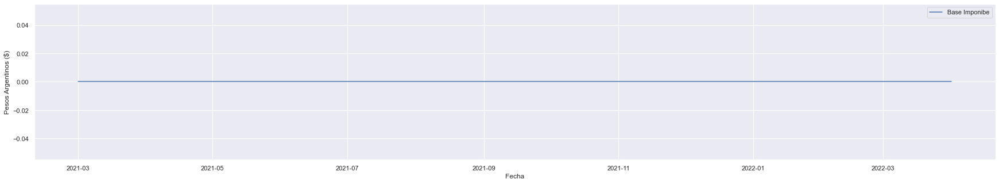

20-95540356-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


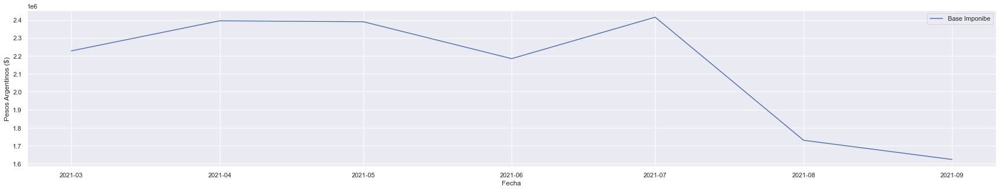

20-33535697-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


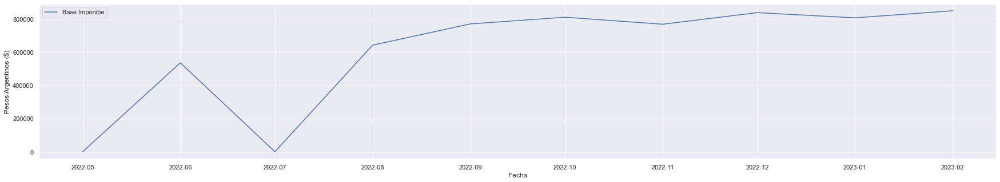

27-17948196-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


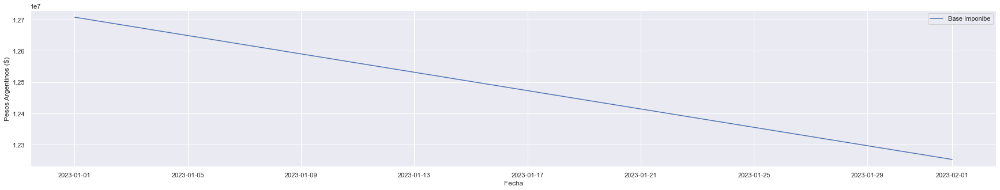

20-29372300-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


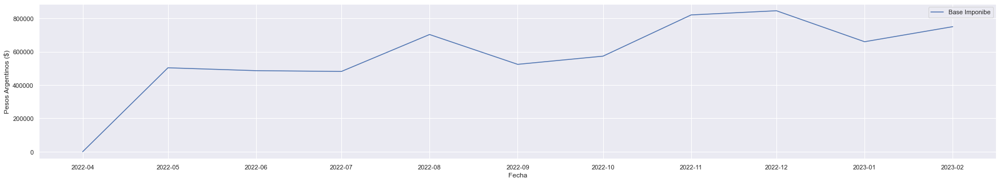

20-22507811-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


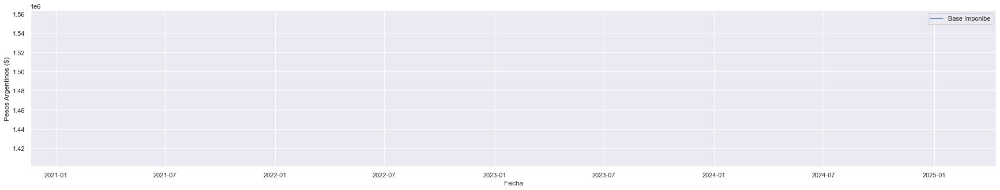

23-36274061-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


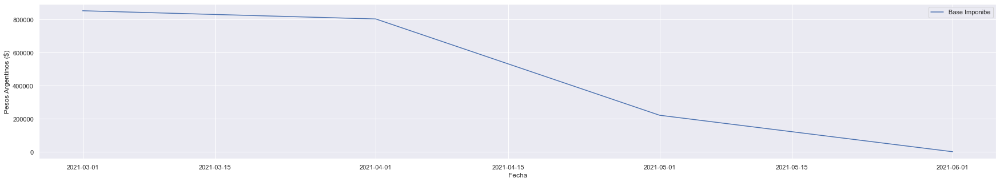

30-71769211-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


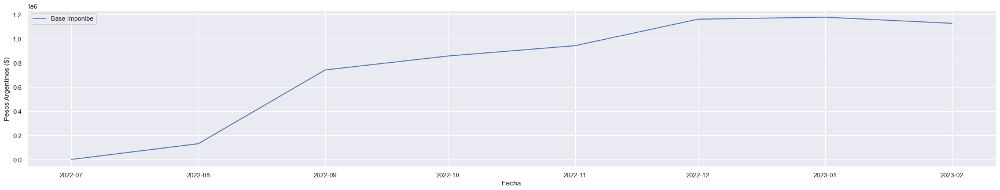

30-59304955-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


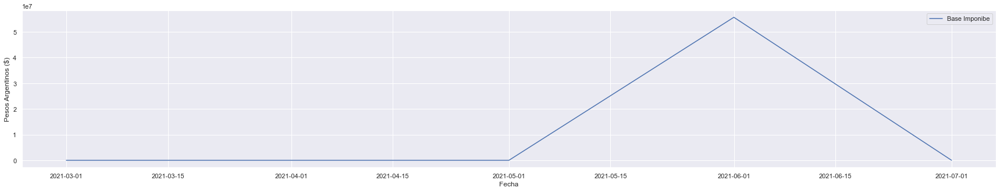

30-66818829-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


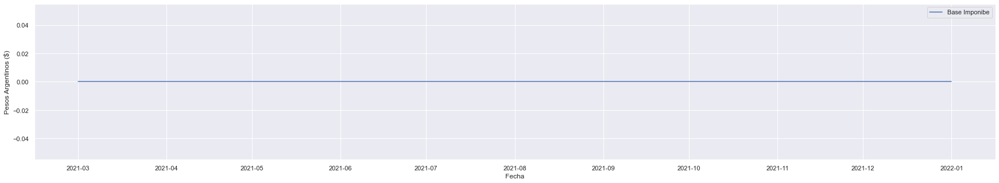

20-96077659-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


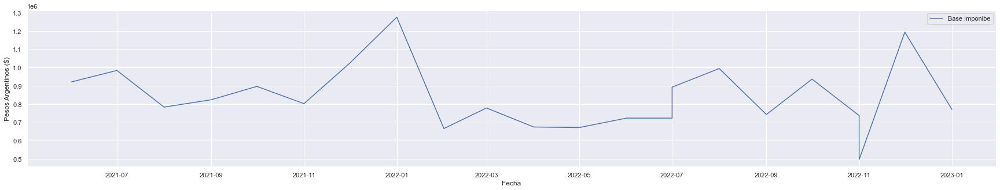

20-95682386-3


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


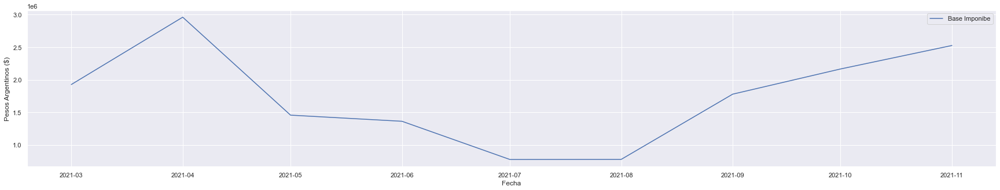

20-96124340-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


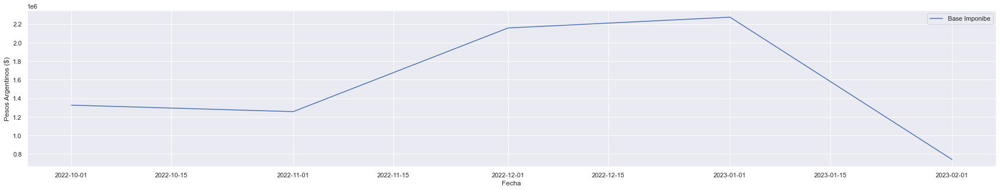

30-71713395-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


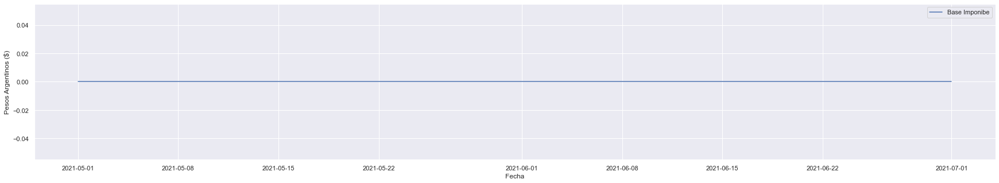

20-30315701-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


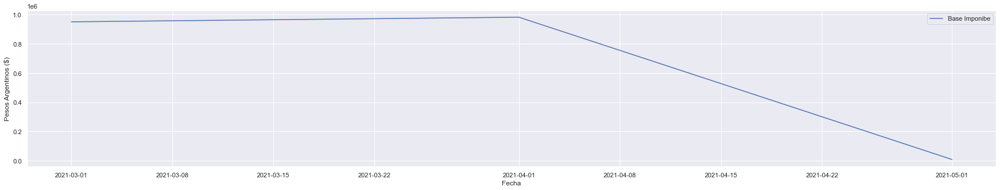

27-21898252-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


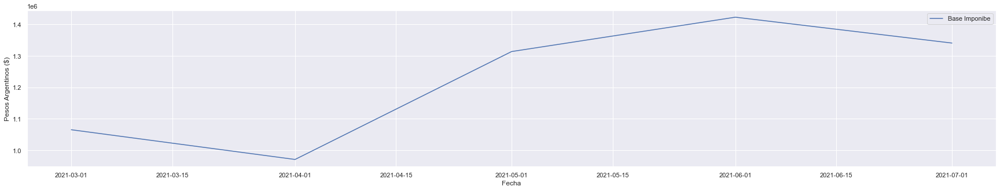

30-71042417-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


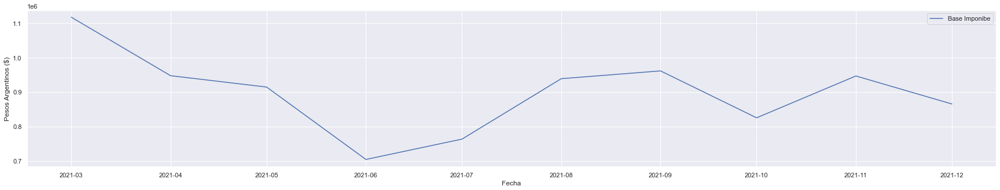

20-26654193-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


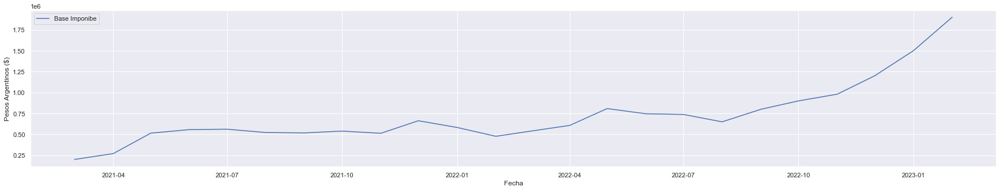

27-16249972-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


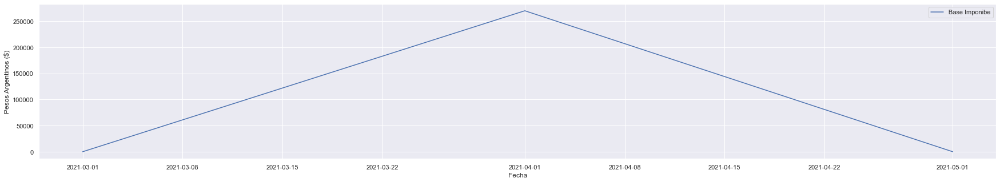

20-40297154-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


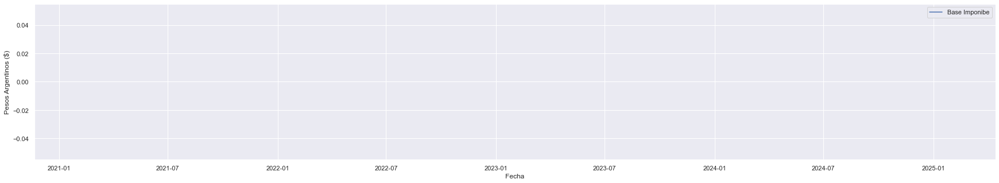

30-71783480-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


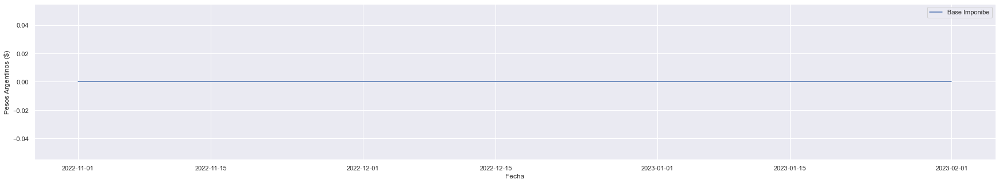

23-96104113-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


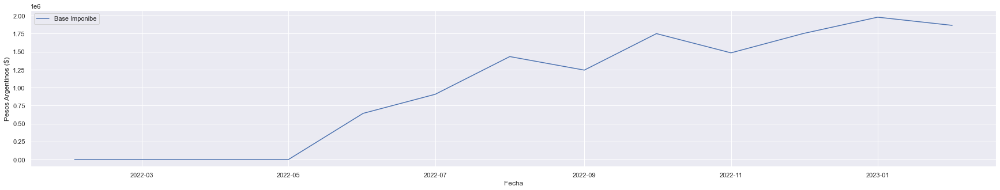

27-96145744-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


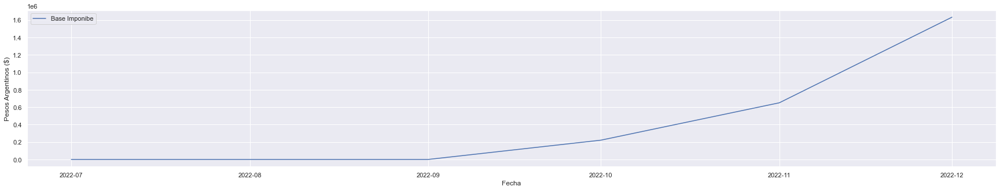

27-12382036-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


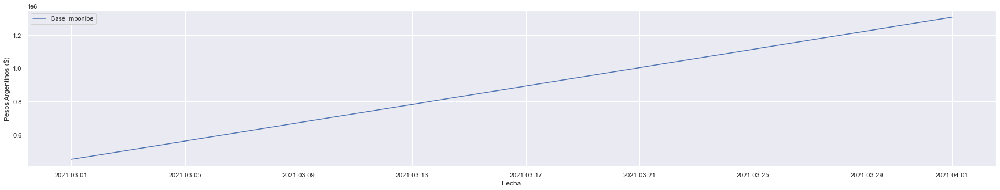

23-32307680-4


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


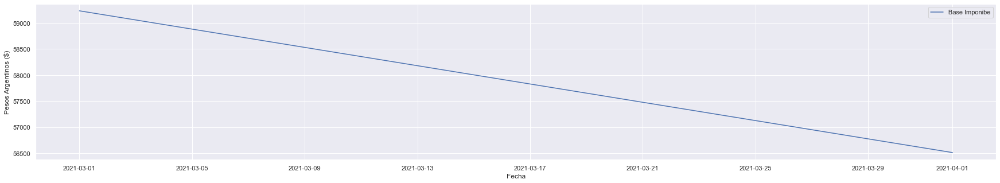

20-40505123-1


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


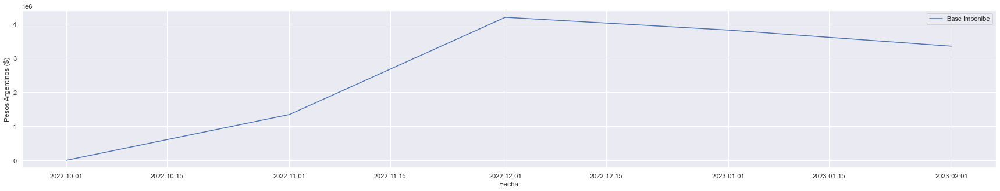

30-71554905-7


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


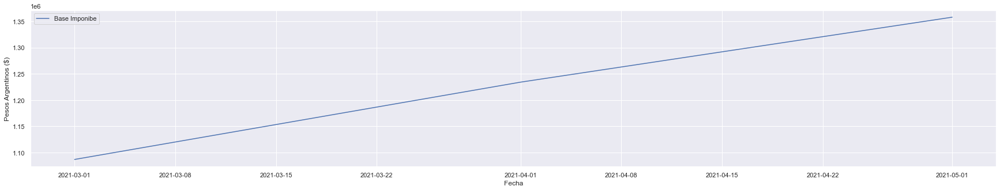

27-94165729-5


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


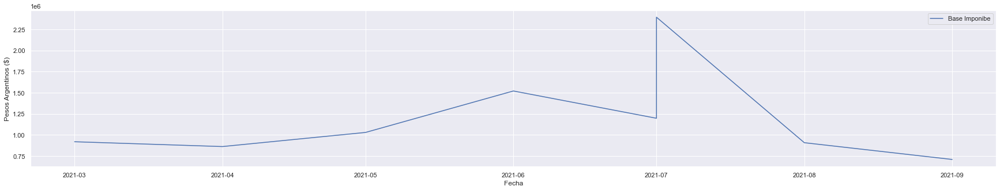

20-95662826-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


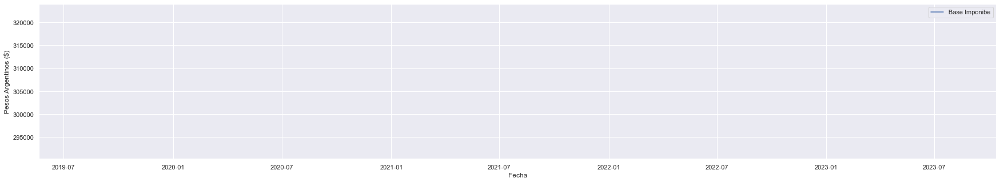

20-94211233-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


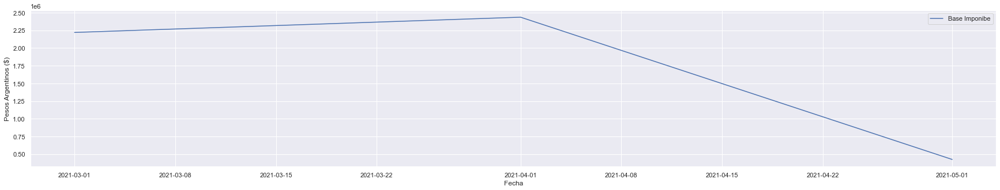

30-71212278-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


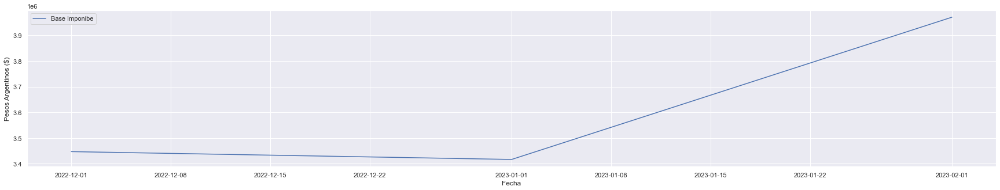

27-96152546-8


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


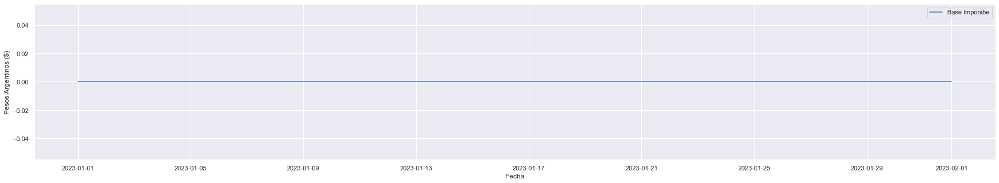

30-71693852-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


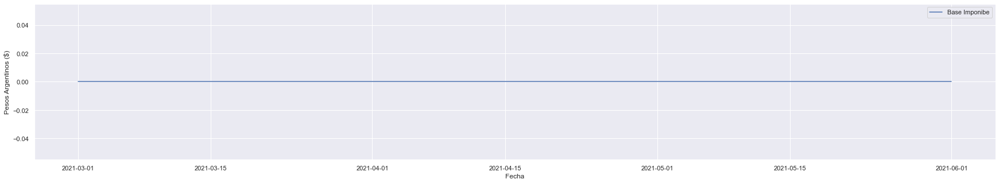

30-71783299-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


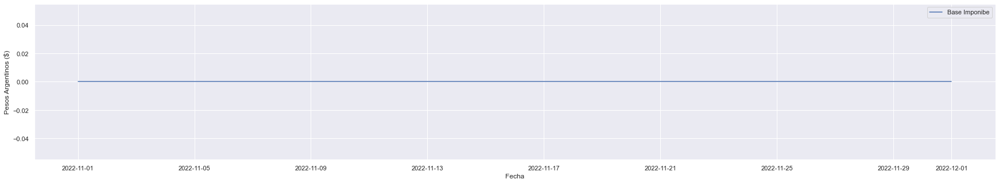

20-11813829-6


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


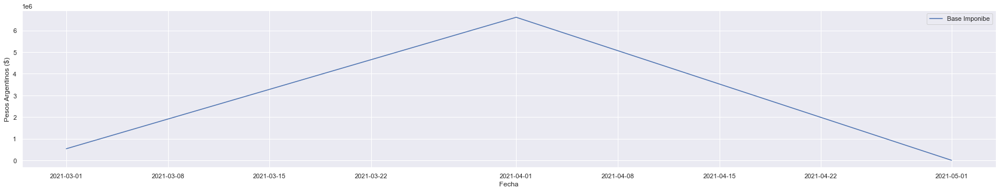

27-30480186-2


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


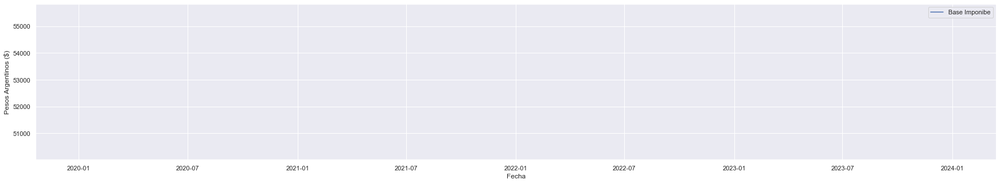

23-39694225-9


<ipython-input-273-5886cf2e1b7d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])


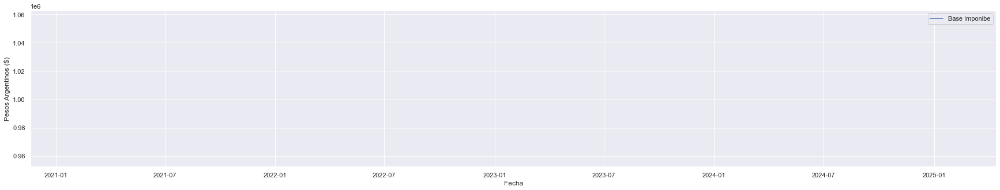

In [273]:
for i in cuits.tolist(): 
    cuit =i
    print(i)
    filtro = data24['CUIT_CG'] == cuit
    dataxcuit = data24[filtro]
    dataxcuit['FEC_PERIODO_CUOTA'] = pd.to_datetime(dataxcuit['FEC_PERIODO_CUOTA'])
    dataxcuit=dataxcuit.drop_duplicates()
    dataxcuit.sort_values(by='FEC_PERIODO_CUOTA',inplace=True) 
    dataxcuit.drop_duplicates()
    plt.figure(figsize = (30,5))
    plt.plot(dataxcuit.FEC_PERIODO_CUOTA, dataxcuit.M_BASE_IMPONIBLE, label = 'Base Imponibe')
    plt.xlabel('Fecha')
    plt.ylabel('Pesos Argentinos ($)')
    # plt.xlim(datetime.date(1990,1,1), datetime.date(2018,1,1))
    # plt.ylim(-10,40)
    plt.legend()
    plt.show()